# Note

To run this code, you'll need the following packages installed:

`pip install tqdm seaborn networkx levenshtein pomegranate==0.14.8`

### imports

In [1]:
import itertools
import pickle
from collections import defaultdict
from tqdm import tqdm_notebook as tqdm

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors

import pomegranate
from IPython.display import display

from utils import *

### visualize samples from running avg model

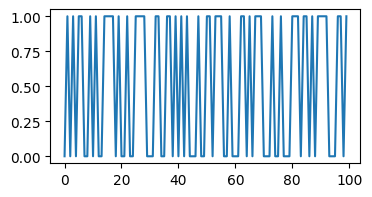

In [2]:
plt.rcParams['figure.figsize'] = (4, 2)

y = WindowAvgModel(goal_p=.5, window_size=10).sample(100)
plt.plot(range(100), y)

### Colors

In [3]:
palette = sns.color_palette("bright")

palette.append((0,0,0))
for i in sns.color_palette("Paired"):
    palette.append(i)
#palette

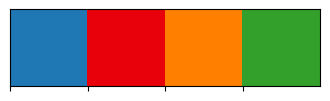

In [4]:
c_gpt = palette[12]
c_gt = palette[3]
c_bern = palette[18]
c_mc = palette[14]

sns.palplot([c_gpt, c_gt, c_bern, c_mc])

In [5]:
sns.color_palette("rocket")

[(0.20973515, 0.09747934, 0.24238489),
 (0.43860848, 0.12177004, 0.34119475),
 (0.67824099, 0.09192342, 0.3504148),
 (0.8833417, 0.19830556, 0.26014181),
 (0.95381595, 0.46373781, 0.31769923),
 (0.96516917, 0.70776351, 0.5606593)]

### Load openai data from file

#### Load random flip generation data

In [6]:
llm_fit_res = pd.read_csv('data/openai/gen_fit_res.csv')              # formerly llm_fit_res5.csv
llm_sub_res = pickle.load(open('data/openai/gen_sub_res.pk', 'rb'))   # llm_sub_res5.pk

##### Generate dataframe

In [7]:
# add simulated flips to loaded flips data
rows = []
for goal_p in set(llm_fit_res['goal_p']):
    flip_sims = simulate_bernoulli(200, 50, goal_p).astype(int)                # bernoulli simulated flips
    gzip_agg = len(gzip_compress([f for flips in flip_sims for f in flips]))   # compress all strings concatenated together
    rows += [make_flips_row(flips.tolist(), 'Bernoulli-GT', 'Bernoulli-GT', goal_p, gzip_agg=gzip_agg) for flips in flip_sims]

df2 = pd.DataFrame(rows)
df_base = pd.concat([llm_fit_res, df2])

llms_short = ['Ground Truth', 'text-davinci-003', 'gpt-3.5-turbo-0613',  'gpt-4-0613', 'gpt-3.5-turbo-instruct']
dff = df_base[df_base['llm'].isin(llms_short)]
df_ = dff[(dff['model'] == 'llm') | ((dff['model'] == 'Ground Truth') & (dff['llm'] == 'text-davinci-003'))]
df_.loc[df_['model'] == 'Ground Truth', 'llm'] = 'Ground Truth'

## Load formal language learning data

#### v1

In [8]:
# This is a subset of the concepts in `llm_trees` but in slightly different format. Ideally there would only be one of these.
res_gen_trees_all = pickle.load(open('./data/openai/res_gen_trees_all.pk', 'rb'))

#### v2

In [9]:
llm_names = ['gpt-3.5-turbo-instruct-0914', 
             'text-davinci-003', 
             'text-davinci-002', 
             'text-davinci-001', 
             'text-curie-001', 
             'text-babbage-001', 
             'text-ada-001']

out_dir = 'data/openai/gen_formal-lang'    # 11-17-2023_09-47-41

llm_tree_raw = {llm: pickle.load(open(f'{out_dir}/tree_formal_{llm}.pk', 'rb')) for llm in llm_names}

In [10]:
llm_trees = defaultdict(lambda: defaultdict(lambda: defaultdict(lambda: defaultdict(list))))
for llm, res in llm_tree_raw.items():
    for r in res:
        # del r['completion']
        concept = tuple(r['concept'])
        for x_len in r['x_len']:
            for depth in r['depth']:
                depth = depth[:-1] if depth else depth
                depth = len(depth.split(','))

                ### get only top-N probability token logprobs
                # rtp = r['choice']['logprobs']['top_logprobs']
                # r['choice']['logprobs']['top_logprobs'] = [{k: v for k, v in rtp_.items() if v in sorted(rtp_.values(), reverse=True)[:3]} for rtp_ in rtp]
                
                llm_trees[llm][concept][x_len][depth] += r  if type(r) in (list, tuple)  else [r]

### convert to DF

In [11]:
rows = []
for llm, d1 in llm_trees.items():
    if llm in ['text-ada-001']:
        continue
    for concept, d2 in d1.items():
        for x_len, res_by_depth in d2.items():
            res = [r for res_ in res_by_depth.values() for r in res_]
            for depth in range(1, 7):
                try:
                    r = {
                        'llm': llm,
                        'concept': flips_to_str(concept),
                        'x_len': x_len,
                        'depth': depth,
                        'prob': get_paths_p(res, concept, depth=depth),
                    }
                    rows.append(r)
                except IndexError:
                    pass
                
df_fl = pd.DataFrame(rows)

### randomness judgment data

In [11]:
res_jud_all = pickle.load(open('./data/openai/jud_all.pk', 'rb'))          # formerly res_gen_jud_all/2.pk
res_jud_rand = pickle.load(open('./data/openai/jud_dv3-rand.pk', 'rb'))
res_jud_long = pickle.load(open('./data/openai/jud_dv3-long.pk', 'rb'))    # res_gen_jud_dv3-long/2/3/8 

# Part 1: modeling seemingly random GPT-generated sequences

### compare LLMs across aggregate metrics

#### Probability bias

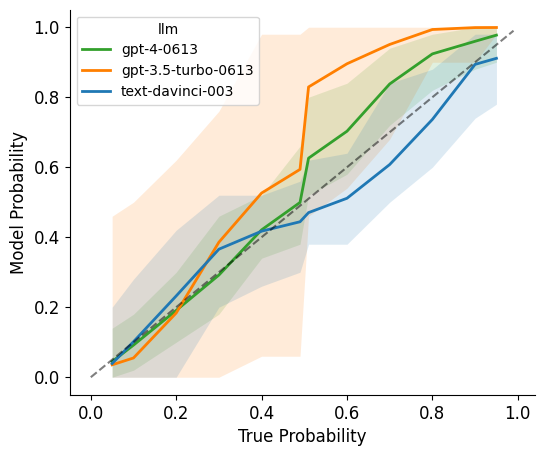

In [25]:
plt.rcParams['figure.figsize'] = (6, 5)

df__ = df_[df_.llm != 'Bernoulli'].copy()
df__ = df__[df__['goal_p'] != .5]
df__ = df__[df__['llm'] != 'Ground Truth']
df__ = df__[df__['llm'] != 'gpt-3.5-turbo-instruct']

## jitter for each LLM
#for llm in set(df__.llm):
#    df__.loc[df__.llm == llm, 'goal_p'] = df__[df__['llm'] == llm]['goal_p'] + np.random.normal(0, .10)

sns.lineplot(
    data=df__, x="goal_p", y="mean", hue="llm", 
    errorbar=("pi", 100), err_kws={'alpha': .15, 'lw': 0},
    palette=[c_mc, c_bern, c_gpt], lw=2
    #err_style="bars", err_kws={'capsize': 3}, alpha=.7,
)
xr = np.arange(0, 1, .01)
plt.plot(xr, xr, ls='--', color='black', alpha=.5)

plt.xlabel('True Probability', fontsize=12)
plt.ylabel('Model Probability', fontsize=12)
plt.gca().tick_params(axis='both', which='major', labelsize=12)

sns.despine()
# plt.savefig('imgs/fig_llms-means.pdf')
plt.show()

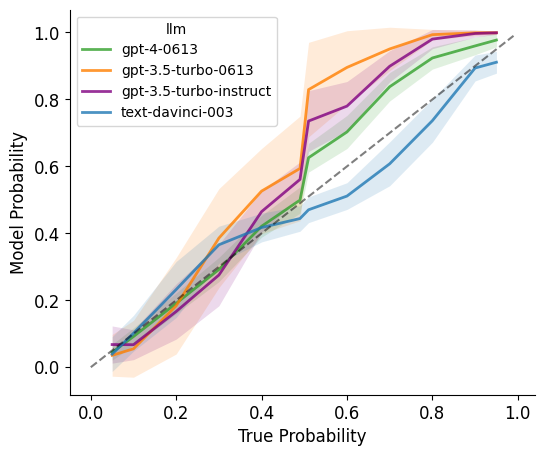

In [26]:
plt.rcParams['figure.figsize'] = (6, 5)

df__ = df_[df_.llm != 'Bernoulli'].copy()
df__ = df__[df__['goal_p'] != .5]
df__ = df__[df__['llm'] != 'Ground Truth']


sns.lineplot(
    data=df__, x="goal_p", y="mean", hue="llm", 
    errorbar=("sd", 1), err_kws={'alpha': .15, 'lw': 0},
    palette=[c_mc, c_bern, 'purple', c_gpt], lw=2, alpha=.8,
)
xr = np.arange(0, 1, .01)
plt.plot(xr, xr, ls='--', color='black', alpha=.5)


plt.xlabel('True Probability', fontsize=12)
plt.ylabel('Model Probability', fontsize=12)
plt.gca().tick_params(axis='both', which='major', labelsize=12)

sns.despine()
# plt.savefig('imgs/fig_llms-means2.pdf')
plt.show()

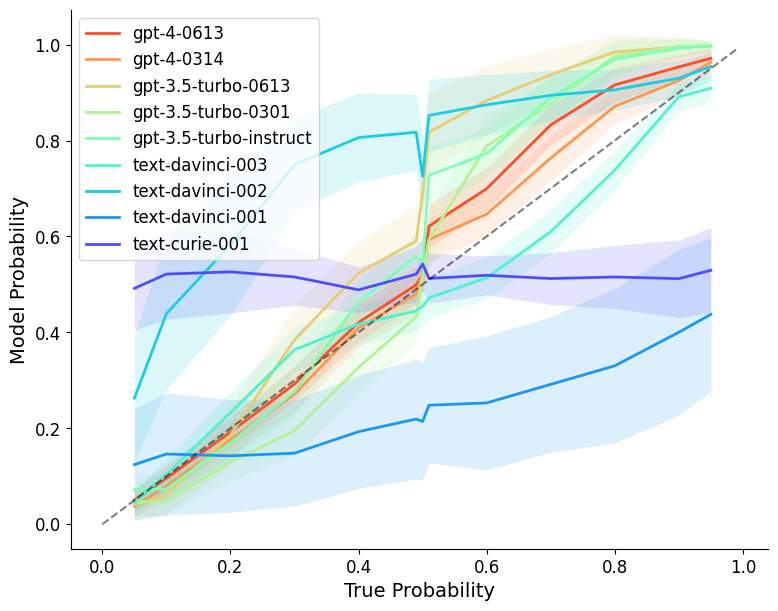

In [60]:
plt.rcParams['figure.figsize'] = (9, 7)

df__ = df_base[df_base.llm != 'Bernoulli-GT'].copy()

sns.lineplot(
    data=df__, x="goal_p", y="mean", hue="llm", lw=2,
    # errorbar=None, 
    errorbar=("sd", 1), err_kws={'alpha': .15, 'lw': 0},
    palette=sns.color_palette('rainbow_r', n_colors=9)
    
)
xr = np.arange(0, 1, .01)
plt.plot(xr, xr, ls='--', color='black', alpha=.5)


plt.xlabel('True Probability', fontsize=14)
plt.ylabel('Model Probability', fontsize=14)
plt.gca().tick_params(axis='both', which='major', labelsize=12)
plt.legend(fontsize=12)

sns.despine()
plt.show()
# plt.savefig('imgs/fig_llms-means_full.pdf')

# Note: LLMs ordered from smallest/oldest to biggest/newest
#   [ ada, babbage (not shown - couldn't do task), curie, dv-1, dv-2, dv-3, 
#     gpt-3.5-instruct, gpt-3.5-0301, gpt-3.5-0613, gpt-4-0314, gpt-4-0613  ]

#### compression

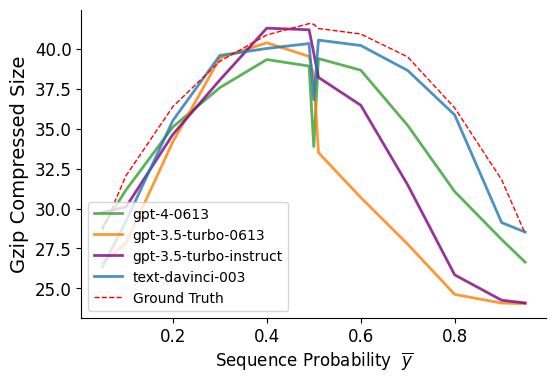

In [61]:
plt.rcParams['figure.figsize'] = (6, 4)

# df__ = df

sns.lineplot(
    data=df_[~df_.llm.isin(['Ground Truth'])], x="goal_p", y="gzip", hue="llm", 
    errorbar=None,  #("sd", 1), err_kws={'alpha': .15, 'lw': 0}, 
    lw=2, palette=[c_mc, c_bern, 'purple', c_gpt], alpha=.8
)

sns.lineplot(
    data=df_[df_.llm == 'Ground Truth'], x="goal_p", y="gzip",
    errorbar=None, color='red', ls='--', label='Ground Truth', lw=1
)

plt.xlabel('Sequence Probability  $\overline{y}$', fontsize=12)
plt.ylabel('Gzip Compressed Size', fontsize=14)
plt.legend(loc='lower left')
plt.gca().tick_params(axis='both', which='major', labelsize=12)

sns.despine()
plt.show()
# plt.savefig('imgs/fig_llms-gzip.pdf')

In [62]:
dff.columns

Index(['Unnamed: 0', 'llm', 'model', 'goal_p', 'gzip', 'mean', 'p_A',
       'long_run', 'run_avg_std', 'run_avg_max', 'run_avg_min', 'flips',
       'gzip_agg'],
      dtype='object')

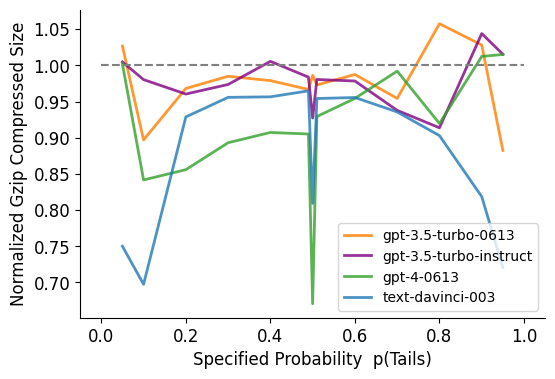

In [63]:
plt.rcParams['figure.figsize'] = (6, 4)


df__ = dff[dff['model'].isin(['llm', 'Bernoulli'])].copy()
df__.sort_values(by=['goal_p', 'llm', 'model', 'flips'], inplace=True)


df__.loc[df__['model'] == 'llm', 'gzip2'] = df__.loc[df__['model'] == 'llm', 'gzip_agg'].to_numpy()  / df__.loc[df__['model'] == 'Bernoulli', 'gzip_agg'].to_numpy()
df__ = df__[df__['model'] == 'llm']

sns.lineplot(
    data=df__, x="goal_p", y="gzip2", hue="llm", 
    errorbar=("pi", 100), err_kws={'alpha': .15, 'lw': 0},
    alpha=.8,
    palette=[c_bern, 'purple', c_mc, c_gpt], lw=2
)
plt.hlines(y=1, xmin=0, xmax=1, ls='--', color='grey')

plt.xlabel('Specified Probability  p(Tails)', fontsize=12)  
plt.ylabel('Normalized Gzip Compressed Size', fontsize=12)
plt.legend(loc='lower right')
# plt.yscale('log')
# plt.gca().get_legend().remove()
plt.gca().tick_params(axis='both', which='major', labelsize=12)
sns.despine()

plt.show()
# plt.savefig('imgs/fig_llms-gzip-ratio.pdf')

#### gambler's fallacy metrics, by LLM - longest run and alternation rate

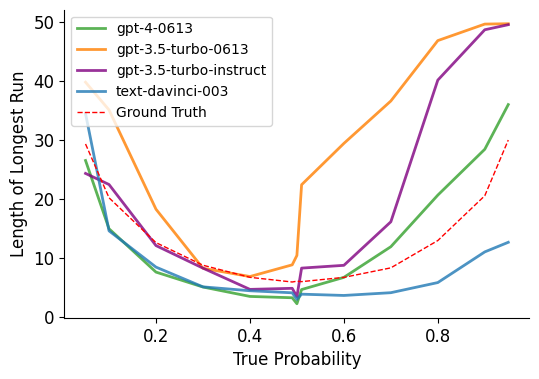

In [114]:
plt.rcParams['figure.figsize'] = (6, 4)

sns.lineplot(
    data=df_[~df_.llm.isin(['Ground Truth'])], x="goal_p", y="long_run", hue="llm", 
    errorbar=None, #("sd", 1), err_style="bars", 
    palette=[c_mc, c_bern, 'purple', c_gpt], lw=2, alpha=.8
)
sns.lineplot(
    data=df_[df_.llm == 'Ground Truth'], x="goal_p", y="long_run", errorbar=None, color='red', ls='--', lw=1, label='Ground Truth'  #  err_style="bars", 
)

plt.xlabel('True Probability', fontsize=12)
plt.ylabel('Length of Longest Run', fontsize=12)
plt.legend(loc='upper left')
plt.gca().tick_params(axis='both', which='major', labelsize=12)
sns.despine()
plt.show()
# plt.savefig('imgs/fig_llms-runs.pdf')

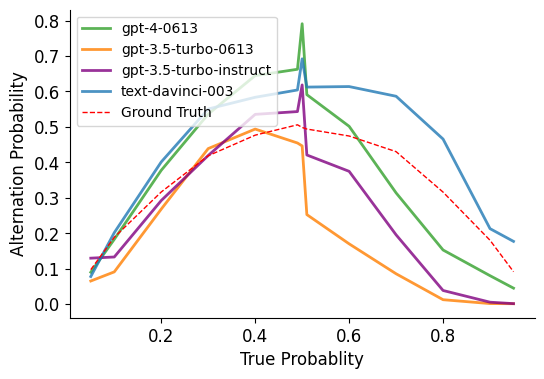

In [97]:
plt.rcParams['figure.figsize'] = (6, 4)

sns.lineplot(
    data=df_[~df_.llm.isin(['Ground Truth'])], x="goal_p", y="p_A", hue="llm", 
    errorbar=None, #=("sd", 1),  #  err_style="bars", 
    palette=[c_mc, c_bern, 'purple', c_gpt], lw=2, alpha=.8
)

sns.lineplot(
    data=df_[df_.llm == 'Ground Truth'], x="goal_p", y="p_A", errorbar=None, color='red', ls='--', lw=1, label='Ground Truth'  #  err_style="bars", 
)

plt.xlabel('True Probablity', fontsize=12)
plt.ylabel('Alternation Probability', fontsize=12);
plt.legend(loc='upper left')
plt.gca().tick_params(axis='both', which='major', labelsize=12)
sns.despine()
plt.show()
# plt.savefig('imgs/fig_llms-alt.pdf')

### running avgs and running avg KDE's

#### individual lines

In [115]:
def plot_avgs(run_avgs, init_mean=.5, goal_p=.5, seq_len=50, figsize=(9, 5), 
              title=None, alpha=0.1, show=True, jitter=0.0, draw_50=False):
    plt.rcParams['figure.figsize'] = figsize

    for y in run_avgs:
        y = y * (1 + np.random.uniform(-jitter, jitter))    # jitter
        sns.lineplot(x=range(len(y)), y=y, alpha=alpha, linewidth=4, color='blue')

    plt.ylim(0, 1)
    plt.xlim(0, seq_len);
    
    plt.hlines(goal_p, 0, seq_len, linestyles='--', color='red', linewidth=2)
    if draw_50:
        plt.hlines(0.5, 0, seq_len, linestyles='--', color='grey', linewidth=2)

    plt.xlabel('Output Index i for $y_i$')
    plt.ylabel('Running Avg. of Generated Flips')
    if title is not None:
        plt.title(title)

In [116]:
d_avg = defaultdict(lambda: defaultdict(dict))
for row in llm_sub_res:
    d_avg[row['llm']][row['model']][row['goal_p']] = row['run_avg']

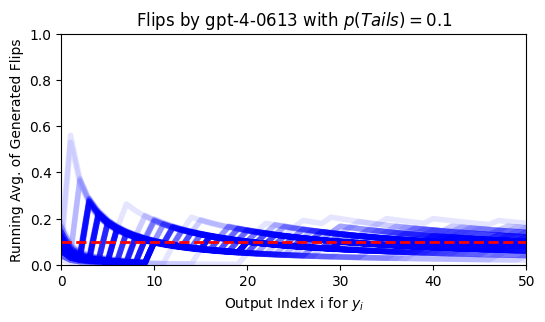

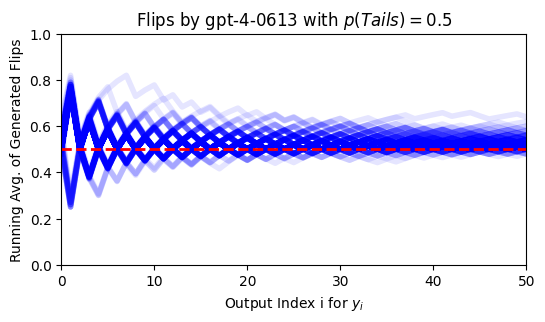

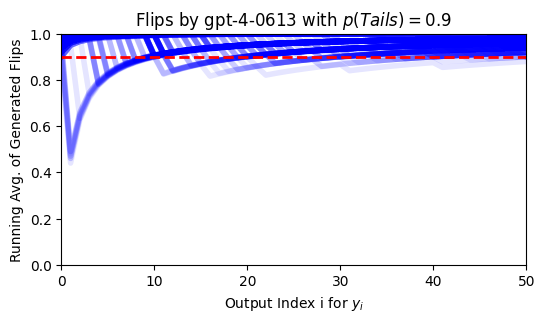

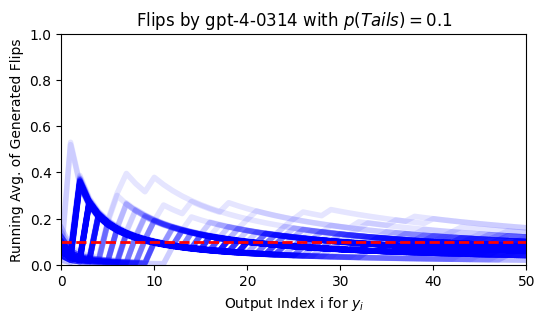

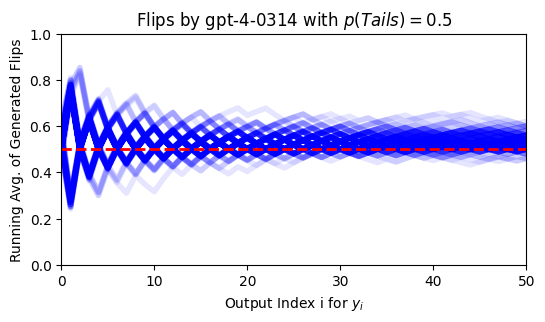

...

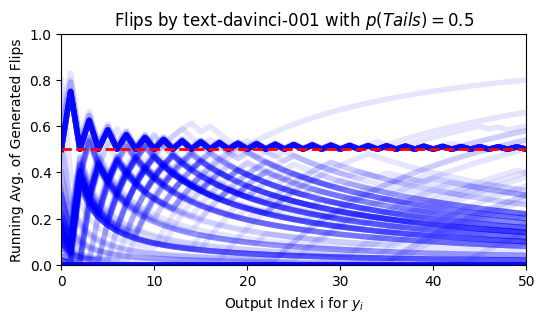

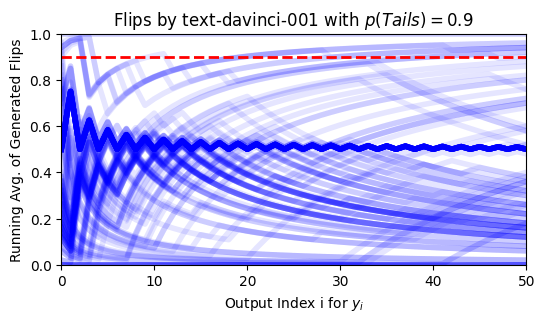

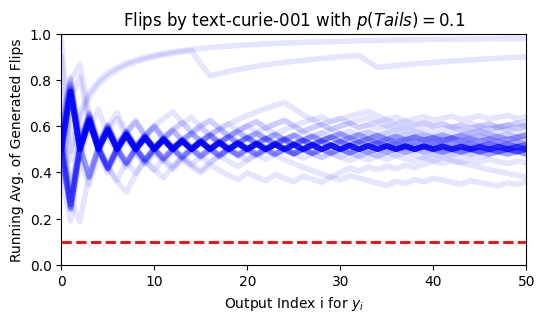

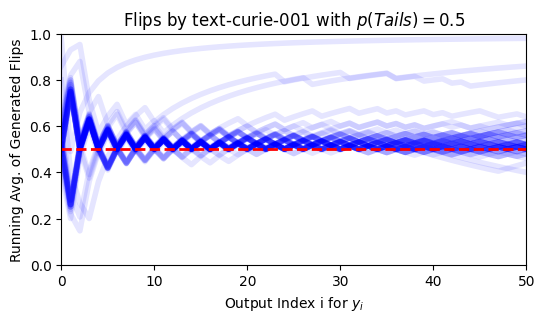

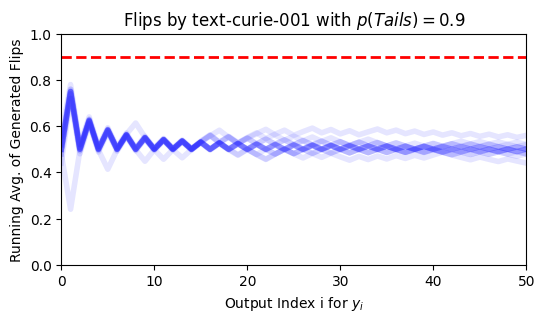

In [117]:
seq_len = 50

for llm, d1 in d_avg.items():
    d2 = d1['llm']
    
    for goal_p in [.1, .5, .9]:
        run_avgs = d2[goal_p]
        
        plot_avgs(run_avgs, title=f'Flips by {llm} with $p(Tails)=${goal_p:.1f}',  # and x=[Heads, ____]', 
                              goal_p=goal_p, init_mean=goal_p, 
                              alpha=0.1, figsize=(6, 3))
        
        # plt.savefig(f'imgs/fig_avgs-{llm}-{100 - p_heads}.pdf')
        plt.show()

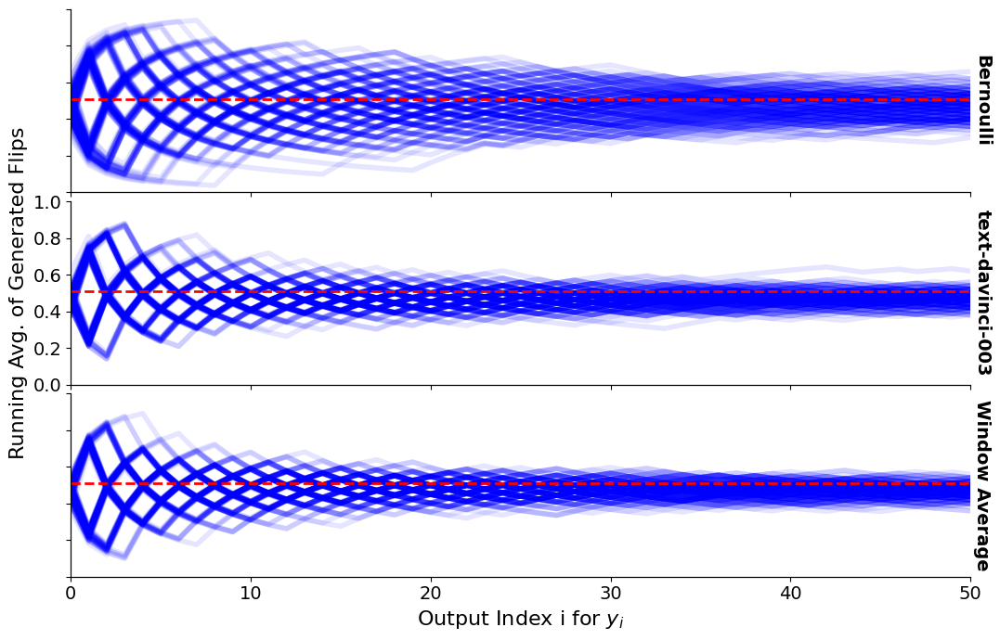

In [119]:
plt.rcParams['figure.figsize'] = (11, 7)
llm = 'text-davinci-003'
models = ['Bernoulli', 'llm', 'window-5']
goal_p = .51
seq_len = 50

fig, axs = plt.subplots(3, 1)
d_avg_ = d_avg[llm]

for model, ax in zip(models, axs):
    run_avgs = d_avg_[model][goal_p]
    modelstr = {
        'llm': llm,
        'Bernoulli': 'Bernoulli',
        'window-5': 'Window Average',
    }[model]

    for y in run_avgs:
        sns.lineplot(ax=ax, x=range(len(y)), y=y, alpha=.1, linewidth=4, color='blue')

    ax.set_ylim(0, 1)
    ax.set_xlim(0, seq_len);

    ax.tick_params(axis='both', which='major', labelsize=14)
    # ax.tick_params(axis='both', which='minor', labelsize=8)
    
    ax.hlines(goal_p, 0, seq_len, linestyles='--', color='red', linewidth=2)
    twin = ax.twinx()
    twin.set_ylabel(modelstr, rotation=-90, labelpad=16, weight='bold', fontsize=14)
    twin.set_yticks([])
    twin.tick_params(labelright='off')

    
    
    

axs[0].set_xticklabels([])
axs[1].set_xticklabels([])
axs[0].set_yticklabels([])
axs[2].set_yticklabels([])

axs[1].set_ylabel('Running Avg. of Generated Flips', fontsize=16)
axs[2].set_xlabel('Output Index i for $y_i$', fontsize=16)
plt.tight_layout()
plt.subplots_adjust(hspace=.05)

sns.despine()  # bottom=True, left=True, right=True, top=True)
# axs[2].spines['left'].set_visible(True)
# axs[2].spines['bottom'].set_visible(True)
    

# plt.savefig(f'imgs/fig_avgs-all-{int(goal_p * 100)}.pdf', pad_inches=0)
plt.show()

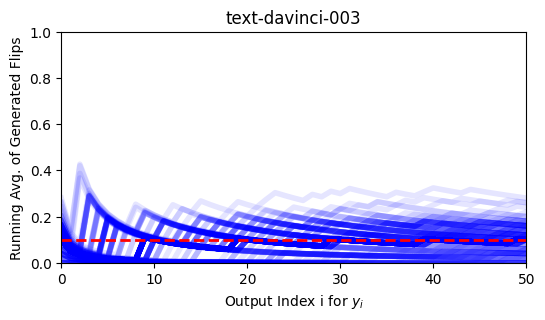

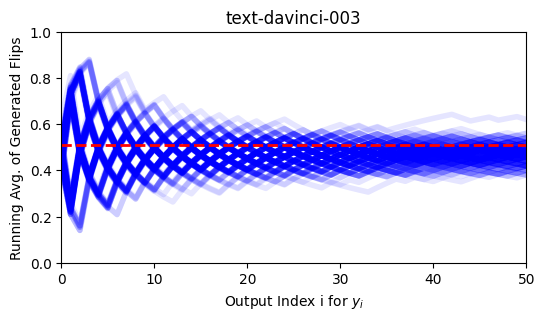

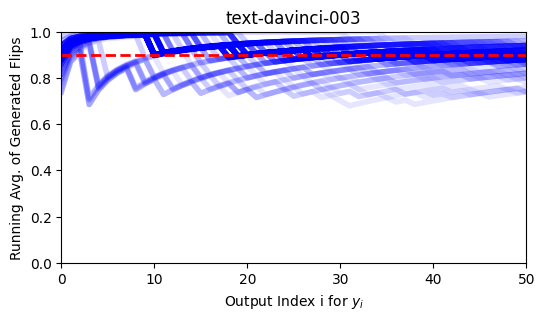

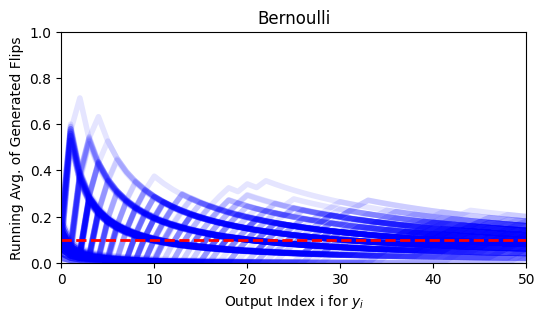

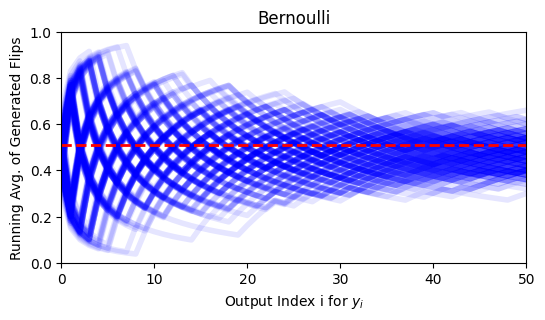

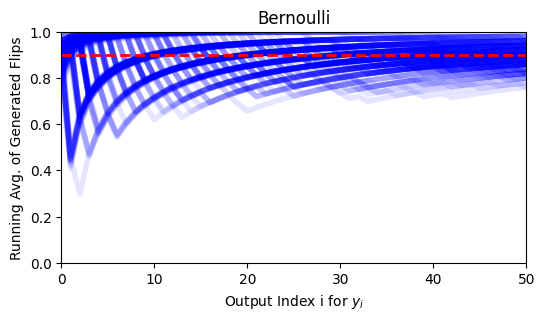

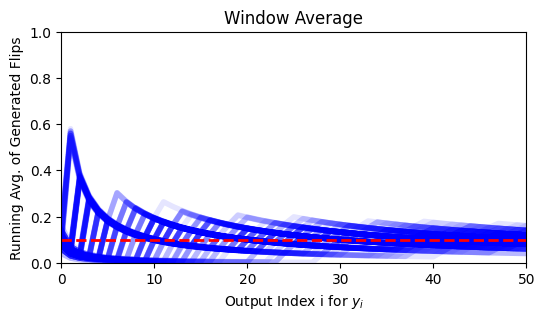

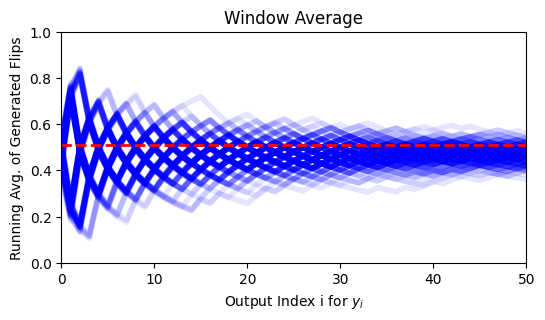

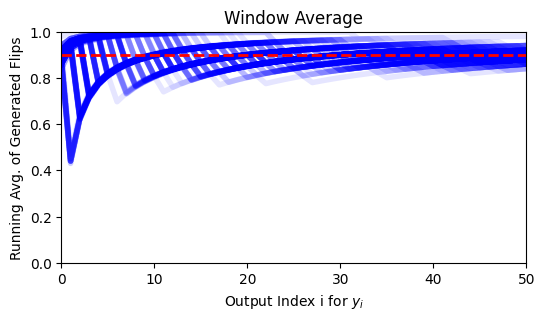

In [121]:
llm = 'text-davinci-003'
models = ['llm', 'Bernoulli', 'window-10']

d_avg_ = d_avg[llm]
for model in models:
    d = d_avg_[model]
    
    for goal_p in [.1, .51, .9]:
        run_avgs = d[goal_p]
        modelstr = {
            'llm': llm,
            'Bernoulli': 'Bernoulli',
            'window-10': 'Window Average',
        }[model]
        plot_avgs(run_avgs, title=f'{modelstr}',  # and x=[Heads, ____]', 
                              goal_p=goal_p, init_mean=goal_p, 
                              alpha=0.1, figsize=(6, 3))
        
        # plt.savefig(f'imgs/fig_avgs-{model}-{int(goal_p * 100)}.pdf')
        plt.show()


#### all lines at once

  0%|                                                                                                    | 0/5 [00:00<?, ?it/s]

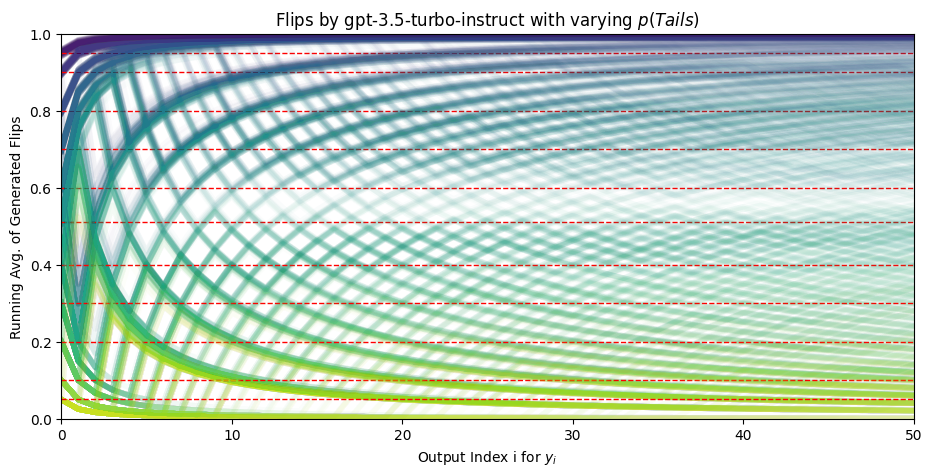

 20%|██████████████████▍                                                                         | 1/5 [00:28<01:54, 28.72s/it]

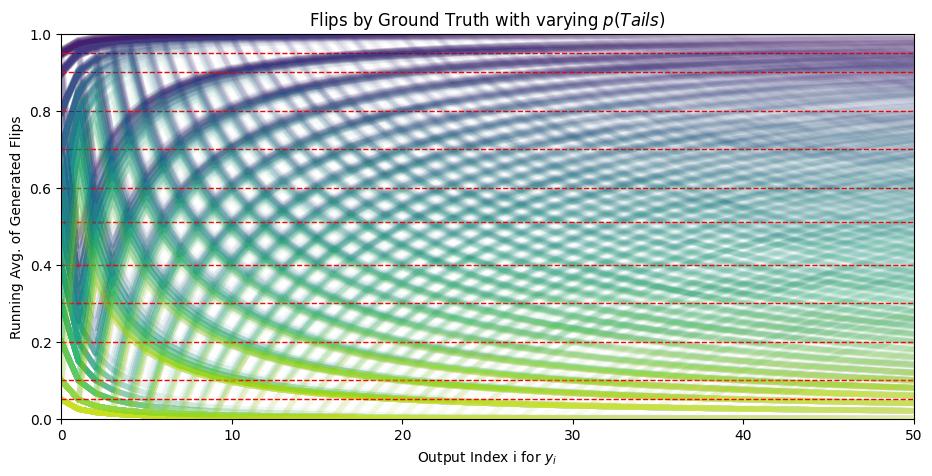

 40%|████████████████████████████████████▊                                                       | 2/5 [00:58<01:28, 29.50s/it]

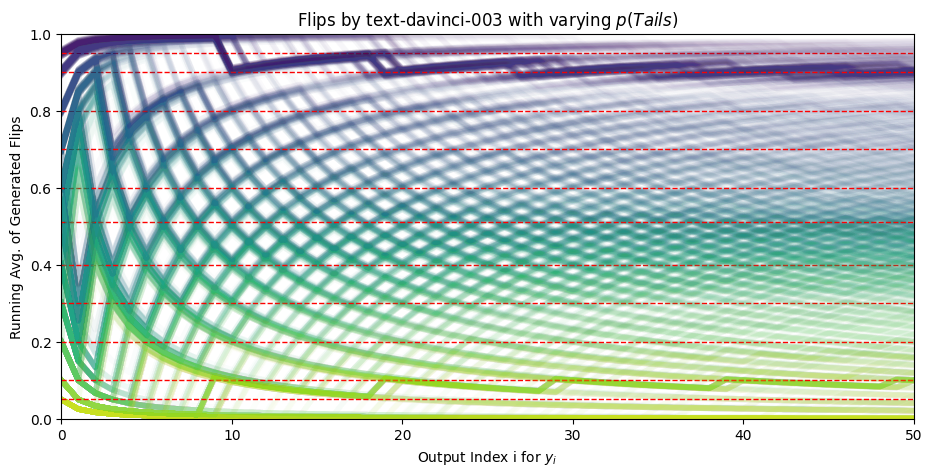

 60%|███████████████████████████████████████████████████████▏                                    | 3/5 [01:27<00:58, 29.19s/it]

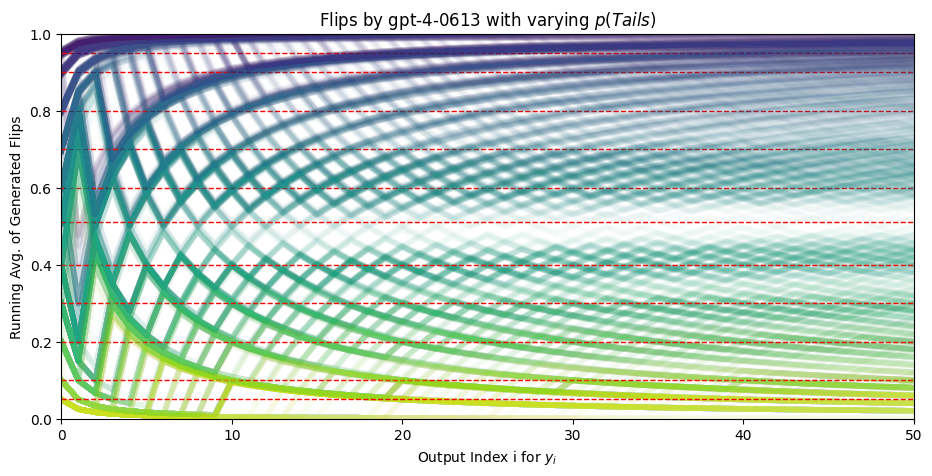

 80%|█████████████████████████████████████████████████████████████████████████▌                  | 4/5 [02:01<00:31, 31.19s/it]

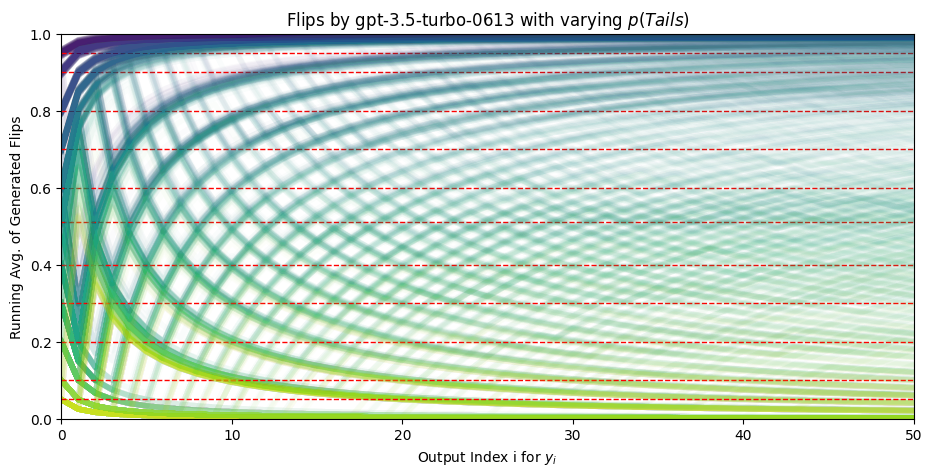

100%|████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [02:32<00:00, 30.57s/it]


In [123]:
plt.rcParams['figure.figsize'] = (11, 5)

seq_len = 50


for llm in tqdm(set(df_.llm)):
    df__ = df_[df_.llm == llm]
    
    # for i, p_heads in enumerate([10, 30, 49, 70, 90]):
    p_heads_ls = [5, 10, 20, 30, 40, 49, 60, 70, 80, 90, 95]   #sorted(set((df_.goal_p * 100).astype(int)))
    for i, p_heads in enumerate(p_heads_ls):
        # color = sns.color_palette('rocket', n_colors=len(p_heads_ls))[i]
        # color = sns.color_palette("coolwarm", n_colors=len(p_heads_ls))[i]
        color = sns.color_palette("viridis", n_colors=len(p_heads_ls))[i]
        
        goal_p = round(1 - (p_heads / 100), 2)
        df___ = df__[df__.goal_p == goal_p]
        
        res_flips = df___['flips'].tolist()
        res_flips = [[int(c) for c in s] for s in res_flips]

        for flips in res_flips:
            y = compute_running_prob(flips, goal_p)
            jit = .01
            y *= (1 + np.random.uniform(-jit, jit))    # jitter
            sns.lineplot(x=range(len(y)), y=y, alpha=.02, linewidth=4, color=color)  #, clip_on=False)
        plt.hlines(goal_p, 0, seq_len, linestyles='--', color='red', linewidth=1)
    
    plt.xlim(0, 50);
    plt.ylim(0, 1)
    # plt.hlines(0.5, 0, seq_len, linestyles='--', color='grey', linewidth=2)
    
    plt.xlabel('Output Index i for $y_i$')
    plt.ylabel('Running Avg. of Generated Flips')
    plt.title(f'Flips by {llm} with varying $p(Tails)$')

    # plt.savefig(f'imgs/fig_avgs-{llm}-all.pdf')
    plt.show()

4it [00:20,  5.22s/it]


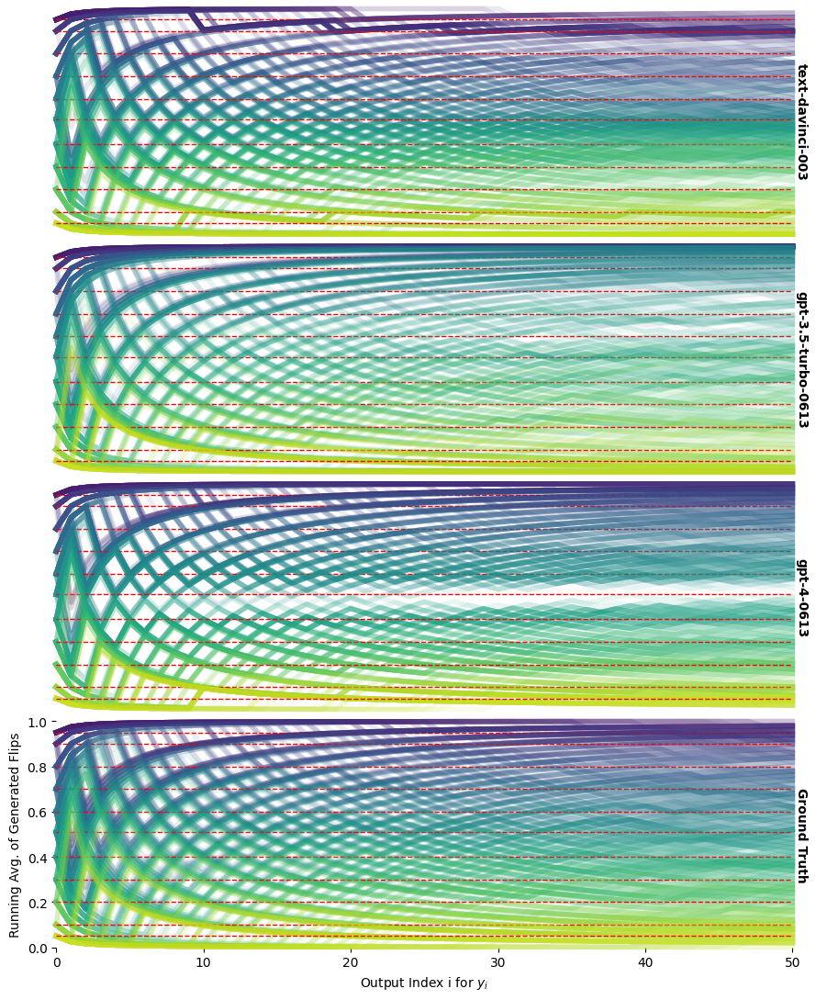

In [126]:
plt.rcParams['figure.figsize'] = (9, 11)
llms_short = ['text-davinci-003', 'gpt-3.5-turbo-0613', 'gpt-4-0613', 'Ground Truth']
# models = ['Bernoulli', 'llm', 'window-5']
seq_len = 50
cap_n_flips = 50

fig, axs = plt.subplots(4, 1)


for llm, ax in tqdm(zip(llms_short, axs)):
    df__ = df_[df_.llm == llm]
    
    # for i, p_heads in enumerate([10, 30, 49, 70, 90]):
    p_heads_ls = [5, 10, 20, 30, 40, 49, 60, 70, 80, 90, 95]   #sorted(set((df_.goal_p * 100).astype(int)))
    for i, p_heads in enumerate(p_heads_ls):
        # color = sns.color_palette('rocket', n_colors=len(p_heads_ls))[i]
        # color = sns.color_palette("coolwarm", n_colors=len(p_heads_ls))[i]
        color = sns.color_palette("viridis", n_colors=len(p_heads_ls))[i]
        
        goal_p = round(1 - (p_heads / 100), 2)
        df___ = df__[df__.goal_p == goal_p]
        
        res_flips = df___['flips'].tolist()
        res_flips = [[int(c) for c in s] for s in res_flips]

        for flips in res_flips[:cap_n_flips]:
            y = compute_running_prob(flips, goal_p)
            sns.lineplot(ax=ax, x=range(len(y)), y=y, alpha=(5 / cap_n_flips), linewidth=4, color=color, clip_on=False)  #, clip_on=False)
        ax.hlines(goal_p, 0, seq_len, linestyles='--', color='red', linewidth=1)

    ax.set_ylim(0, 1)
    ax.set_xlim(0, seq_len);
    
    twin = ax.twinx()
    twin.set_ylabel(llm, rotation=-90, labelpad=12, weight='bold')
    twin.set_yticks([])
    twin.tick_params(labelright='off')

sns.despine(bottom=True, left=True, right=True, top=True)
# axs[3].spines['left'].set_visible(True)
# axs[3].spines['bottom'].set_visible(True)

axs[0].set_xticks([])
axs[1].set_xticks([])
axs[2].set_xticks([])
axs[0].set_yticks([])
axs[1].set_yticks([])
axs[2].set_yticks([])
# axs[0].set_xticklabels([])
# axs[1].set_xticklabels([])
# axs[2].set_xticklabels([])
# axs[0].set_yticklabels([])
# axs[1].set_yticklabels([])
# axs[2].set_yticklabels([])

axs[3].set_ylabel('Running Avg. of Generated Flips')
axs[3].set_xlabel('Output Index i for $y_i$')
plt.tight_layout()
plt.subplots_adjust(hspace=.05)

plt.savefig(f'imgs/fig_avgs-llms-all.pdf')
plt.show()

3it [00:20,  6.71s/it]


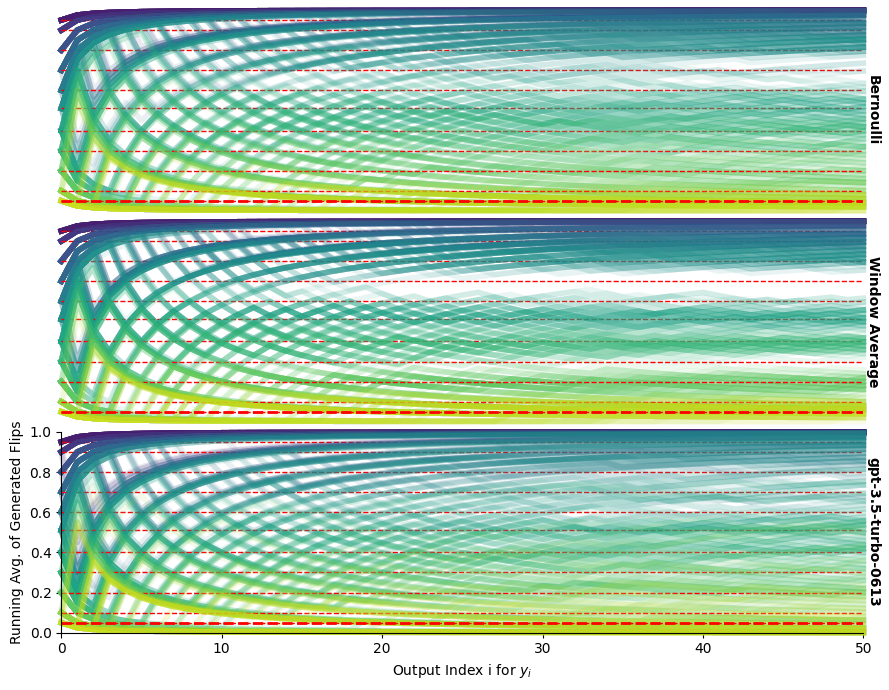

3it [00:15,  5.20s/it]


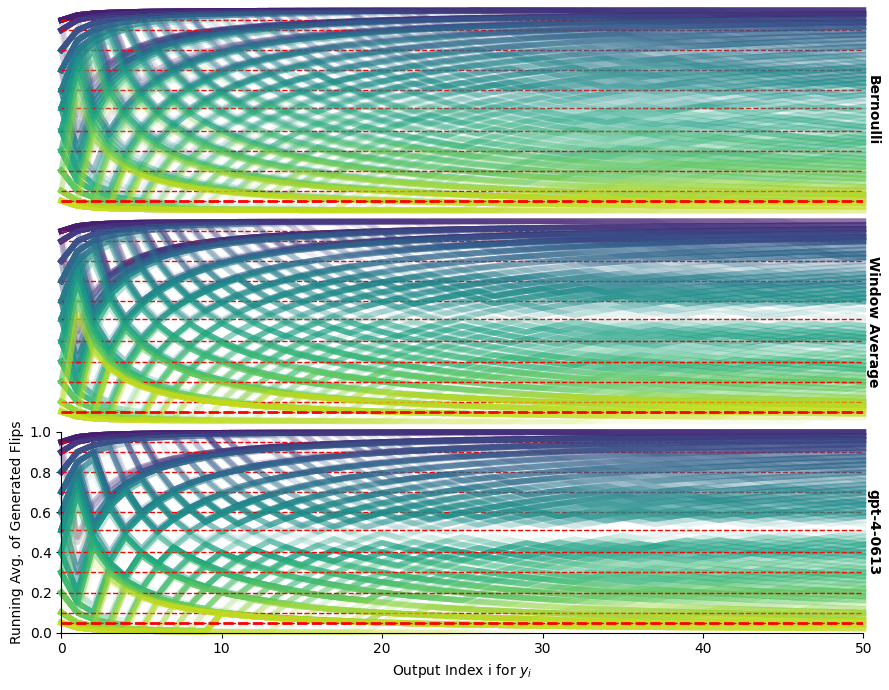

3it [00:17,  5.87s/it]


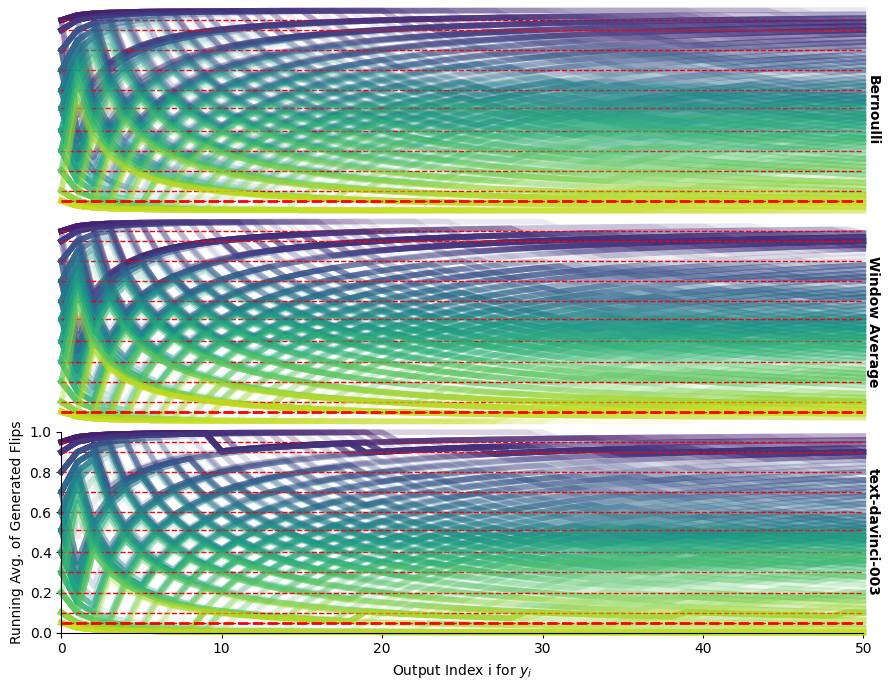

In [127]:
plt.rcParams['figure.figsize'] = (9, 7)
models = ['Bernoulli', 'window-5', 'llm']
seq_len = 50
cap_n_flips = 50


for llm in ['gpt-3.5-turbo-0613', 'gpt-4-0613', 'text-davinci-003']:

    fig, axs = plt.subplots(3, 1)
    
    
    for model, ax in tqdm(zip(models, axs)):
        df__ = dff[(dff.llm == llm) & (dff.model == model)]
        
        # for i, p_heads in enumerate([10, 30, 49, 70, 90]):
        p_heads_ls = [5, 10, 20, 30, 40, 49, 60, 70, 80, 90, 95]   #sorted(set((df_.goal_p * 100).astype(int)))
        for i, p_heads in enumerate(p_heads_ls):
            
            # color = sns.color_palette('rocket', n_colors=len(p_heads_ls))[i]
            # color = sns.color_palette("coolwarm", n_colors=len(p_heads_ls))[i]
            color = sns.color_palette("viridis", n_colors=len(p_heads_ls))[i]
            
            goal_p = round(1 - (p_heads / 100), 2)
            df___ = df__[df__.goal_p == goal_p]
            
            res_flips = df___['flips'].tolist()
            res_flips = [[int(c) for c in s] for s in res_flips]
    
            for flips in res_flips[:cap_n_flips]:
                y = compute_running_prob(flips, goal_p)
                sns.lineplot(ax=ax, x=range(len(y)), y=y, alpha=(5 / cap_n_flips), linewidth=4, color=color, clip_on=False)  #, clip_on=False)
            ax.hlines(goal_p, 0, seq_len, linestyles='--', color='red', linewidth=1)
    
        ax.set_ylim(0, 1)
        ax.set_xlim(0, seq_len);
        
        ax.hlines(goal_p, 0, seq_len, linestyles='--', color='red', linewidth=2)
        twin = ax.twinx()
        modelstr = {
            'llm': llm,
            'Bernoulli': 'Bernoulli',
            'window-5': 'Window Average',
        }[model]
        twin.set_ylabel(modelstr, rotation=-90, labelpad=12, weight='bold')
        twin.set_yticks([])
        twin.tick_params(labelright='off')
        if ax != axs[-1]:
            sns.despine(bottom=True, left=True, right=True, top=True, ax=ax)
        else:
            sns.despine(right=True, top=True, ax=ax)
    
    
    sns.despine(bottom=True, left=True, right=True, top=True)
    axs[2].spines['left'].set_visible(True)
    axs[2].spines['bottom'].set_visible(True)
    
    axs[0].set_xticks([])
    axs[1].set_xticks([])
    axs[0].set_yticks([])
    axs[1].set_yticks([])
    
    axs[2].set_ylabel('Running Avg. of Generated Flips')
    axs[2].set_xlabel('Output Index i for $y_i$')
    plt.tight_layout()
    plt.subplots_adjust(hspace=.05)
    
    plt.savefig(f'imgs/fig_avgs-{llm}-all.pdf')
    plt.show()

### KDE plots

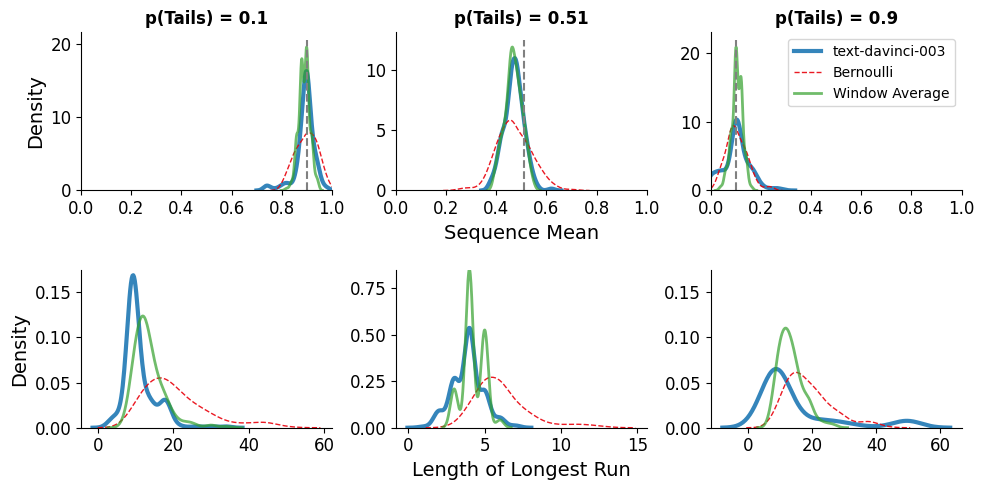

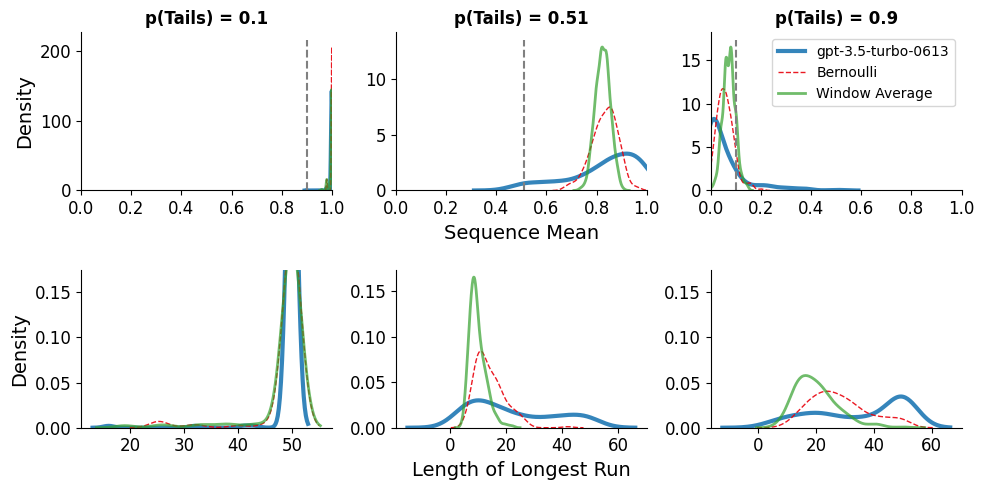

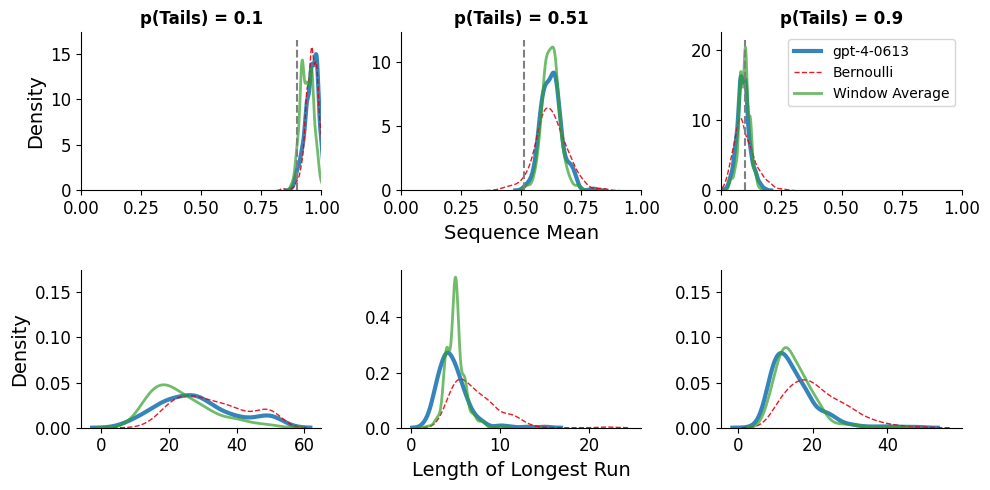

In [128]:
plt.rcParams['figure.figsize'] = (10, 5)


seq_len = 50

###for llm in tqdm(llms_short):
# for llm in set(dff.llm):
for llm in llms_short:
    if llm == 'Ground Truth':
        continue
    fig, axs = plt.subplots(2, 3)
    
    df__ = dff[dff.llm == llm].copy()
    
    # Rename models on legend
    # df__ = df__[df__.model.isin(['Ground Truth', 'Bernoulli', 'llm'])]
    df__.loc[df__['model'] == 'llm', 'model'] = llm
    df__.loc[df__['model'] == 'MC-a', 'model'] = 'Alt. Markov Chain'
    df__.loc[df__['model'] == 'window-5', 'model'] = 'Window Average'
    # df__.loc[df__['model'] == 'Bernoulli', 'model'] = 'Bernoulli'
    # df__.loc[df__['model'] == 'Ground Truth', 'model'] = f'Bernoulli-{goal_p}'
    
    for i, p_heads in enumerate([10, 49, 90]):
        goal_p = round(1 - (p_heads / 100), 3)
        p_tails = 100 - p_heads
        df___ = df__[df__.goal_p == goal_p]
    
        # for j, model in enumerate([llm, 'Bernoulli', 'Ground Truth', 'MC-a']):
            # c = [c_gpt, c_bern, c_gt, c_mc][j]
        for j, model in enumerate([llm, 'Bernoulli', 'Window Average']):
            c = [c_gpt, c_gt, c_mc, 'pink'][j]
            lw = [3, 1, 2][j]
            alpha = [.9, .9, .7][j]
            
            sns.kdeplot(ax=axs[0][i], 
                             data=df___[df___.model == model], x='mean', color=c, label=model,
                            alpha=alpha,
                            lw=lw,
                            ls=('--' if model == 'Bernoulli' else None))
            sns.kdeplot(ax=axs[1][i], 
                             data=df___[df___.model == model], x='long_run', color=c, label=model,
                        alpha=alpha,
                            lw=lw,
                            ls=('--' if model == 'Bernoulli' else None))
            
        axs[0][i].vlines(x=goal_p, ymin=0, ymax=axs[0][i].get_ylim()[1], ls='--', color='grey')
        axs[0][i].set_xlim(0, 1)
        
        axs[0][0].set(xlabel=None)
        axs[0][0].set_ylabel('Density', fontsize=14)
        axs[0][1].set(ylabel=None)
        axs[0][1].set_xlabel('Sequence Mean', fontsize=14)
        axs[0][2].set(ylabel=None, xlabel=None)
        axs[1][0].set(xlabel=None)
        axs[1][0].set_ylabel('Density', fontsize=14)
        axs[1][1].set(ylabel=None)
        axs[1][1].set_xlabel('Length of Longest Run', fontsize=14)
        axs[1][2].set(ylabel=None, xlabel=None)
        for axs_ in axs:
            for ax in axs_:
                ax.tick_params(axis='both', which='major', labelsize=12)
    
    axs[0][2].legend(loc='upper right')
    axs[0][0].set_title('p(Tails) = 0.1', weight='bold')
    axs[0][1].set_title('p(Tails) = 0.51', weight='bold')
    axs[0][2].set_title('p(Tails) = 0.9', weight='bold')
    axs[1][0].set_ylim(0, .175)
    if llm == 'text-davinci-003':
        axs[1][1].set_ylim(0, .85)
    axs[1][2].set_ylim(0, .175)
    plt.tight_layout()
    plt.subplots_adjust(hspace = 0.5)
    sns.despine()
    # plt.savefig(f'imgs/fig_hists-{llm}.pdf', pad_inches=0, bbox_inches='tight')
    plt.show();

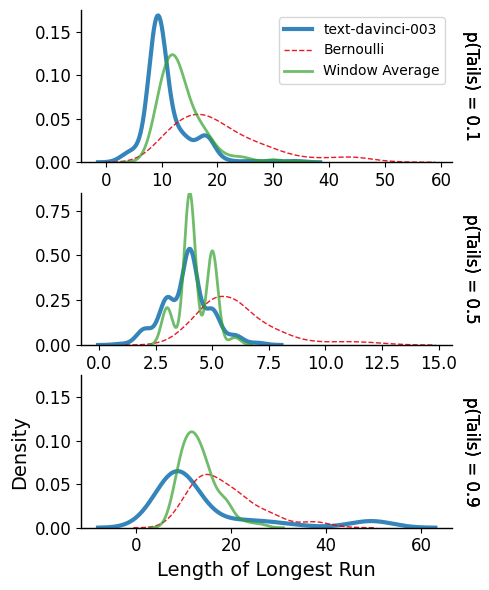

In [129]:
plt.rcParams['figure.figsize'] = (5, 6)


seq_len = 50

###for llm in tqdm(llms_short):
# for llm in set(dff.llm):
llm = 'text-davinci-003'
fig, axs = plt.subplots(3, 1)

df__ = dff[dff.llm == llm].copy()

# Rename models on legend
# df__ = df__[df__.model.isin(['Ground Truth', 'Bernoulli', 'llm'])]
df__.loc[df__['model'] == 'llm', 'model'] = llm
df__.loc[df__['model'] == 'MC-a', 'model'] = 'Alt. Markov Chain'
df__.loc[df__['model'] == 'window-5', 'model'] = 'Window Average'
# df__.loc[df__['model'] == 'Bernoulli', 'model'] = 'Bernoulli'
# df__.loc[df__['model'] == 'Ground Truth', 'model'] = f'Bernoulli-{goal_p}'

titles = ['p(Tails) = 0.1',
         'p(Tails) = 0.5',
         'p(Tails) = 0.9']

for i, p_heads in enumerate([10, 49, 90]):
    goal_p = round(1 - (p_heads / 100), 3)
    p_tails = 100 - p_heads
    df___ = df__[df__.goal_p == goal_p]

    # for j, model in enumerate([llm, 'Bernoulli', 'Ground Truth', 'MC-a']):
        # c = [c_gpt, c_bern, c_gt, c_mc][j]
    for j, model in enumerate([llm, 'Bernoulli', 'Window Average']):
        c = [c_gpt, c_gt, c_mc, 'pink'][j]
        lw = [3, 1, 2][j]
        alpha = [.9, .9, .7][j]
        
        sns.kdeplot(ax=axs[i], 
                         data=df___[df___.model == model], x='long_run', color=c, label=model,
                    alpha=alpha,
                        lw=lw,
                        ls=('--' if model == 'Bernoulli' else None))
        twin = axs[i].twinx()
        twin.set_ylabel(titles[i], rotation=-90, labelpad=20, fontsize=12)
        twin.set_yticks([])
        twin.tick_params(labelright='off')
        
    axs[0].set(xlabel=None, ylabel=None)
    axs[1].set(xlabel=None, ylabel=None)
    axs[2].set_ylabel('Density', fontsize=14)
    axs[2].set_xlabel('Length of Longest Run', fontsize=14)
    for ax in axs:
        ax.tick_params(axis='both', which='major', labelsize=12)

axs[0].legend(loc='upper right')


axs[0].set_ylim(0, .175)
if llm == 'text-davinci-003':
    axs[1].set_ylim(0, .85)
axs[2].set_ylim(0, .175)
plt.tight_layout()
plt.subplots_adjust(hspace = 0.2)
sns.despine()

# plt.savefig(f'imgs/fig_gambler-short-{llm}.pdf', pad_inches=0, bbox_inches='tight')
plt.show()

### String compression

#### gzip

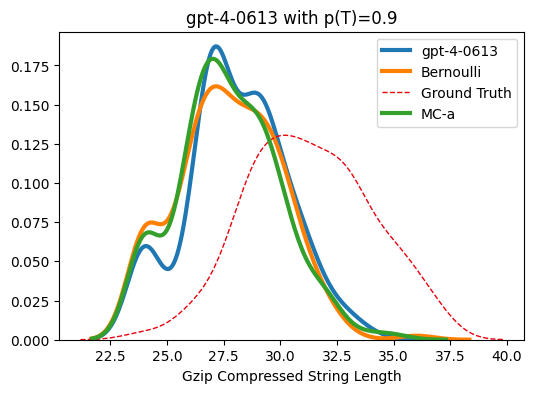

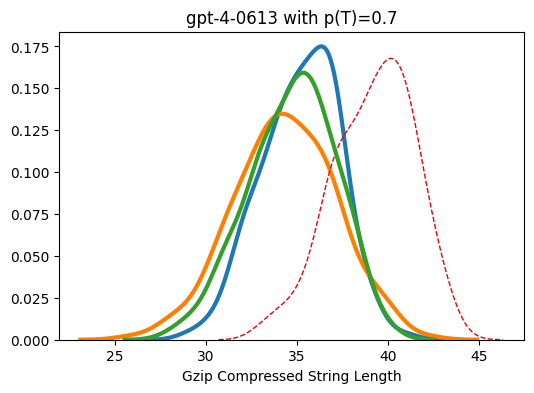

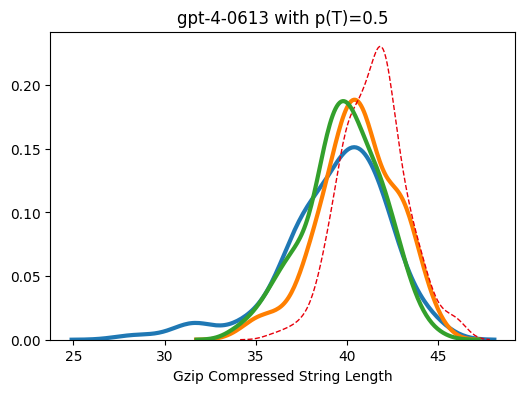

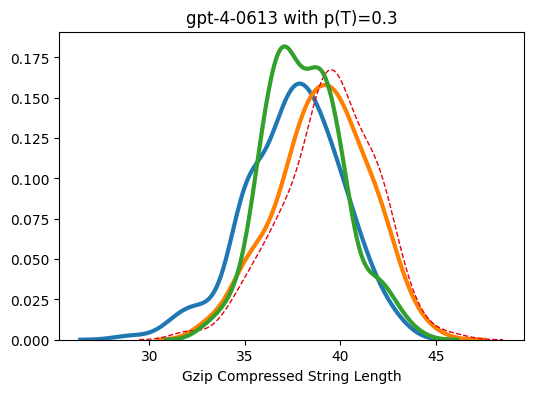

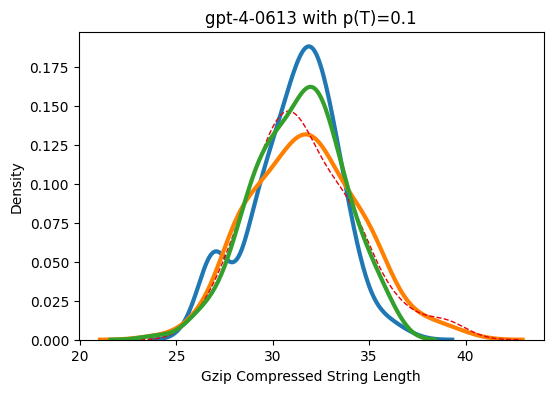

...

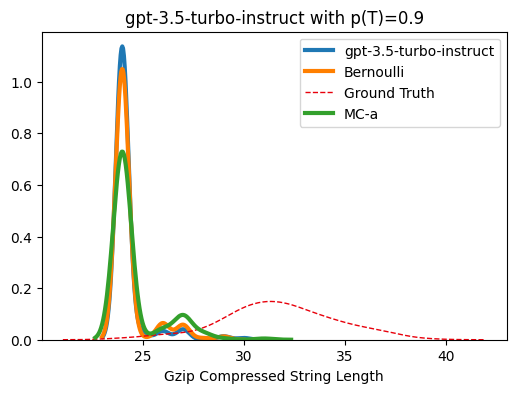

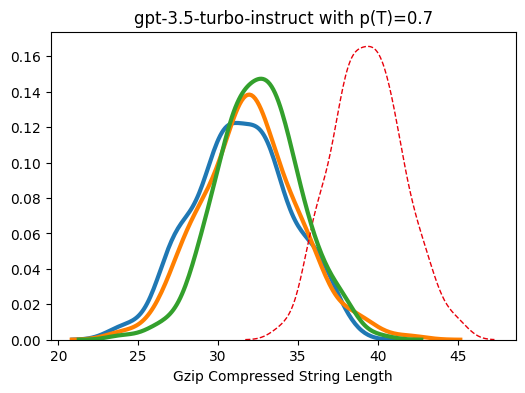

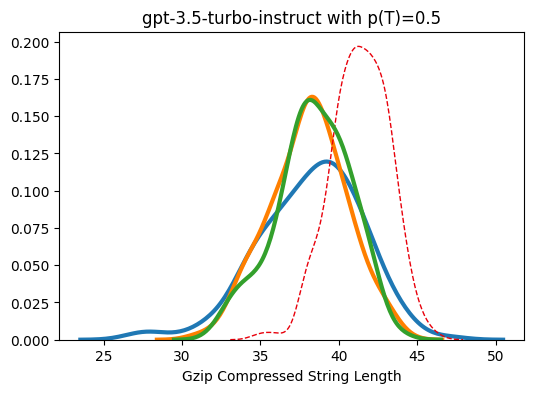

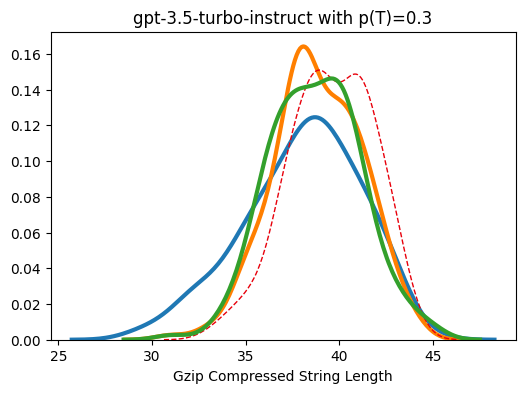

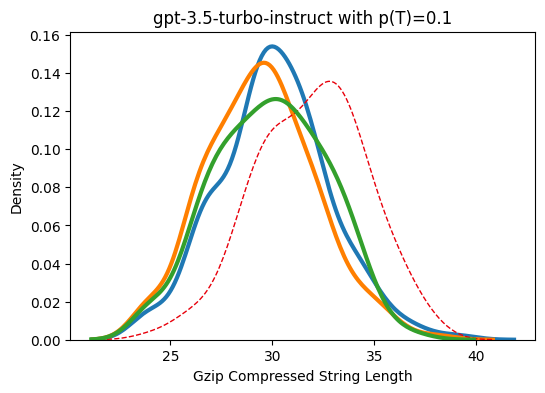

In [130]:
plt.rcParams['figure.figsize'] = (6, 4)


seq_len = 50

for llm in set(dff.llm):
    df__ = dff[dff.llm == llm].copy()
    # df__ = df__[df__.model.isin(['Ground Truth', 'Bernoulli', 'llm'])]

    # Rename models on legend
    df__.loc[df__['model'] == 'llm', 'model'] = llm
    df__.loc[df__['model'] == 'Bernoulli', 'model'] = 'Bernoulli'
    # df__.loc[df__['model'] == 'Ground Truth', 'model'] = f'Bernoulli-{goal_p}'
    
    for p_heads in [10, 30, 49, 70, 90]:
        goal_p = round(1 - (p_heads / 100), 2)
        p_tails = 100 - p_heads
        df___ = df__[df__.goal_p == goal_p]
        
        for i, model in enumerate([llm, 'Bernoulli', 'Ground Truth', 'MC-a']):
            ax = sns.kdeplot(data=df___[df___.model == model], x='gzip', color=[c_gpt, c_bern, c_gt, c_mc][i], label=model,
                            lw=(1 if model == 'Ground Truth' else 3),
                            ls=('--' if model == 'Ground Truth' else None))

        ax.set(xlabel=r'Gzip Compressed String Length')
        # sns.jointplot(data=df_mu, x='mu', y='std', hue='model', kind='kde', ratio=2, xlim=(0, .5), ylim=(.2, .6))
        plt.title(f'{llm} with p(T)={goal_p:.1f}')
        
        if p_heads != 10:
            plt.legend([],[], frameon=False)
        else:
            plt.legend(loc = 'upper right')
        if p_heads != 90:
            ax.set(ylabel=None)
            
        ymax = ax.get_ylim()[1]
        # plt.savefig(f'imgs/fig_hist-gzip_{llm}_{100 - p_heads}.pdf', pad_inches=0, bbox_inches='tight'); 
        plt.show()

#### levenshtein

In [12]:
llms = sorted({row['llm'] for row in llm_sub_res})
p_tails = sorted({row['goal_p'] for row in llm_sub_res})
models = sorted({row['model'] for row in llm_sub_res})


rows = []
for row in tqdm(llm_sub_res):
    levs = np.tril(row['lev_dists'])     # drop half of distance matrix so we don't have duplicates for d(x, x')
    if row['llm'] not in llms_short:
        continue
    rows += [{
        'lev': l,
        'llm': row['llm'],
        'goal_p': row['goal_p'],
        'model': row['model'], 
        'flips': row['flips'], 
    } for l in levs.flatten()]

df_lev = pd.DataFrame(rows)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 3744/3744 [01:02<00:00, 60.07it/s]


In [17]:
models_short = ['Ground Truth', 'llm', 'Bernoulli', 'MC-a', 'window-5', 'MC-10']

<Axes: xlabel='goal_p', ylabel='lev'>

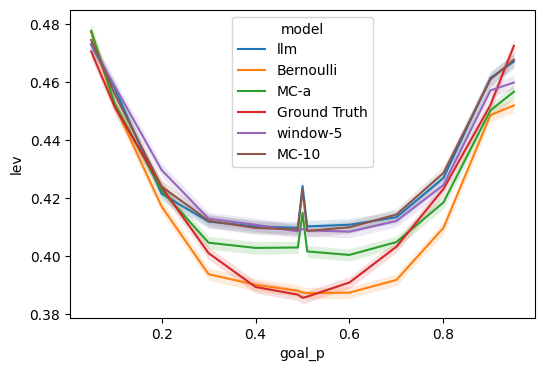

In [18]:
plt.rcParams['figure.figsize'] = (6, 4)

llm = 'text-davinci-003'
df_lev_ = df_lev[df_lev['llm'] == llm]
df_lev_ = df_lev_[df_lev_['model'].isin(models_short)]
sns.lineplot(
    data=df_lev_, x="goal_p", y="lev", hue="model", 
    errorbar=("se", 1), err_kws={'alpha': .15, 'lw': 0},
    #err_style="bars", err_kws={'capsize': 3}, alpha=.7,
)

<Axes: xlabel='goal_p', ylabel='lev'>

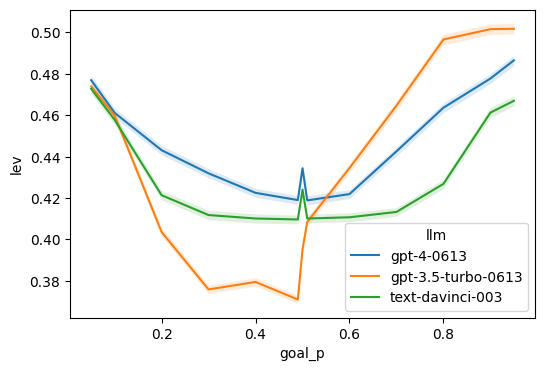

In [19]:
df_lev_ = df_lev[df_lev['model'] == 'llm']
df_lev_ = df_lev_[df_lev_['llm'].isin(['gpt-4-0613','gpt-3.5-turbo-0613', 'text-davinci-003'])]
sns.lineplot(
    data=df_lev_, x="goal_p", y="lev", hue="llm", 
    errorbar=("se", 1), err_kws={'alpha': .15, 'lw': 0},
    #err_style="bars", err_kws={'capsize': 3}, alpha=.7,
)

Text(0, 0.5, 'Ratio of Mean Levenshtein Distances')

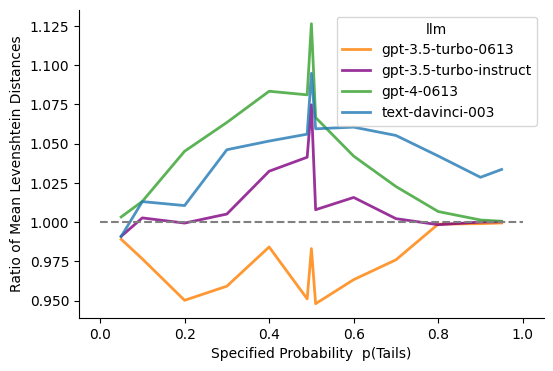

In [25]:
plt.rcParams['figure.figsize'] = (6, 4)

df__ = df_lev[df_lev['model'].isin(['llm', 'Bernoulli'])].copy()
df__ = df__[df__['llm'].isin(['gpt-4-0613','gpt-3.5-turbo-0613', 'text-davinci-003', 'gpt-3.5-turbo-instruct'])]
df__ = df__[['lev', 'llm', 'goal_p', 'model']]

df__ = df__.groupby(['goal_p', 'llm', 'model'], as_index=False).aggregate('mean')
df__ = df__.sort_values(by=['goal_p', 'llm', 'model'])

# Normalize levenshtein distances by lev dists for an equal probability Bernoulli dist.
#   since higher bias makes binary sequences more compressable.
df__.loc[df__['model'] == 'llm', 'lev'] = df__.loc[df__['model'] == 'llm', 'lev'].to_numpy()  / df__.loc[df__['model'] == 'Bernoulli', 'lev'].to_numpy()
df__ = df__[df__['model'] == 'llm']

sns.lineplot(
    data=df__, x="goal_p", y="lev", hue="llm", 
    # errorbar=("se", 1), err_kws={'alpha': .15, 'lw': 0},
    palette=[c_bern, 'purple', c_mc, c_gpt],  lw=2, alpha=.8
)
plt.hlines(1, 0, 1, color='grey', ls='--')
sns.despine()
plt.xlabel('Specified Probability  p(Tails)')
plt.ylabel('Ratio of Mean Levenshtein Distances')
# plt.savefig('imgs/fig_llms-lev.pdf')

#### sub-strings

In [144]:
models = ['llm', 'window-5', 'MC-2', 'MC-5', 'MC-10', 'Bernoulli']  # 'Ground Truth', 

rows = []
for row in tqdm(llm_sub_res):
    for w, w_subs in row['subs'].items():
        for x, y in enumerate(sorted(w_subs.values(), reverse=True)):
            if row['model'] not in models:
                continue
            r = {
                'x': x+1,
                'y': y,
                'window_size': w,

                'llm': row['llm'],
                'goal_p': row['goal_p'],
                'model': row['model'], 
            }
            rows.append(r)

df_sub1 = pd.DataFrame(rows)

100%|█████████████████████████████████████████████████████████████████████████████████████| 3744/3744 [00:15<00:00, 243.09it/s]


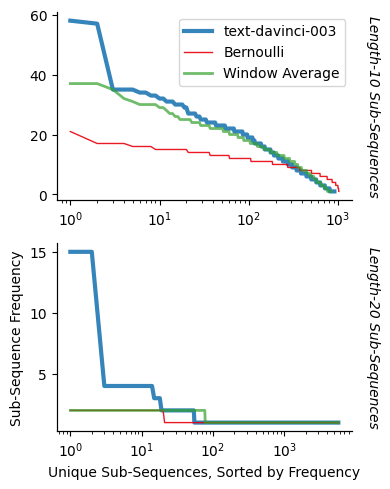

In [145]:
plt.rcParams['figure.figsize'] = (4, 5)

llm = 'text-davinci-003'
goal_p = .51

fig, axs = plt.subplots(2, 1)

for window_size, ax in zip([10, 20], axs):
    df_sub1_ = df_sub1[(df_sub1['llm'] == llm) & \
                       (df_sub1['goal_p'] == goal_p) & \
                       (df_sub1['window_size'] == window_size)].copy()
    
    
    # Rename models on legend
    df_sub1_.loc[df_sub1_['model'] == 'llm', 'model'] = llm
    df_sub1_.loc[df_sub1_['model'] == 'window-5', 'model'] = 'Window Average'
    
    for j, model in enumerate([llm, 'Bernoulli', 'Window Average']):
        c = [c_gpt, c_gt, c_mc][j]
        lw = [3, 1, 2][j]
        alpha = [.9, .9, .7][j]
        sns.lineplot(
            ax=ax,
            data=df_sub1_[df_sub1_.model == model], x="x", y="y",
            color=c,
            alpha=alpha,
            lw=lw,
            label=model
        )
    ax.set_xscale('log');
    twin = ax.twinx()
    twin.set_ylabel(f'Length-{window_size} Sub-Sequences', rotation=-90, labelpad=20, style='italic')
    twin.set_yticks([])
    twin.tick_params(labelright='off')
    
axs[1].get_legend().remove() 
axs[0].set_xlabel(None)
axs[1].set_xlabel(r'Unique Sub-Sequences, Sorted by Frequency')
axs[0].set_ylabel(None);
axs[1].set_ylabel(r'Sub-Sequence Frequency');
plt.tight_layout()
sns.despine()
# plt.savefig('imgs/fig_subs-51.pdf')

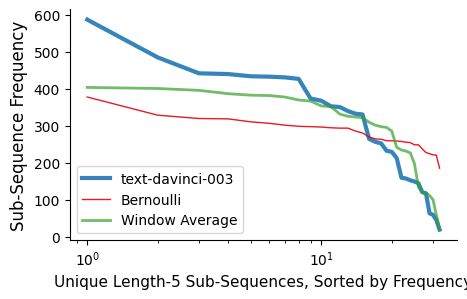

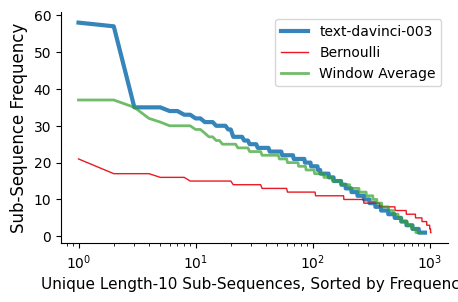

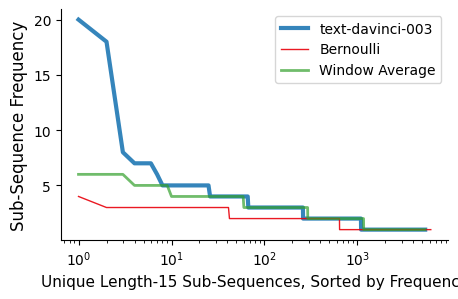

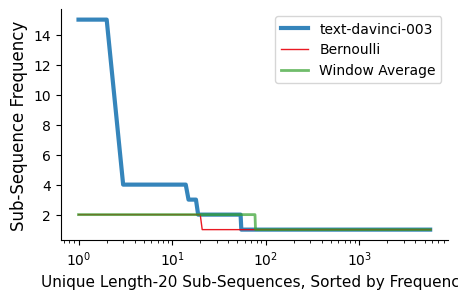

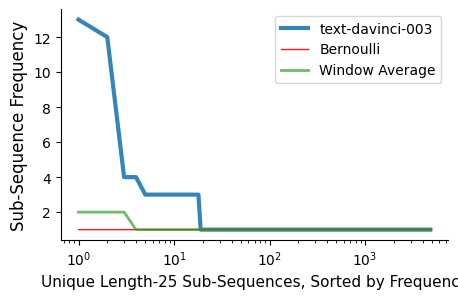

In [146]:
plt.rcParams['figure.figsize'] = (5, 3)

llm = 'text-davinci-003'
goal_p = .51
# window_size = 10
for window_size in [5, 10, 15, 20, 25]:
    df_sub1_ = df_sub1[(df_sub1['llm'] == llm) & \
                       (df_sub1['goal_p'] == goal_p) & \
                       (df_sub1['window_size'] == window_size)].copy()
    
    # Rename models on legend
    df_sub1_.loc[df_sub1_['model'] == 'llm', 'model'] = llm
    df_sub1_.loc[df_sub1_['model'] == 'window-5', 'model'] = 'Window Average'
    
    for j, model in enumerate([llm, 'Bernoulli', 'Window Average']):
        c = [c_gpt, c_gt, c_mc][j]
        lw = [3, 1, 2][j]
        alpha = [.9, .9, .7][j]
        sns.lineplot(
            data=df_sub1_[df_sub1_.model == model], x="x", y="y",
            color=c,
            alpha=alpha,
            lw=lw,
            label=model
        )
    # ax.set_xscale('log');
    # twin = ax.twinx()
    # twin.set_ylabel(f'Length-{window_size} Sub-Sequences', rotation=-90, labelpad=20, style='italic')
    # twin.set_yticks([])
    # twin.tick_params(labelright='off')
    # axs[1].get_legend().remove() 
    plt.xscale('log')
    plt.xlabel(f'Unique Length-{window_size} Sub-Sequences, Sorted by Frequency', fontsize=11)
    plt.ylabel(r'Sub-Sequence Frequency', fontsize=12);
    sns.despine()
    # plt.savefig(f'imgs/fig_subs-51-{window_size}.pdf', bbox_inches="tight")
    plt.show();

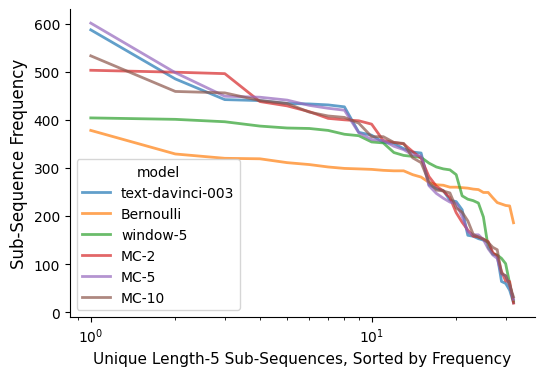

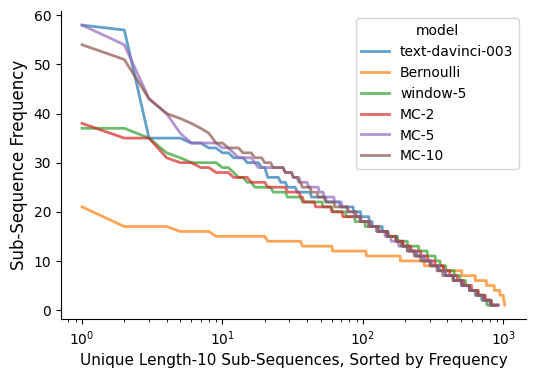

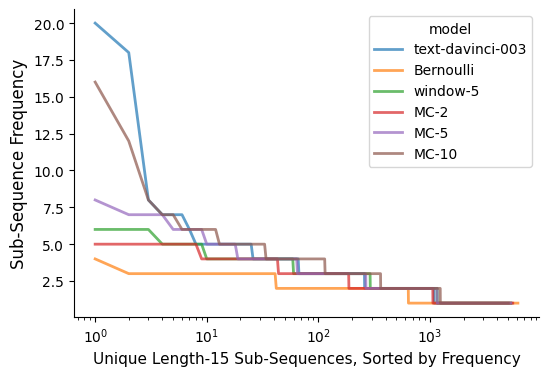

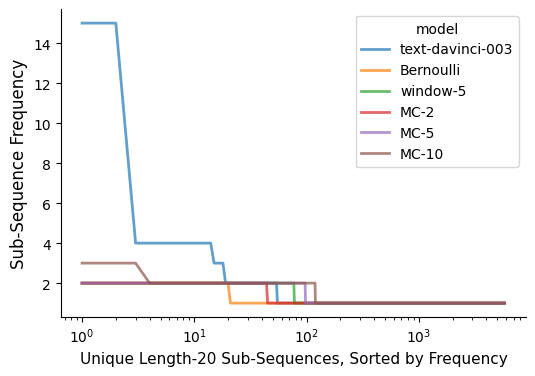

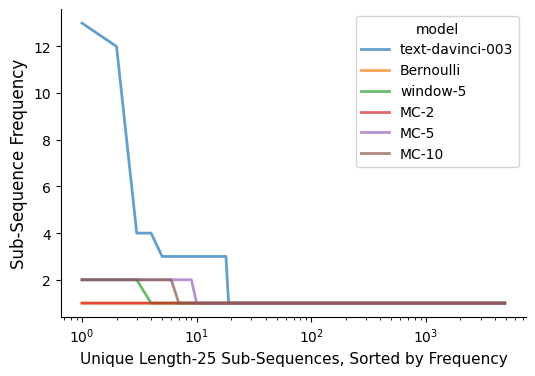

In [148]:
plt.rcParams['figure.figsize'] = (6, 4)

llm = 'text-davinci-003'
goal_p = .51

for window_size in [5, 10, 15, 20, 25]:
    
    df_sub1_ = df_sub1[(df_sub1['llm'] == llm) & \
                       (df_sub1['goal_p'] == goal_p) & \
                       (df_sub1['window_size'] == window_size)].copy()
    df_sub1_.loc[df_sub1_['model'] == 'llm', 'model'] = llm
    
    sns.lineplot(
        data=df_sub1_, x="x", y="y", hue="model", 
        lw=2, alpha=.7
        # errorbar=("se", 1), err_kws={'alpha': .15, 'lw': 0},
    )
    plt.xscale('log');
    # plt.yscale('log');
    plt.xlabel(f'Unique Length-{window_size} Sub-Sequences, Sorted by Frequency', fontsize=11)
    plt.ylabel('Sub-Sequence Frequency', fontsize=12);
    
    sns.despine()
    # plt.savefig(f'imgs/fig_subs-51-dv3_models-w={window_size}.pdf', bbox_inches="tight");
    plt.show()

##### additional sub-sequence distribution plots not included in paper

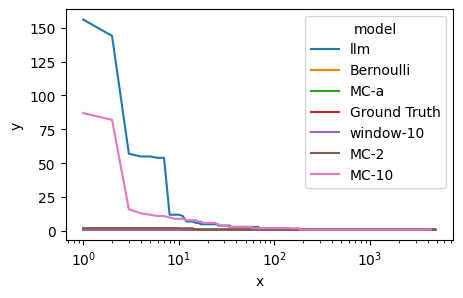

In [172]:
llm = 'text-davinci-003'
df_sub1_ = df_sub1[(df_sub1['llm'] == llm) & \
                   (df_sub1['goal_p'] == .5) & \
                   (df_sub1['window_size'] == 25)]
sns.lineplot(
    data=df_sub1_, x="x", y="y", hue="model", 
    # errorbar=("se", 1), err_kws={'alpha': .15, 'lw': 0},
    #err_style="bars", err_kws={'capsize': 3}, alpha=.7,
)
plt.xscale('log');

In [40]:
plt.rcParams['figure.figsize'] = (5, 3)

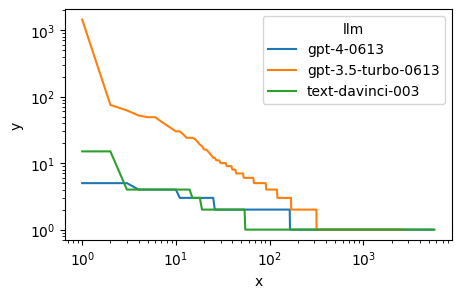

In [41]:
goal_p = .51
window_size = 20

df_sub1_ = df_sub1[(df_sub1['llm'].isin(llms_short)) & \
                   (df_sub1['model'] == 'llm') & \
                   (df_sub1['goal_p'] == goal_p) & \
                   (df_sub1['window_size'] == window_size)]
sns.lineplot(
    data=df_sub1_, x="x", y="y", hue="llm", 
)
plt.xscale('log');
plt.yscale('log');
# plt.ylim(0, 200);

/var/folders/41/_ql36yd95wq0zy1_ml3g0g2w0000gn/T/ipykernel_1795/1079017296.py:6: FutureWarning: The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  df_sub1_ = df_sub1_.groupby(['goal_p', 'window_size', 'llm', 'model'], as_index=False).aggregate(sum)


<Axes: xlabel='goal_p', ylabel='x'>

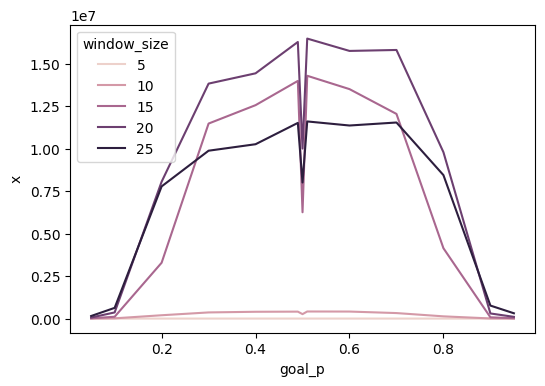

In [149]:
llm = 'text-davinci-003'

df_sub1_ = df_sub1[(df_sub1['llm'] == llm) & \
                   (df_sub1['model'] == 'llm')]

df_sub1_ = df_sub1_.groupby(['goal_p', 'window_size', 'llm', 'model'], as_index=False).aggregate(sum)
# df_sub1_.loc[:, 'x'] = df_sub1_.loc[:, 'x'] / df_sub1_.loc[:, 'y']

sns.lineplot(
    data=df_sub1_, x="goal_p", y="x", hue="window_size", 
)

In [150]:
plt.rcParams['figure.figsize'] = (6, 3)

/var/folders/41/_ql36yd95wq0zy1_ml3g0g2w0000gn/T/ipykernel_1795/3956876057.py:5: FutureWarning: The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  df_sub1_ = df_sub1_.groupby(['goal_p', 'window_size', 'llm', 'model'], as_index=False).aggregate(sum)


<Axes: xlabel='goal_p', ylabel='x'>

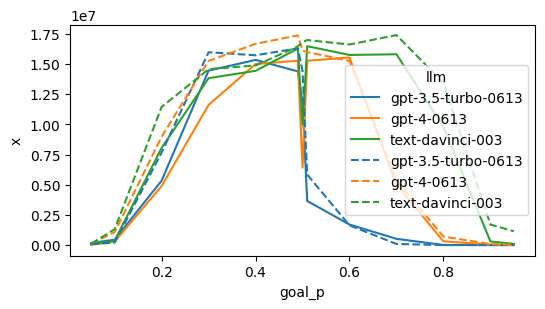

In [151]:
df_sub1_ = df_sub1[(df_sub1['llm'].isin(llms_short)) & \
                   (df_sub1['model'].isin(['llm', 'Bernoulli'])) & \
                   (df_sub1['window_size'] == 20)]

df_sub1_ = df_sub1_.groupby(['goal_p', 'window_size', 'llm', 'model'], as_index=False).aggregate(sum)


sns.lineplot(
    data=df_sub1_[df_sub1_['model'] == 'llm'], x="goal_p", y="x", hue="llm", 
)

sns.lineplot(
    data=df_sub1_[df_sub1_['model'] == 'Bernoulli'], x="goal_p", y="x", hue="llm", ls='--' 
)

# solid line is model flips
# dotted line is bernoulli fit to model   -- note that most chat-GPT weirdness is explained by p(Tails) bias

##### compare LLMs

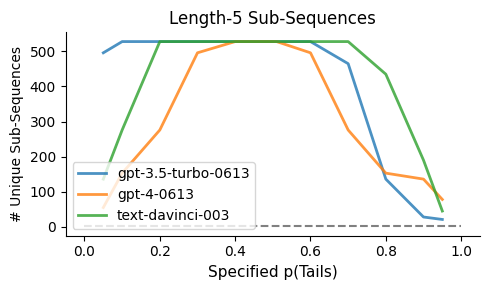

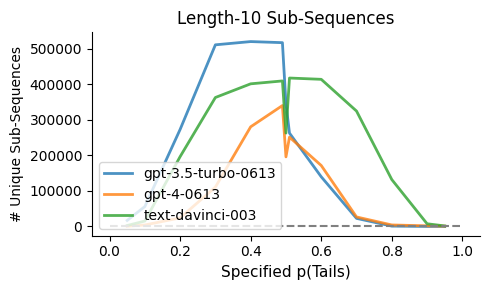

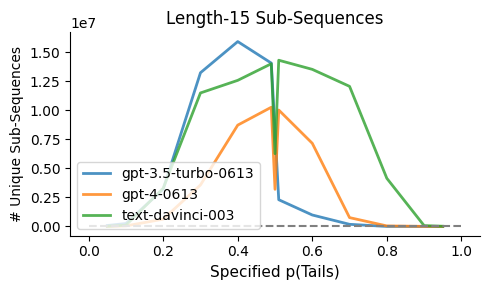

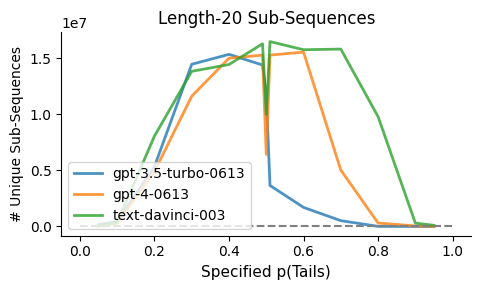

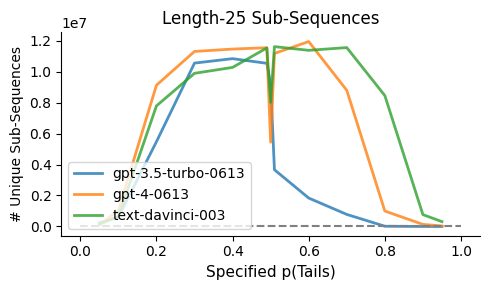

In [155]:
plt.rcParams['figure.figsize'] = (5, 3)
for window_size in [5, 10, 15, 20, 25]:

    df_sub1_ = df_sub1[(df_sub1['llm'].isin(llms_short)) & \
                       (df_sub1['window_size'] == window_size)]
    
    df_sub1_ = df_sub1_.groupby(['goal_p', 'window_size', 'llm', 'model'], as_index=False).aggregate('sum')
    
    df_sub1_.sort_values(by=['goal_p', 'window_size', 'llm', 'model'], inplace=True)
    
    
    ###df_sub1_.loc[df_sub1_['model'] == 'llm', 'x'] = df_sub1_.loc[df_sub1_['model'] == 'llm', 'x'].to_numpy()  / df_sub1_.loc[df_sub1_['model'] == 'Bernoulli', 'x'].to_numpy()
    df_sub1_ = df_sub1_[df_sub1_['model'] == 'llm']
    
    sns.lineplot(
        data=df_sub1_, x="goal_p", y="x", hue="llm", 
        # palette=[c_bern, 'purple', c_mc, c_gpt], 
        lw=2, alpha=.8
    )
    plt.hlines(y=1, xmin=0, xmax=1, ls='--', color='grey')
    # plt.ylim(0, 2)
    plt.xlabel('Specified p(Tails)', fontsize=11)
    # plt.ylabel('Normalized # Unique Sub-Sequences', fontsize=10)
    plt.ylabel('# Unique Sub-Sequences', fontsize=10)
    # plt.yscale('log')
    plt.title(f'Length-{window_size} Sub-Sequences')
    plt.legend(loc = 'lower left');
    # if window_size == 20:
    # else:
    #     plt.gca().get_legend().remove()
        
    
    plt.tight_layout()
    sns.despine()
    # plt.savefig(f'imgs/fig_subs-p_w={window_size}.pdf')
    # plt.savefig(f'imgs/fig_subs-p_w={window_size}-ratio.pdf')
    plt.show()

##### What are the most-repeated substrings?

In [25]:
sub_dict = defaultdict(lambda: defaultdict(dict))
for row in llm_sub_res:
    sub_dict[row['llm']][row['model']][row['goal_p']] = row['subs']

In [41]:
dd = sub_dict['text-davinci-003']['llm'][.51][20]
print(f'total number: {sum(dd.values())}')
sorted([(k, v) for k, v in dd.items()], key=lambda x: -x[1])[:10]

total number: 5850


[('10101010101010101010', 15),
 ('01010101010101010101', 15),
 ('10101000101010001010', 4),
 ('01010001010100010101', 4),
 ('10100010101000101010', 4),
 ('01000101010001010100', 4),
 ('10001010100010101000', 4),
 ('00010101000101010001', 4),
 ('10100100101001001010', 4),
 ('01001001010010010100', 4)]

In [42]:
# p=.50 leads to a huge bias to repeat (01)^n, and other sub-strings
dd = sub_dict['text-davinci-003']['llm'][.50][20]
print(f'total number: {sum(dd.values())}')
sorted([(k, v) for k, v in dd.items()], key=lambda x: -x[1])[:10]

total number: 5820


[('10101010101010101010', 180),
 ('01010101010101010101', 180),
 ('01010010100101001010', 70),
 ('01001010010100101001', 69),
 ('10010100101001010010', 69),
 ('10100101001010010100', 67),
 ('00101001010010100101', 67),
 ('10011001100110011001', 17),
 ('00110011001100110011', 14),
 ('01100110011001100110', 14)]

### Draw Markov chain diagrams, e.g. k=3

Note: this is the same as the diagram [in Andrej Karpathy's tweet](https://twitter.com/karpathy/status/1645115622517542913), except with nodes organized more like a group, and edge thickness representing transition probability. Also Andrej's MCs are fit to small NNs trained from scratch.

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ llm
p(Tails): 0.9


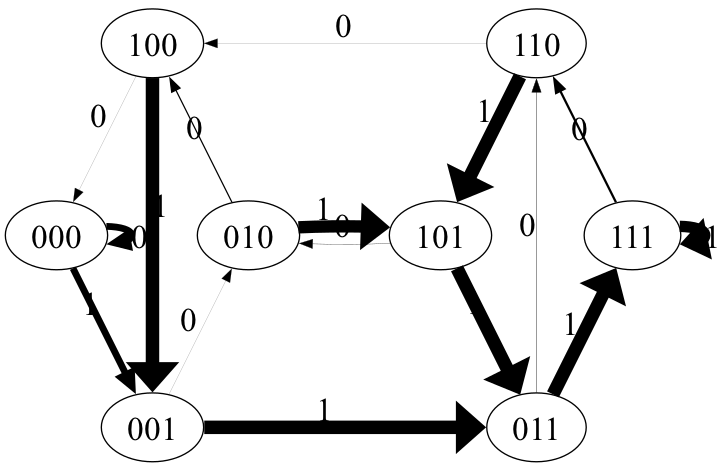

p(Tails): 0.51


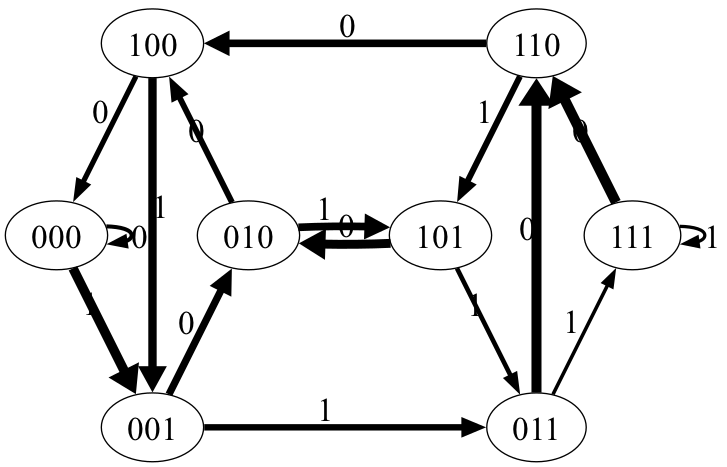

p(Tails): 0.1


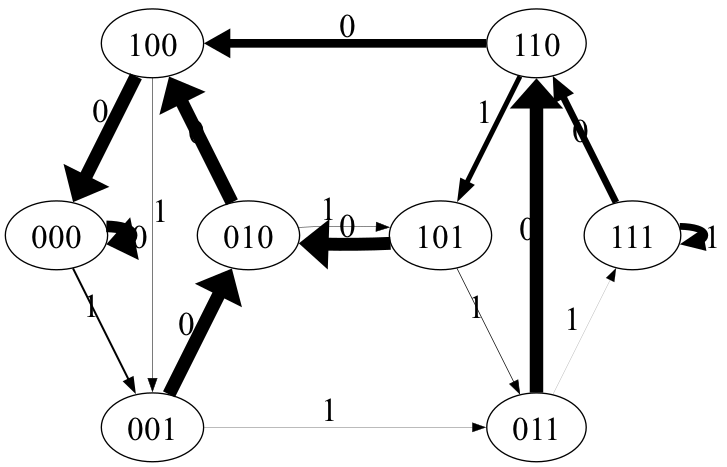

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ Bernoulli
p(Tails): 0.9


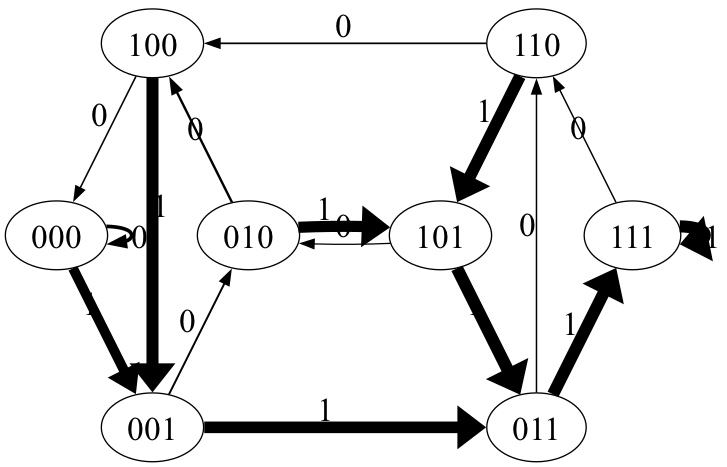

p(Tails): 0.51


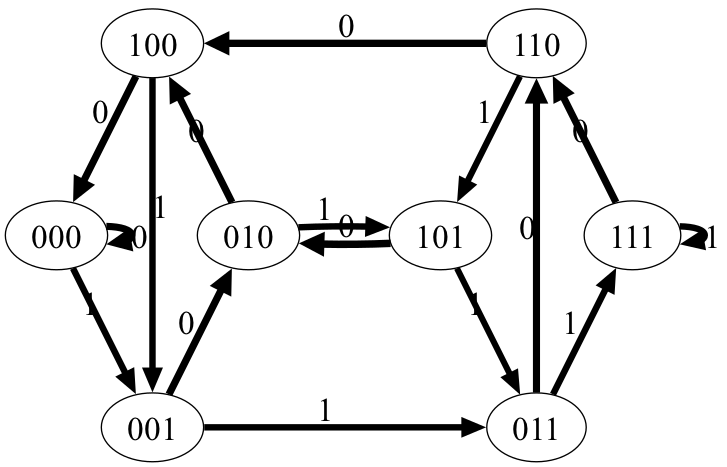

p(Tails): 0.1


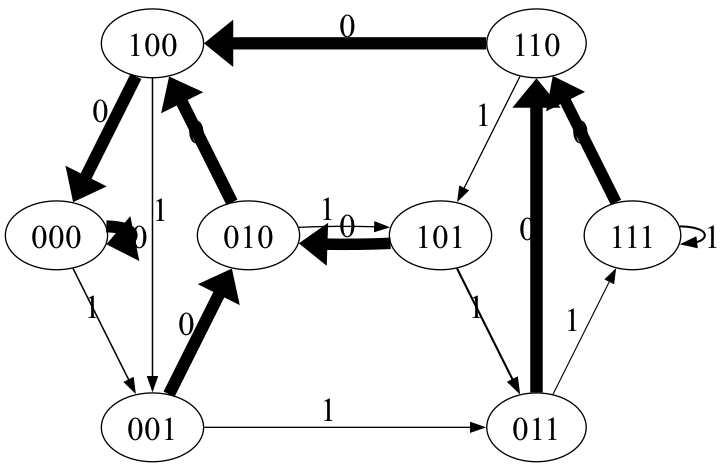

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ window-5
p(Tails): 0.9


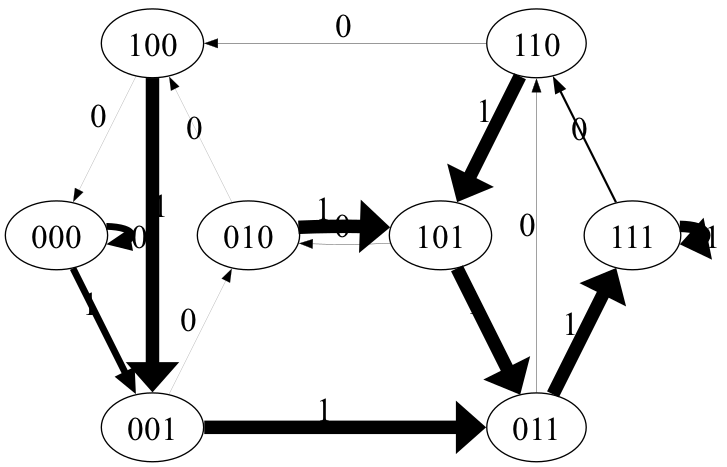

p(Tails): 0.51


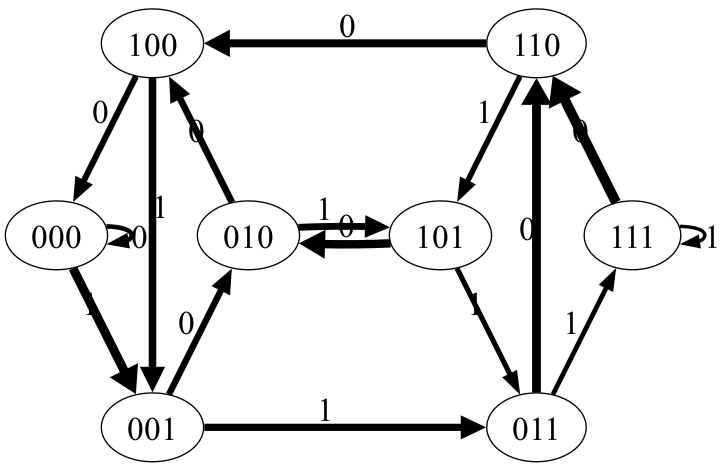

p(Tails): 0.1


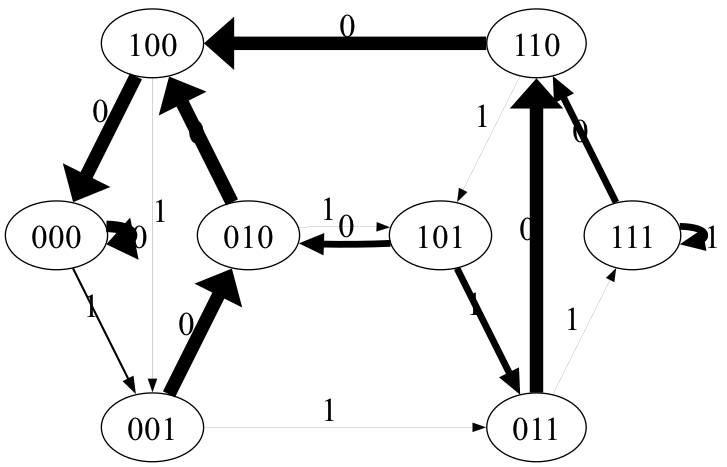

In [15]:
llm = 'text-davinci-003'
df__ = dff[dff.llm == llm].copy()

for j, model in enumerate(['llm', 'Bernoulli', 'window-5']):
    print('~' * 80, model)

    for i, p_heads in enumerate([10, 49, 90]):
        goal_p = round(1 - (p_heads / 100), 3)
        p_tails = 100 - p_heads
        print(f'p(Tails): {goal_p}')
        df___ = df__[(df__.goal_p == goal_p) & (df__.model == model)]

        flips_list = df___['flips'].tolist()
        flips_list = [[int(c) for c in s] for s in flips_list]
        
        fig = draw_MC(pomegranate.MarkovChain.from_samples(flips_list, k=3), k=3, edge_min=.1, edge_mult=10, edge_pow=1, img_format='png')
        fig.width = 300
        # with open(f'imgs/fig_MC-{model}-{p_tails}.pdf', 'wb') as f:
        #     f.write(fig.data)
        display(fig)

# Part 2: randomness vs. program induction with simple formal language learning

## 2a: Randomness generation + formal language learning

### ICL learning curves

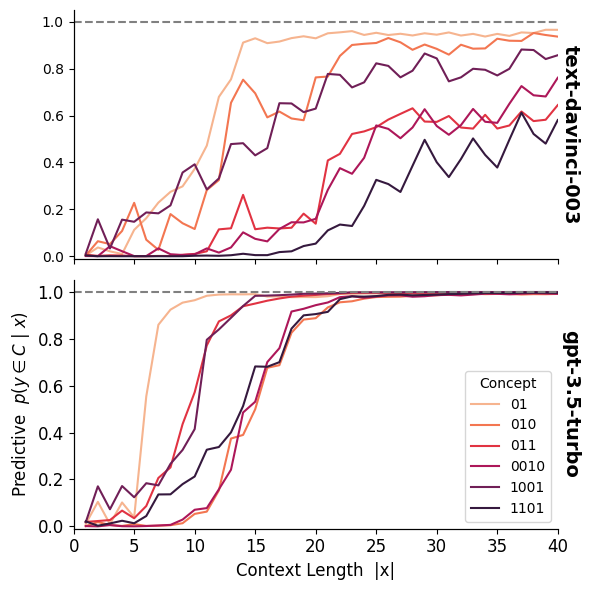

In [21]:
plt.rcParams['figure.figsize'] = (6, 6)


df__ = df_fl[(df_fl.depth == 6)]
df__ = df__[df__.llm.isin(['text-davinci-003', 'gpt-3.5-turbo-instruct-0914'])]

for i, llm in enumerate(['text-davinci-003', 'gpt-3.5-turbo-instruct-0914']):
    plt.subplot(2, 1, i+1)
    sns.lineplot(data=df__[df__.llm == llm], x='x_len', y='prob', hue='concept',
                 palette=sns.color_palette("rocket_r", n_colors=len(set(df__['concept'])) ))


    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys(), loc='lower right')

    if i == 0:
        plt.xlabel(None)
        plt.ylabel(None)
        plt.xticks(list(range(0, 45, 5)), [])
        plt.gca().get_legend().remove()
        
    if i == 1:
        plt.xlabel('Context Length  |x|', fontsize=12)
        plt.ylabel('Predictive  $p(y \in C \ | \ x)$', fontsize=12)
        plt.gca().tick_params(axis='both', which='major', labelsize=12)
        plt.legend(title='Concept', loc='lower right')
        
    llm = 'gpt-3.5-turbo' if 'instruct' in llm else llm
    plt.hlines(1.0, 0, 40, ls='--', color='grey')

    plt.xlim(0, 40)
    plt.ylim(-.01, 1.05)
    # plt.ylim(-.005, 1.005)
    twin = plt.gca().twinx()
    twin.set_ylabel(llm, rotation=-90, labelpad=16, weight='bold', fontsize=14)
    twin.set_yticks([])
    twin.tick_params(labelright='off')
    sns.despine()
    
plt.tight_layout()

# plt.savefig('imgs/fig_pathacc-xlen-new.pdf')
plt.show()

#### Alternate plot, with different prediction depths shown as different colored lines

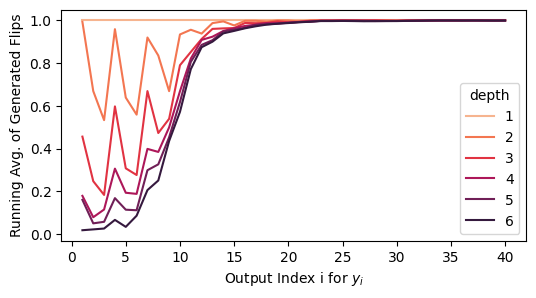

In [27]:
plt.rcParams['figure.figsize'] = (6, 3)


df__ = df_fl[(df_fl.concept == '011') & (df_fl.llm == 'gpt-3.5-turbo-instruct-0914')]

sns.lineplot(data=df__, x='x_len', y='prob', hue='depth',
             palette=sns.color_palette("rocket_r"))

plt.ylabel('Running Avg. of Generated Flips')
plt.xlabel('Output Index i for $y_i$');

In [36]:
df_fl['llm'] = df_fl['llm'].replace({'gpt-3.5-turbo-instruct-0914': 'gpt-3.5-turbo-instruct'})

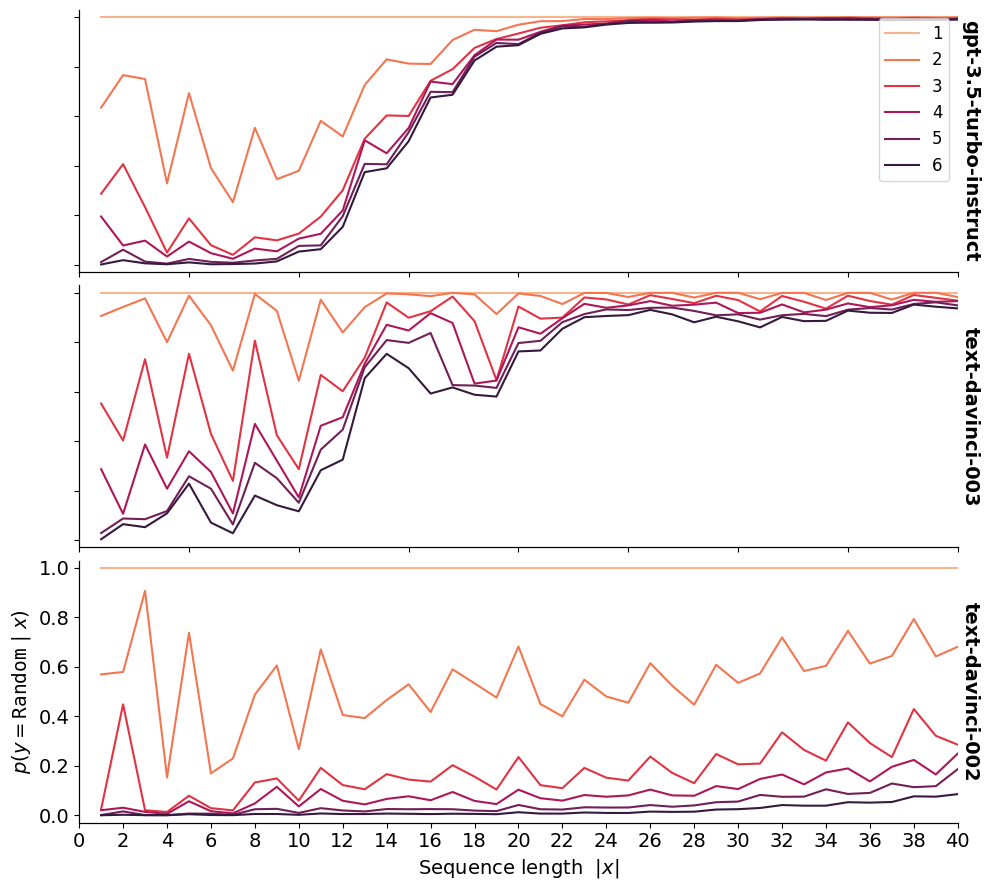

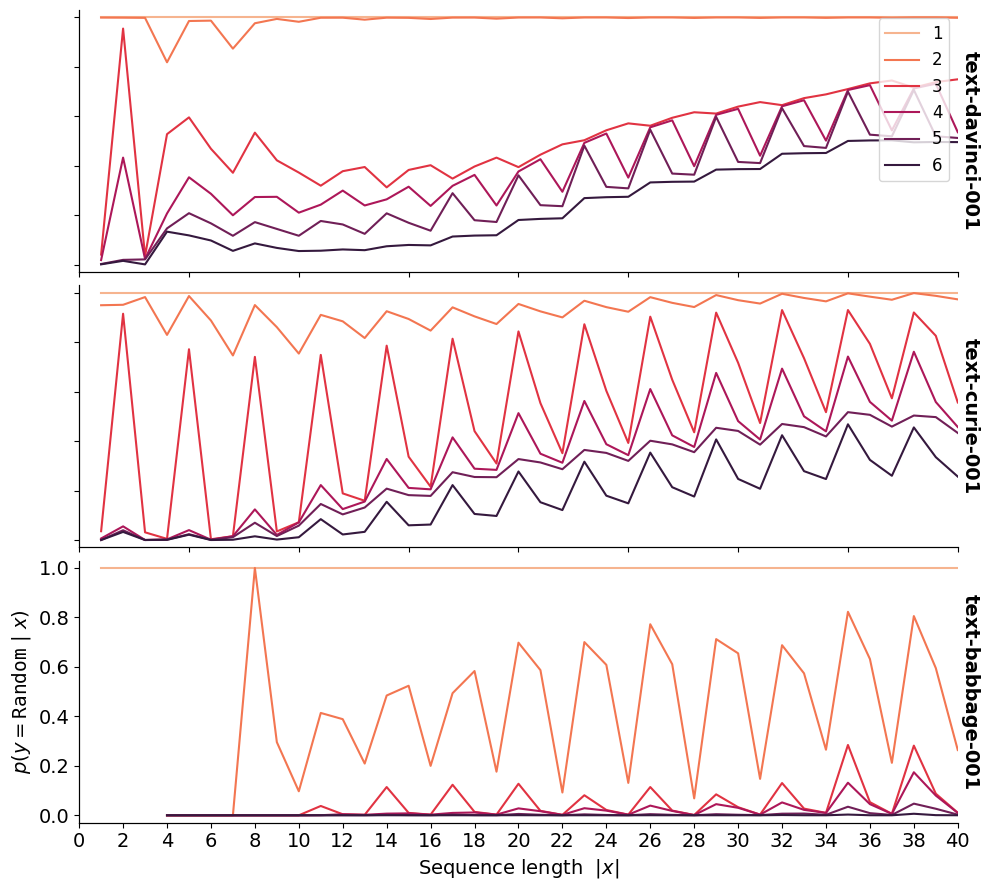

In [37]:
n_flips = 40
llm_groups = [
    [
        'gpt-3.5-turbo-instruct',
        'text-davinci-003', 
        'text-davinci-002', 
    ], [
        'text-davinci-001',
        'text-curie-001', 
        'text-babbage-001', 
        # 'text-ada-001'  
    ]
]

concept = '010'

for lg_i, lg in enumerate(llm_groups):
    plt.rcParams['figure.figsize'] = (10, 3 + len(lg) * 2)
    fig, axs = plt.subplots(len(lg), 1)
    for llm, ax in zip(lg, axs):

        df__ = df_fl[(df_fl.concept == concept) & (df_fl.llm == llm)]
        
        sns.lineplot(ax=ax, data=df__, x='x_len', y='prob', hue='depth',
                     palette=sns.color_palette("rocket_r"))

        ax.set_xlabel(None)
        twin = ax.twinx()
        twin.set_ylabel(llm, rotation=-90, labelpad=16, weight='bold', fontsize=14)
        twin.set_yticks([])
        twin.tick_params(labelright='off')
        if ax != axs[0]:
            try:
                ax.get_legend().remove()
            except:
                pass
        else:
            ax.legend(loc='upper right', fontsize=12)
        ax.set_ylim(-.03, 1.03)
        ax.set_xlim(0, 40)
            
    
    sns.despine(right=True, top=True)
    
    axs[0].set_xticklabels([])
    axs[1].set_xticklabels([])
    axs[-2].set_xticklabels([])
    axs[0].set_yticklabels([])
    axs[1].set_yticklabels([])
    axs[-2].set_yticklabels([])
    axs[0].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[1].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[2].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[-2].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[-1].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[0].set_ylabel(None)
    axs[1].set_ylabel(None)
    axs[-2].set_ylabel(None)
    axs[-1].set_ylabel('Running Avg. of Generated Flips')
    axs[-1].set_xlabel('Output Index i for $y_i$')

    axs[-1].set_ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
    axs[-1].set_xlabel('Sequence length  $|x|$', fontsize=14)
    axs[-1].tick_params(axis='both', which='major', labelsize=14)
    
    plt.tight_layout()
    plt.subplots_adjust(hspace=.05)
        
    plt.xticks(list(range(0, n_flips+1, n_flips//20)))
    # plt.savefig(f'imgs/fig_fll-lg{lg_i}-{concept}.pdf')
    plt.show()

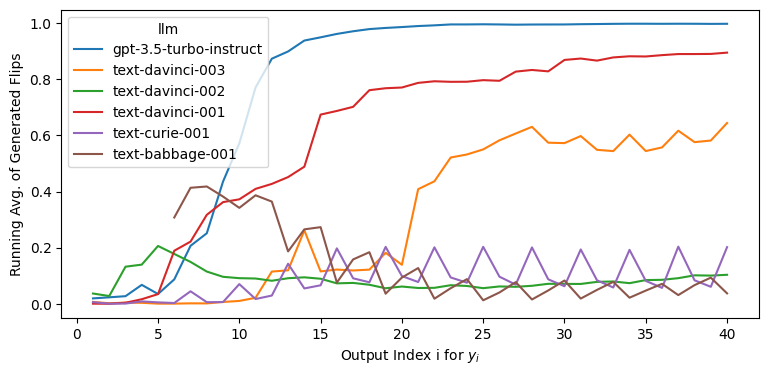

In [38]:
plt.rcParams['figure.figsize'] = (9, 4)


df__ = df_fl[(df_fl.depth == 6) & (df_fl.concept == '011')]

sns.lineplot(data=df__, x='x_len', y='prob', hue='llm')

plt.ylabel('Running Avg. of Generated Flips')
plt.xlabel('Output Index i for $y_i$')

plt.show()
# plt.savefig('imgs/fig_pathacc-xlen-all.pdf')

### red/blue trees

#### plot one big tree

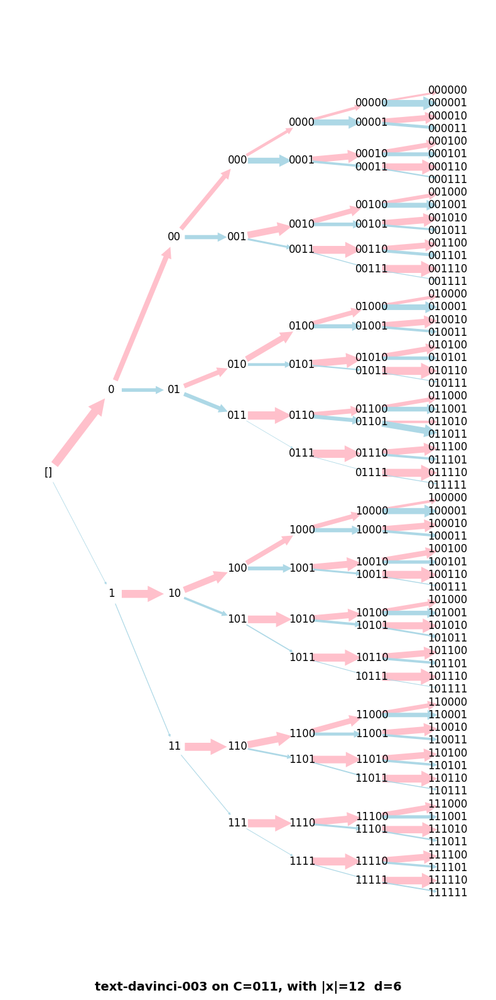

In [34]:
llm = 'text-davinci-003'
concept = (0, 1, 1)
x_len = 12
depth = 6

res_tree = res_gen_trees_all[llm][concept][x_len]
draw_flips(res_tree, depth=depth, 
           fig_size=(8, 16), show=False)

sns.despine(bottom=True, left=True)
concept_str = ''.join([str(i) for i in concept])
plt.xlabel(f'{llm} on C={concept_str}, with |x|={x_len}  d={depth}', fontsize=14, weight='bold')
plt.tight_layout()
# plt.savefig(f'imgs/fig_btree-{llm}_{concept_str}_{x_len}-{depth}.pdf', bbox_inches='tight')
plt.show()

/var/folders/41/_ql36yd95wq0zy1_ml3g0g2w0000gn/T/ipykernel_16720/2129082420.py:43: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  arrows = nx.draw_networkx_edges(


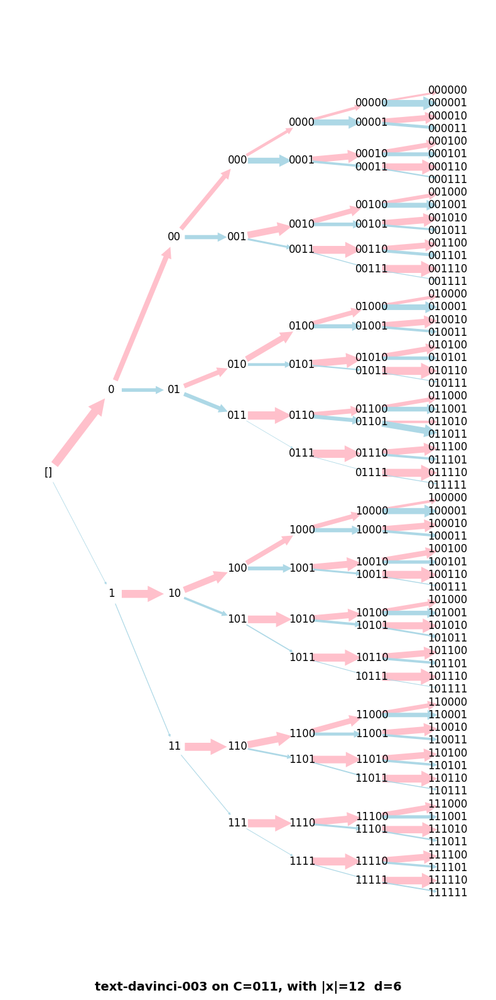

In [40]:
llm = 'text-davinci-003'
concept = (0, 1, 1)
x_len = 12
depth = 6

res_tree = res_gen_trees_all[llm][concept][x_len]  # llm_trees[llm][concept][x_len][depth]
draw_flips(res_tree, depth=depth, 
           fig_size=(8, 16), show=False)

sns.despine(bottom=True, left=True)
concept_str = ''.join([str(i) for i in concept])
plt.xlabel(f'{llm} on C={concept_str}, with |x|={x_len}  d={depth}', fontsize=14, weight='bold')
plt.tight_layout()
# plt.savefig(f'imgs/fig_btree-{llm}_{concept_str}_{x_len}-{depth}.pdf', bbox_inches='tight')
plt.show()

#### plots for 2 concepts, for 3 best llms

/var/folders/41/_ql36yd95wq0zy1_ml3g0g2w0000gn/T/ipykernel_16720/2129082420.py:43: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  arrows = nx.draw_networkx_edges(


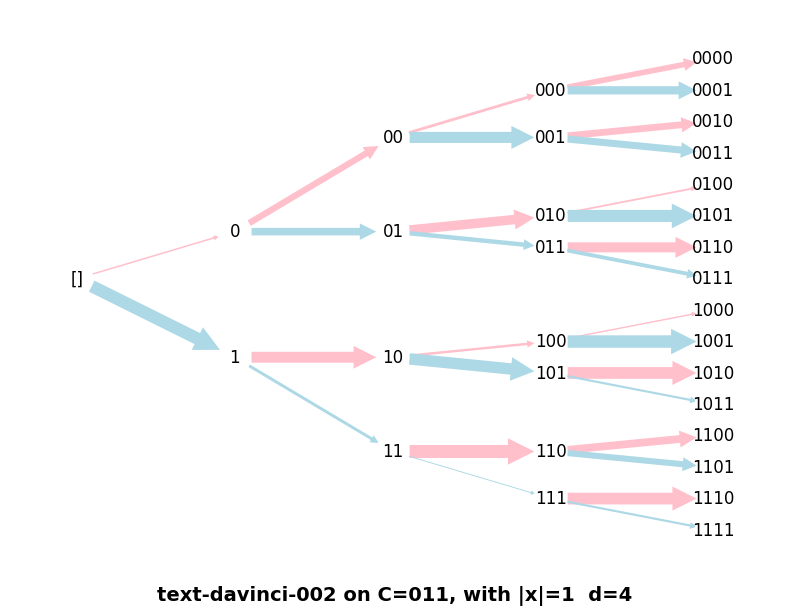

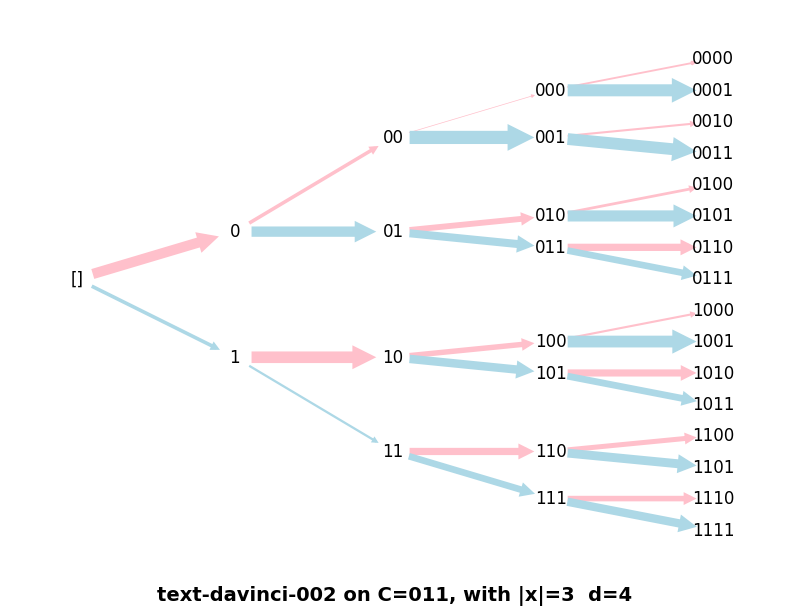

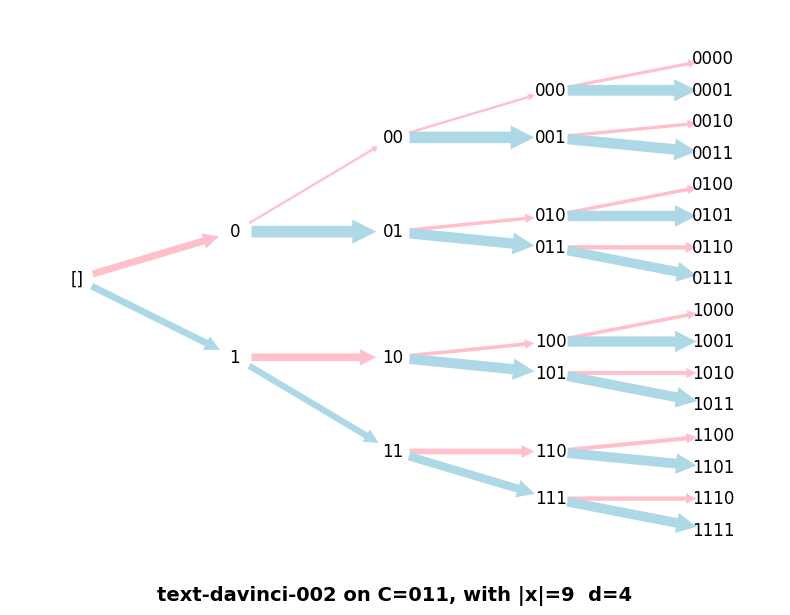

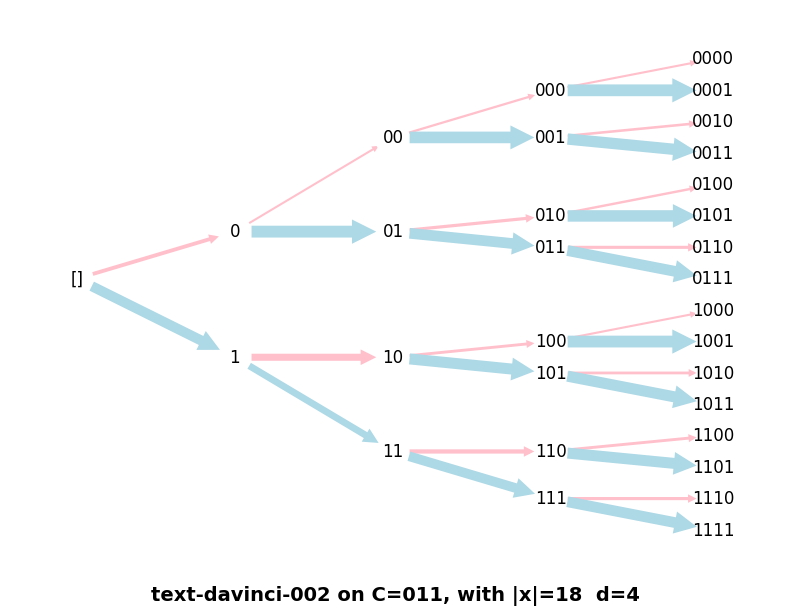

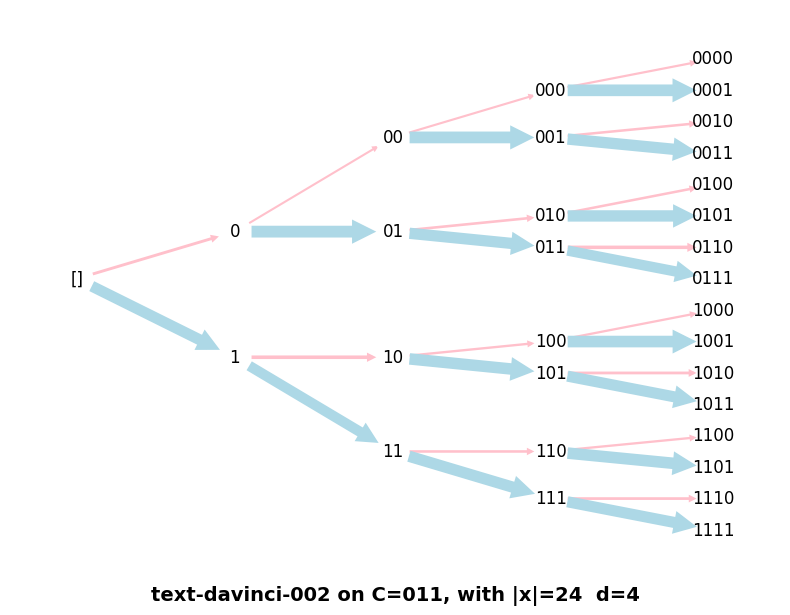

...

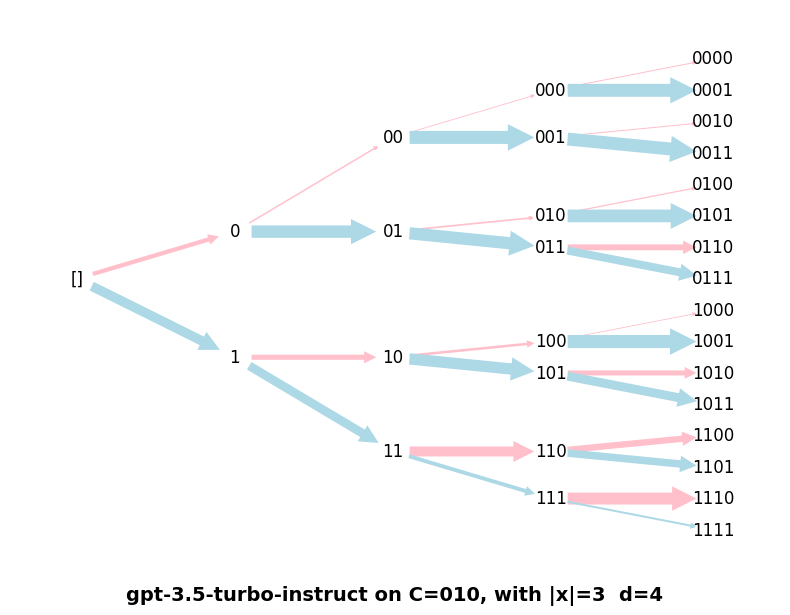

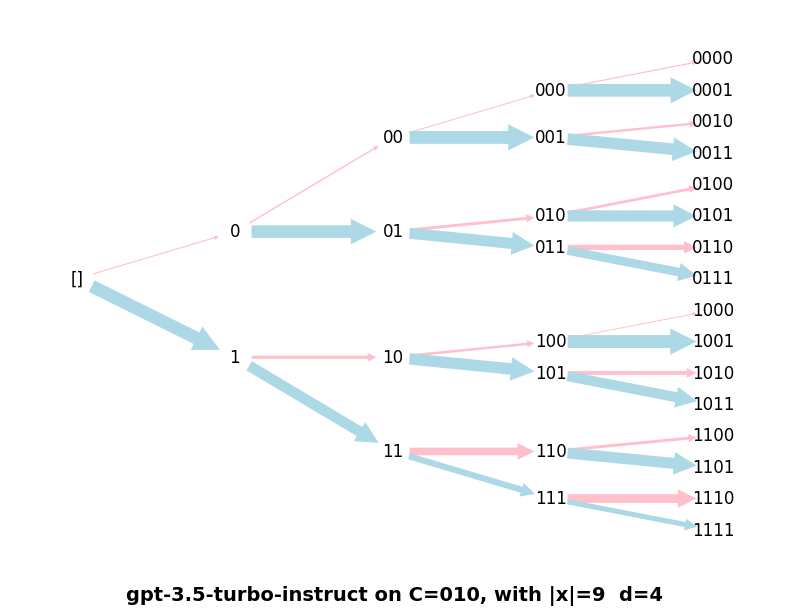

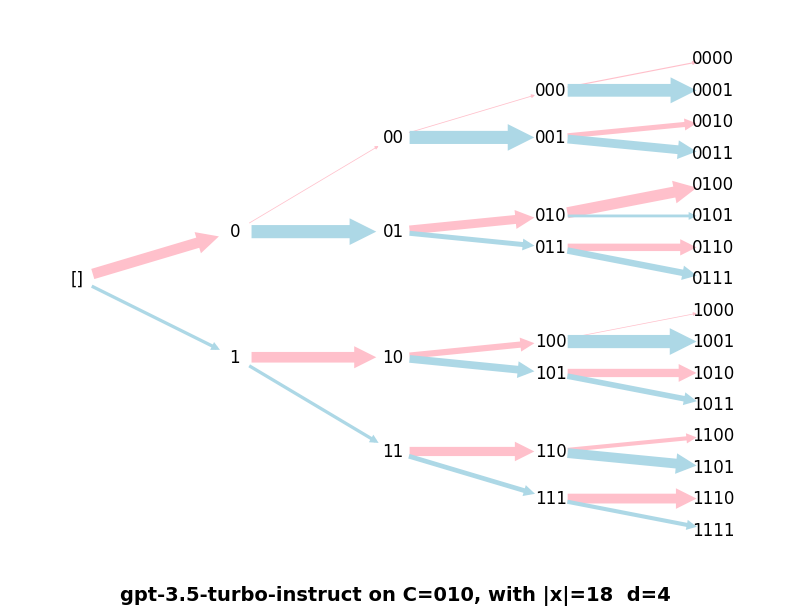

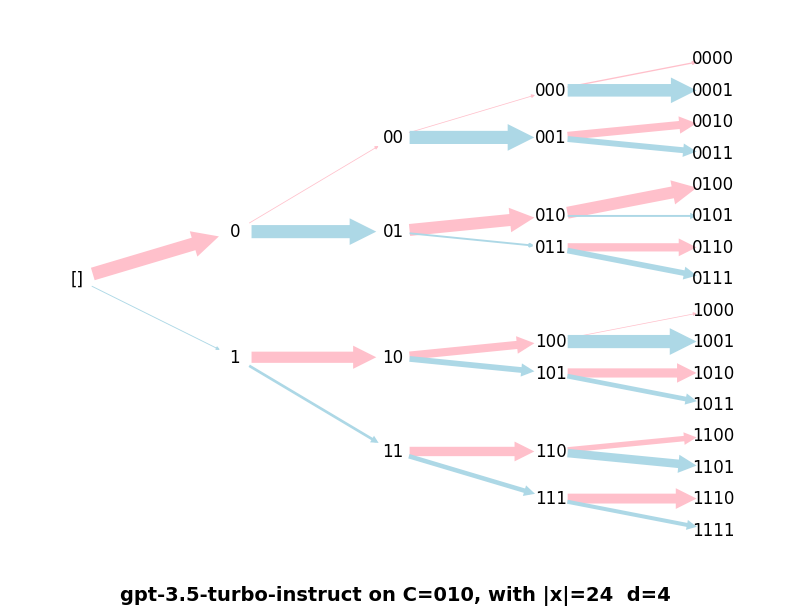

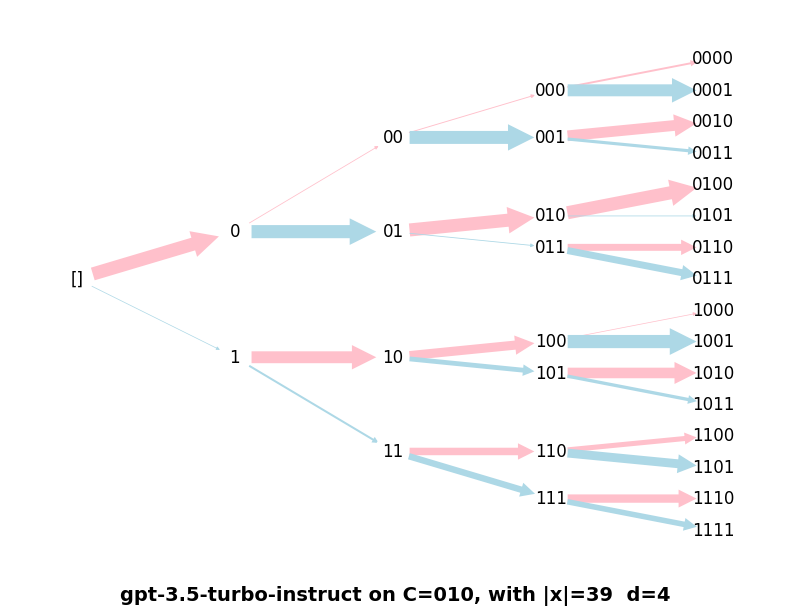

In [41]:
depth = 4
fig_size = (8, 6)

for llm in ['text-davinci-002', 'text-davinci-003', 'gpt-3.5-turbo-instruct']:
    for concept in [(0, 1, 1), (0, 1, 0)]:
        for x_len in [1, 3, 9, 18, 24, 39]:
            
            res_tree = res_gen_trees_all[llm][concept][x_len]
            draw_flips(res_tree, depth=depth, 
                       fig_size=fig_size, show=False)
            
            sns.despine(bottom=True, left=True)
            concept_str = ''.join([str(i) for i in concept])
            plt.tight_layout()
            plt.xlabel(f'{llm} on C={concept_str}, with |x|={x_len}  d={depth}', fontsize=14, weight='bold')
            # plt.savefig(f'imgs/fig_btree-{llm}_{concept_str}_{x_len}-{depth}.pdf', bbox_inches='tight')       # Note: use show=False if saving
            plt.show()

## 2b: Randomness judgment  - p(random | x)

In [43]:
p_judge

'Q: Is the following sequence of coin flips generated by a random process with no pattern, or are they generated by a non-random algorithm? [{flips}]\n\nA: The sequence was generated by a'

In [44]:
n_flips = 100

concept_groups = [
    [
        (0, 1),
        (0, 1, 0),
        (0, 1, 1),
    # ],
    # [
        (0, 1, 1, 0),
        (0, 1, 1, 1),
    ],
    [
        (0, 0, 0, 0, 1),
        (0, 0, 1, 0, 1),
    # ],
    # [
        (1, 0, 1, 0, 1),
        (1, 1, 1, 0, 0)
    ]
]

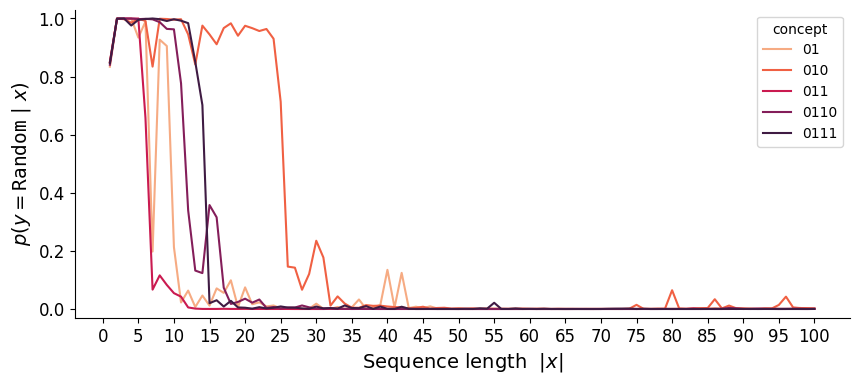

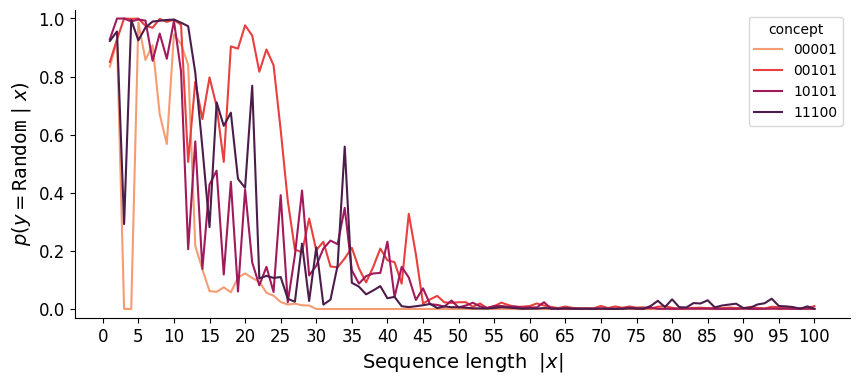

In [47]:
plt.rcParams['figure.figsize'] = (10, 4)

res_juds = res_jud_all['text-davinci-003']

for cg_i, cg in enumerate(concept_groups):
    rows = []
    for concept, res_jud in res_juds.items():
        if concept in cg:
            x = list(range(1, n_flips+1))
            y = [get_token_prob(r, ['n', 'r']) for r in res_jud]
            con_str = ''.join([str(i) for i in concept])
            rows += [{'len_x': x_, 'p_random': y_, 'concept': con_str} for x_, y_ in zip(x, y)]
        
    # sns.lineplot(data=pd.DataFrame(rows), x="len_x", y="p_random", ci=95)
    sns.lineplot(data=pd.DataFrame(rows), x="len_x", y="p_random", hue='concept', palette=sns.color_palette('rocket_r', n_colors=len(cg)))   #, ci=95, estimator=np.median)
    plt.xticks(list(range(0, n_flips+1, n_flips//20)))
    
    plt.ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
    plt.xlabel('Sequence length  $|x|$', fontsize=14)
    plt.gca().tick_params(axis='both', which='major', labelsize=12)
   
    plt.ylim(-.03, 1.03)
    plt.yticks([0, .2, .4, .6, .8, 1.])
    sns.despine(right=True, top=True)
    
    # plt.savefig(f'imgs/fig_judge-{cg_i}.pdf', bbox_inches="tight")
    plt.show()

#### longer concepts  - with long enough concepts the pattern starts to degrade

note: we only have data for long concepts with text-davinci-003

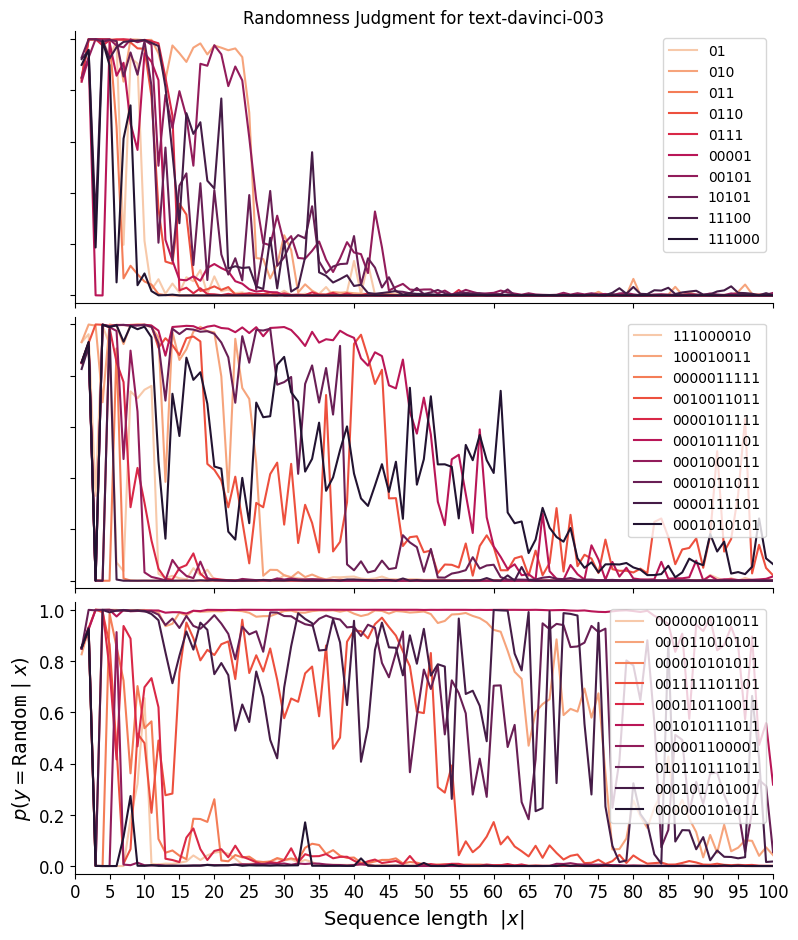

In [23]:
llm = 'text-davinci-003'
res_juds = res_jud_long[llm]

concepts = list(res_juds.keys())
concept_groups = [
    [c for c in concepts if len(c) <= 8],
    [c for c in concepts if 12 > len(c) > 8],
    [c for c in concepts if len(c) >= 12],
]

plt.rcParams['figure.figsize'] = (8, 3 + len(concept_groups) * 2)
fig, axs = plt.subplots(len(concept_groups), 1)

max_n_concepts = 10

for cg_i, cg in enumerate(concept_groups):
    ax = axs[cg_i]
    rows = []
    n_concepts = 0
    
    for concept, res_jud in sorted(res_juds.items(), key=lambda x: len(x[0])):
        if concept in cg and n_concepts < max_n_concepts:
            x = list(range(1, n_flips+1))
            y = [get_token_prob(r, ['n', 'r']) for r in res_jud]
            con_str = ''.join([str(i) for i in concept])
            rows += [{'len_x': x_, 'p_random': y_, 'concept': con_str} for x_, y_ in zip(x, y)]
            n_concepts += 1
        
    # sns.lineplot(data=pd.DataFrame(rows), x="len_x", y="p_random", ci=95)
    cdf = pd.DataFrame(rows)
    sns.lineplot(ax=ax, data=cdf, x="len_x", y="p_random", hue='concept', palette=sns.color_palette('rocket_r', n_colors=len(set(cdf.concept))))   #, ci=95, estimator=np.median)
    ax.set_xlabel(None)
    ax.legend(loc='upper right')
    ax.set_ylim(-.03, 1.03)
    ax.set_xlim(0, 100)
        

sns.despine(right=True, top=True)

axs[0].set_xticklabels([])
axs[1].set_xticklabels([])
axs[0].set_yticklabels([])
axs[1].set_yticklabels([])
axs[0].set_yticks([0, .2, .4, .6, .8, 1.])
axs[1].set_yticks([0, .2, .4, .6, .8, 1.])
axs[-1].set_yticks([0, .2, .4, .6, .8, 1.])
axs[0].set_ylabel(None)
axs[1].set_ylabel(None)
plt.gca().tick_params(axis='both', which='major', labelsize=12)

plt.tight_layout()
plt.subplots_adjust(hspace=.05)

axs[0].set_title(f'Randomness Judgment for {llm}')
plt.xticks(list(range(0, n_flips+1, n_flips//20)))
plt.ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
plt.xlabel('Sequence length  $|x|$', fontsize=14)
plt.gca().tick_params(axis='both', which='major', labelsize=12)

###plt.savefig(f'imgs/fig_judge-{llm}-sm-cg.pdf')
plt.show()

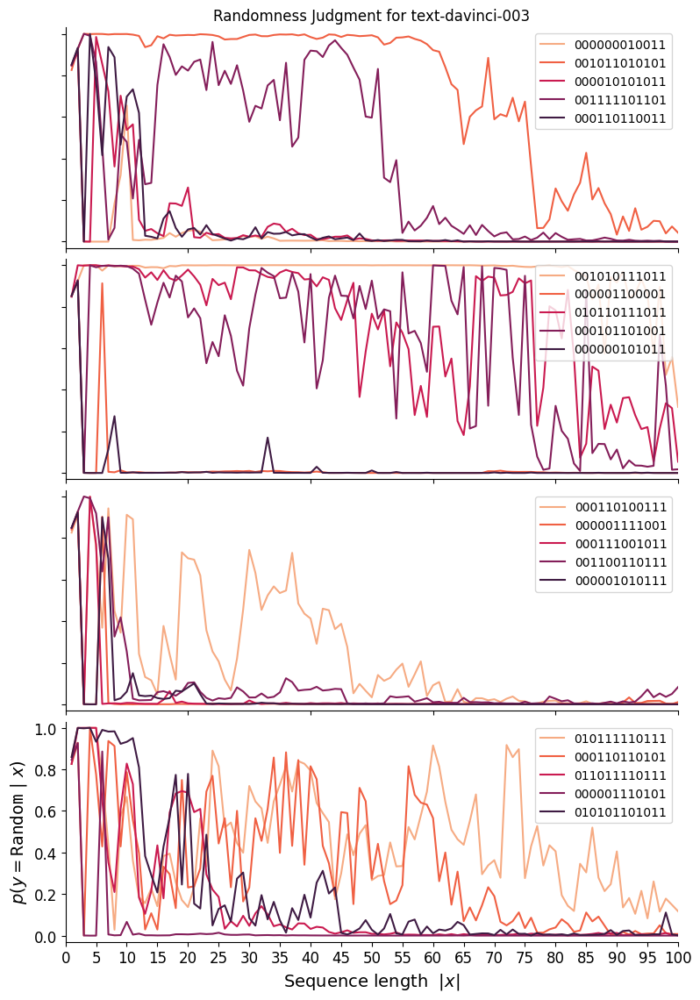

In [108]:
llm = 'text-davinci-003'
res_juds = res_jud_long[llm]

concept_len = 12
concepts = [c for c in list(res_juds.keys()) if len(c) == concept_len]

concept_groups = [
    concepts[:5],
    concepts[5:10],
    concepts[10:15],
    concepts[15:20],
]


plt.rcParams['figure.figsize'] = (8, 3 + len(concept_groups) * 2)
fig, axs = plt.subplots(len(concept_groups), 1)

for cg_i, cg in enumerate(concept_groups):
    ax = axs[cg_i]
    rows = []
    for concept, res_jud in res_juds.items():
        if concept in cg:
            x = list(range(1, n_flips+1))
            y = [get_token_prob(r, ['n', 'r']) for r in res_jud]
            con_str = ''.join([str(i) for i in concept])
            rows += [{'len_x': x_, 'p_random': y_, 'concept': con_str} for x_, y_ in zip(x, y)]
        
    sns.lineplot(ax=ax, data=pd.DataFrame(rows), x="len_x", y="p_random", hue='concept', palette=sns.color_palette('rocket_r', n_colors=len(cg)))
    
    ax.set_xlabel(None)
    ax.legend(loc='upper right')
    ax.set_ylim(-.03, 1.03)
    ax.set_xlim(0, 100)
        

sns.despine(right=True, top=True)

axs[0].set_xticklabels([])
axs[1].set_xticklabels([])
axs[2].set_xticklabels([])
axs[0].set_yticklabels([])
axs[1].set_yticklabels([])
axs[2].set_yticklabels([])
axs[0].set_yticks([0, .2, .4, .6, .8, 1.])
axs[1].set_yticks([0, .2, .4, .6, .8, 1.])
axs[2].set_yticks([0, .2, .4, .6, .8, 1.])
axs[-1].set_yticks([0, .2, .4, .6, .8, 1.])
axs[0].set_ylabel(None)
axs[1].set_ylabel(None)
axs[2].set_ylabel(None)
plt.gca().tick_params(axis='both', which='major', labelsize=12)

plt.tight_layout()
plt.subplots_adjust(hspace=.05)

axs[0].set_title(f'Randomness Judgment for {llm}')
plt.xticks(list(range(0, n_flips+1, n_flips//20)))
plt.ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
plt.xlabel('Sequence length  $|x|$', fontsize=14)
plt.gca().tick_params(axis='both', which='major', labelsize=12)

# plt.savefig(f'imgs/fig_judge-{llm}-lencon={concept_len}.pdf')
plt.show()

#### mean judgment curve for each concept length $|x|$

In [98]:
# llm = 'gpt-3.5-turbo-instruct'
llm = 'text-davinci-003'
res_juds = res_jud_all[llm]

rows = []
for concept, res_jud in res_juds.items():
    x = list(range(1, n_flips+1))
    y = [get_token_prob(r, ['n', 'r']) for r in res_jud]
    con_str = ''.join([str(i) for i in concept])
    rows += [{'len_x': x_, 'p_random': y_, 'concept': con_str, 'len_concept': len(con_str)} for x_, y_ in zip(x, y)]

df_jud = pd.DataFrame(rows)

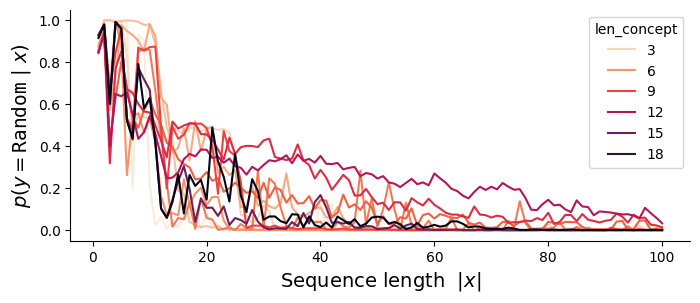

In [102]:
plt.rcParams['figure.figsize'] = (8, 3)
sns.lineplot(data=df_jud, x="len_x", y="p_random", hue='len_concept', errorbar=None, palette='rocket_r')
sns.despine(right=True, top=True)
plt.ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
plt.xlabel('Sequence length  $|x|$', fontsize=14)
plt.show()

#### Comparing different LLMs for shorter concepts

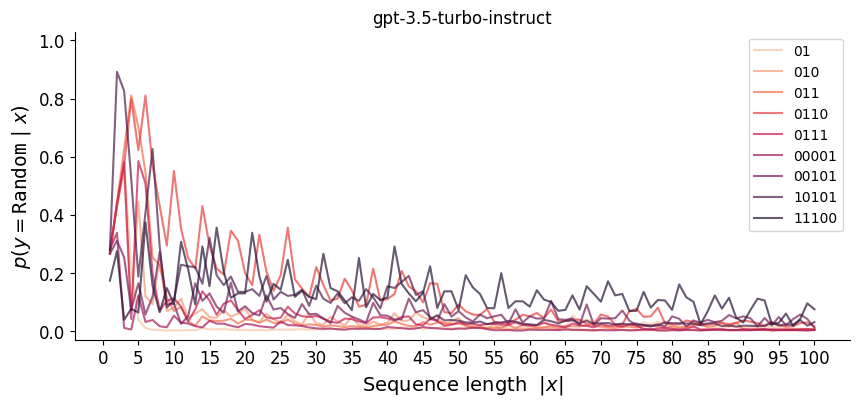

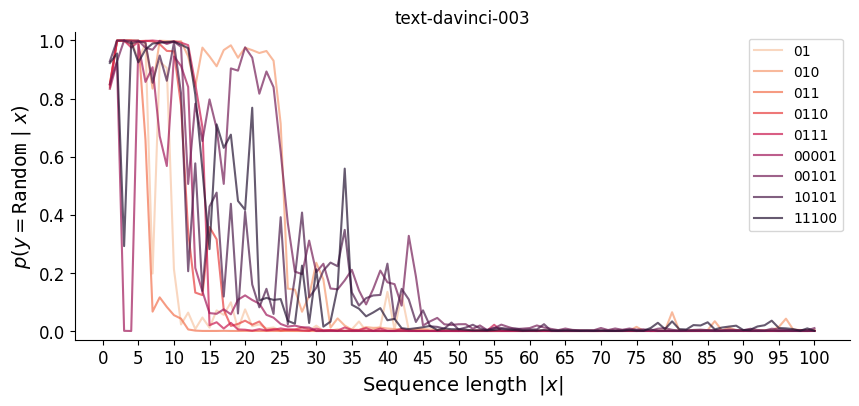

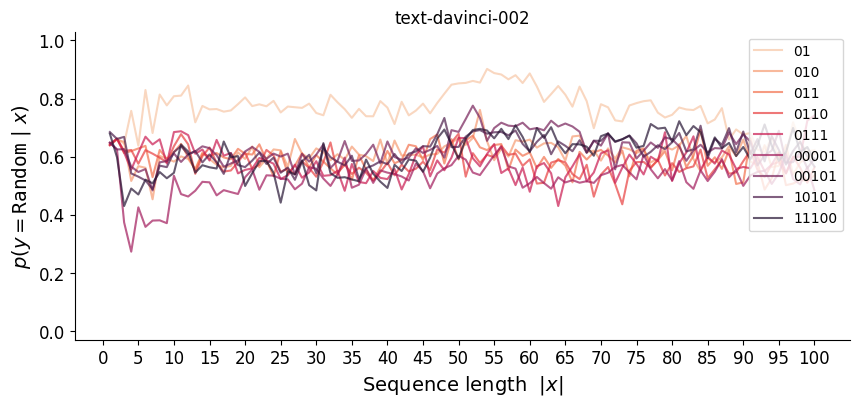

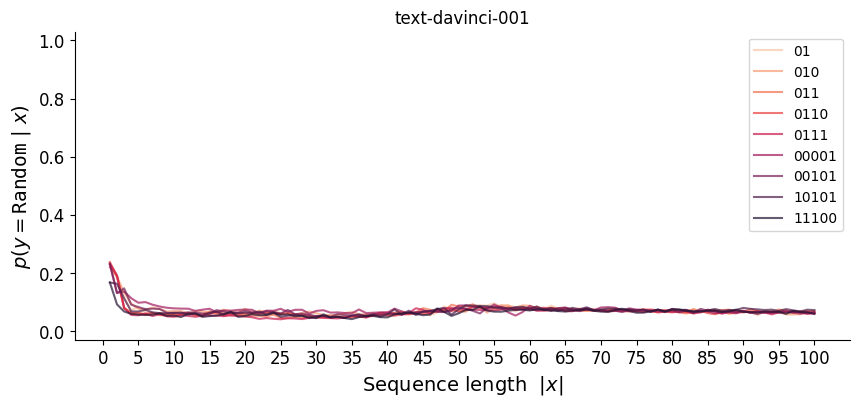

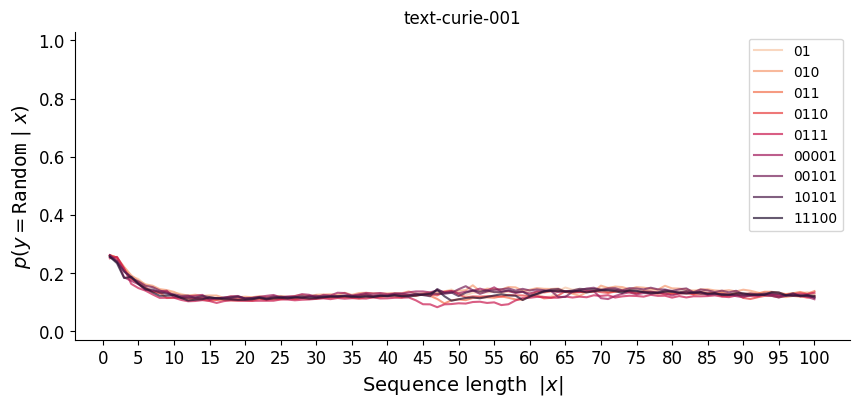

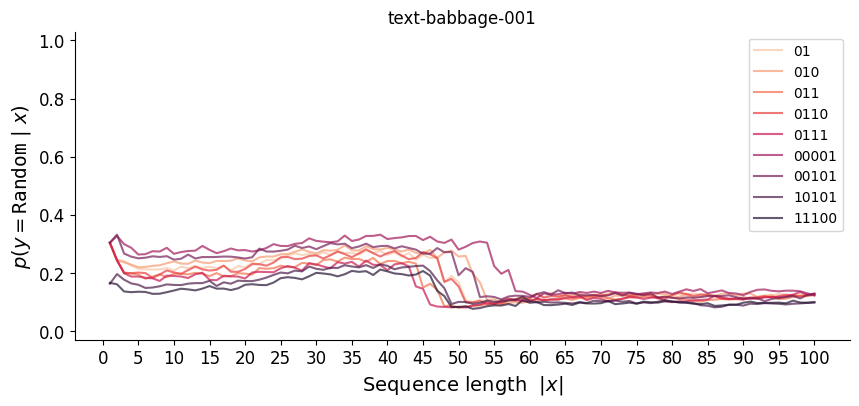

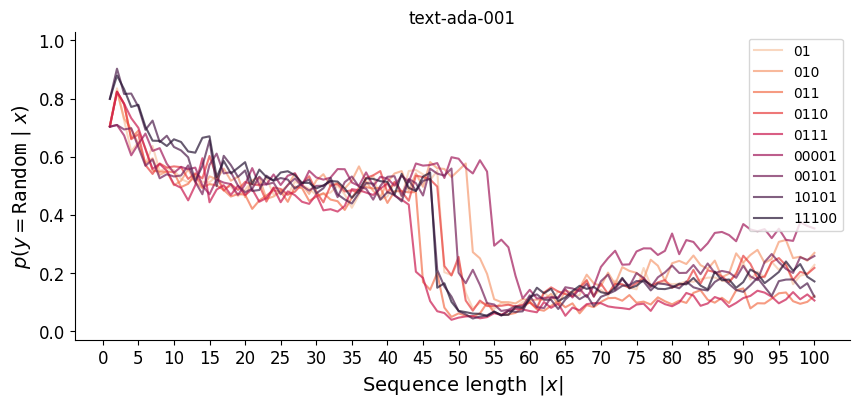

In [109]:
plt.rcParams['figure.figsize'] = (10, 4)

for llm, res_juds in res_jud_all.items():
    rows = []
    for concept, res_jud in res_juds.items():
        x = list(range(1, n_flips+1))
        y = [get_token_prob(r, ['n', 'r']) for r in res_jud]
        con_str = ''.join([str(i) for i in concept])
        rows += [{'len_x': x_, 'p_random': y_, 'concept': con_str} for x_, y_ in zip(x, y)]
        
    sns.lineplot(data=pd.DataFrame(rows), x="len_x", y="p_random", hue='concept', 
                 alpha=.7, palette=sns.color_palette('rocket_r', n_colors=len(res_juds)))
    plt.xticks(list(range(0, n_flips+1, n_flips//20)))
    
    plt.ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
    plt.xlabel('Sequence length  $|x|$', fontsize=14)
    plt.gca().tick_params(axis='both', which='major', labelsize=12)
    
    plt.ylim(-.03, 1.03)
    plt.yticks([0, .2, .4, .6, .8, 1.])
    plt.title(llm)
    plt.legend(loc='upper right')

    sns.despine()
    # plt.savefig(f'imgs/fig_judge-all-{llm}.pdf')
    plt.show()

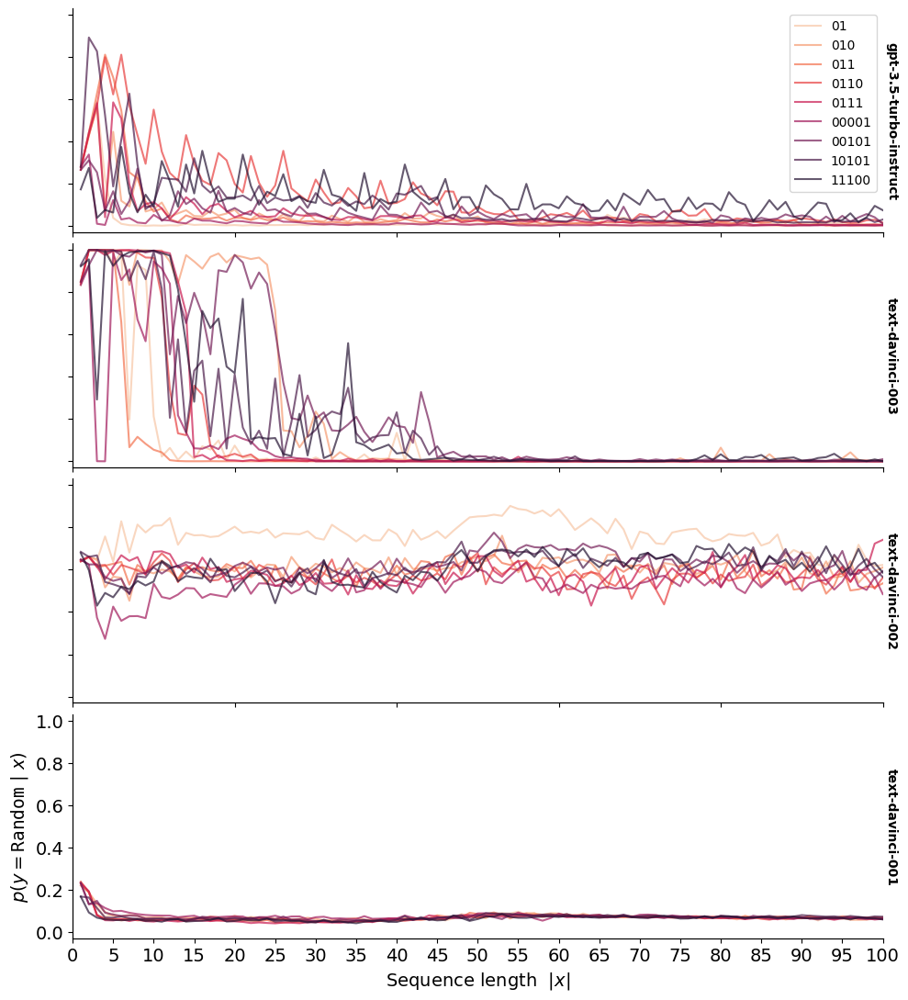

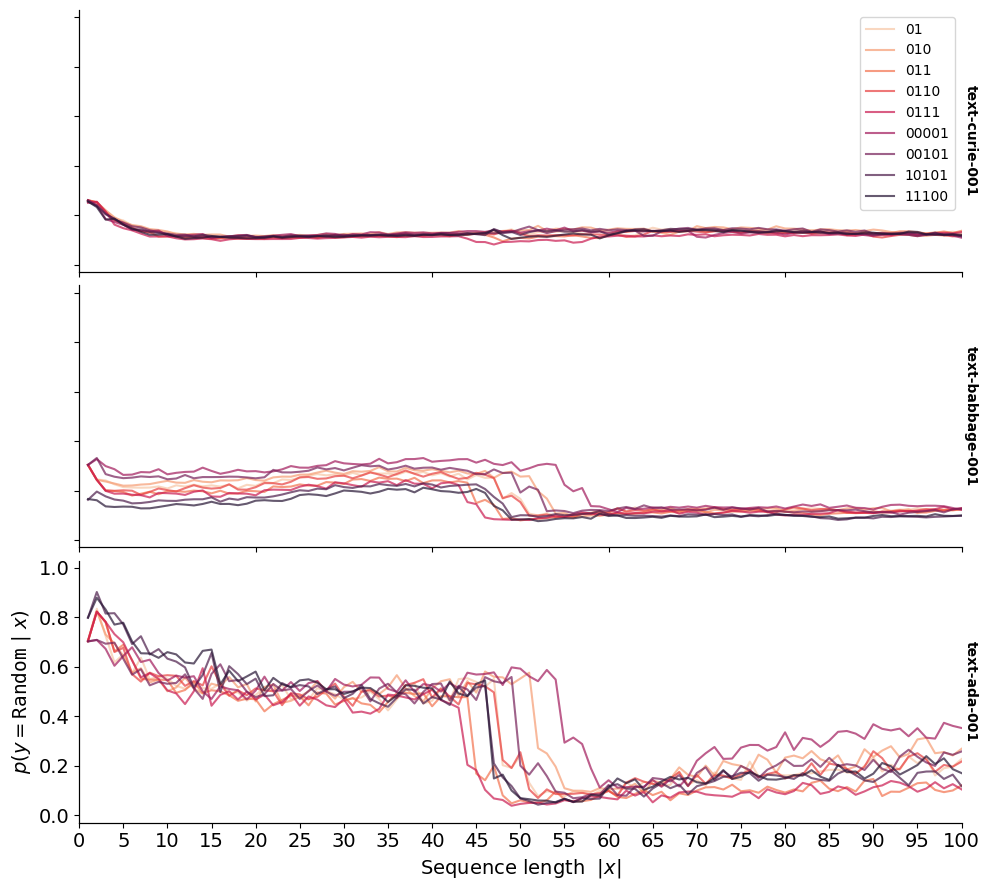

In [110]:
llm_groups = [
    [
        'gpt-3.5-turbo-instruct',
        'text-davinci-003', 
        'text-davinci-002', 
        'text-davinci-001',
    ], [
        'text-curie-001', 
        'text-babbage-001', 
        'text-ada-001'
    ]
]

for lg_i, lg in enumerate(llm_groups):
    plt.rcParams['figure.figsize'] = (10, 3 + len(lg) * 2)
    fig, axs = plt.subplots(len(lg), 1)
    for llm, ax in zip(lg, axs):
        res_juds = res_jud_all[llm]
        rows = []
        for concept, res_jud in res_juds.items():
            x = list(range(1, n_flips+1))
            y = [get_token_prob(r, ['n', 'r']) for r in res_jud]
            con_str = ''.join([str(i) for i in concept])
            rows += [{'len_x': x_, 'p_random': y_, 'concept': con_str} for x_, y_ in zip(x, y)]
            
        # sns.lineplot(data=pd.DataFrame(rows), x="len_x", y="p_random", ci=95)
        sns.lineplot(ax=ax, data=pd.DataFrame(rows), x="len_x", y="p_random", hue='concept', 
                     alpha=.7, palette=sns.color_palette('rocket_r', n_colors=len(res_juds)))   #, ci=95, estimator=np.median)

        ax.set_xlabel(None)
        twin = ax.twinx()
        twin.set_ylabel(llm, rotation=-90, labelpad=12, weight='bold')
        twin.set_yticks([])
        twin.tick_params(labelright='off')
        if ax != axs[0]:
            ax.get_legend().remove()
        else:
            ax.legend(loc='upper right')
        ax.set_ylim(-.03, 1.03)
        ax.set_xlim(0, 100)
            
    
    sns.despine(right=True, top=True)
    
    axs[0].set_xticklabels([])
    axs[1].set_xticklabels([])
    axs[-2].set_xticklabels([])
    axs[0].set_yticklabels([])
    axs[1].set_yticklabels([])
    axs[-2].set_yticklabels([])
    axs[0].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[1].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[2].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[-2].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[-1].set_yticks([0, .2, .4, .6, .8, 1.])
    axs[0].set_ylabel(None)
    axs[1].set_ylabel(None)
    axs[-2].set_ylabel(None)
    axs[-1].set_ylabel('Running Avg. of Generated Flips')
    axs[-1].set_xlabel('Output Index i for $y_i$')

    axs[-1].set_ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
    axs[-1].set_xlabel('Sequence length  $|x|$', fontsize=14)
    axs[-1].tick_params(axis='both', which='major', labelsize=14)
    
    plt.tight_layout()
    plt.subplots_adjust(hspace=.05)
    
        
    plt.xticks(list(range(0, n_flips+1, n_flips//20)))
    # plt.ylabel('p(random | X)')
    # plt.xlabel('sequence length |X|')
    
    # plt.savefig(f'imgs/fig_judge-lg{lg_i}.pdf')
    plt.show()

#### Random baseline

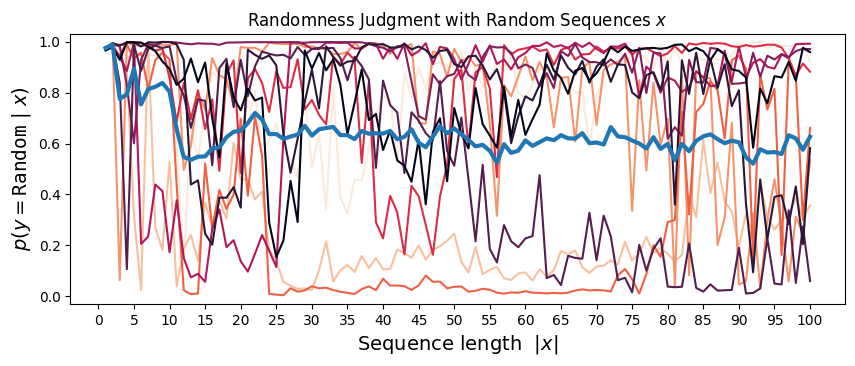

In [113]:
plt.rcParams['figure.figsize'] = (10, 3.5)

rows = []

for r_idx, res in enumerate(res_jud_rand):
    x = list(range(1, n_flips+1))
    y = [get_token_prob(r, ['n', 'r']) for r in res]
    rows += [{'len_x': x_, 'p_random': y_, 'r_idx': r_idx} for x_, y_ in zip(x, y)]

plot_df = pd.DataFrame(rows)

sns.lineplot(data=plot_df[plot_df['r_idx'] < 10], x="len_x", y="p_random", hue='r_idx', palette='rocket_r')
sns.lineplot(data=plot_df, x="len_x", y="p_random", lw=3, errorbar=None)

plt.xticks(list(range(0, n_flips+1, n_flips//20)))
plt.ylim(-.03, 1.03)
plt.yticks([0, .2, .4, .6, .8, 1.])
plt.gca().get_legend().remove()

plt.title('Randomness Judgment with Random Sequences $x$')
plt.ylabel('$p(y = \mathtt{Random} \ | \  x)$', fontsize=14)
plt.xlabel('Sequence length  $|x|$', fontsize=14)

# plt.savefig('imgs/fig_judge-rand.pdf')
plt.show()

# Part 3: extras not in paper / appendix

## compare GPT to various Markov chain and window average models

In [14]:
models_short = ['Ground Truth', 'llm', 'Bernoulli', 'MC-a', 'window-5', 'MC-10', 'HMM-20']

In [88]:
set(dff['model'])

{'Bernoulli',
 'Ground Truth',
 'MC-10',
 'MC-2',
 'MC-3',
 'MC-4',
 'MC-5',
 'MC-6',
 'MC-7',
 'MC-8',
 'MC-9',
 'MC-a',
 'llm',
 'window-10',
 'window-11',
 'window-12',
 'window-13',
 'window-14',
 'window-15',
 'window-16',
 'window-17',
 'window-18',
 'window-19',
 'window-2',
 'window-20',
 'window-3',
 'window-4',
 'window-5',
 'window-6',
 'window-7',
 'window-8',
 'window-9'}

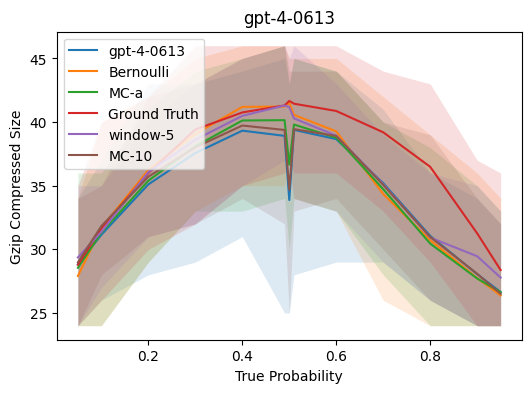

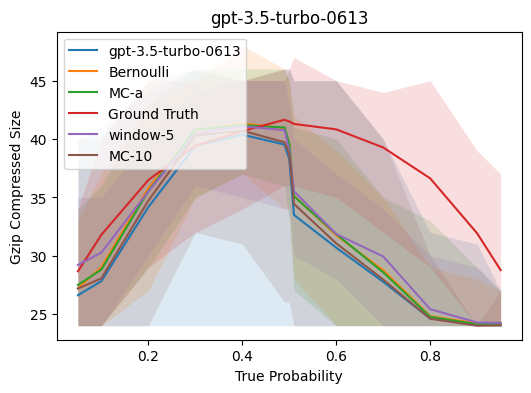

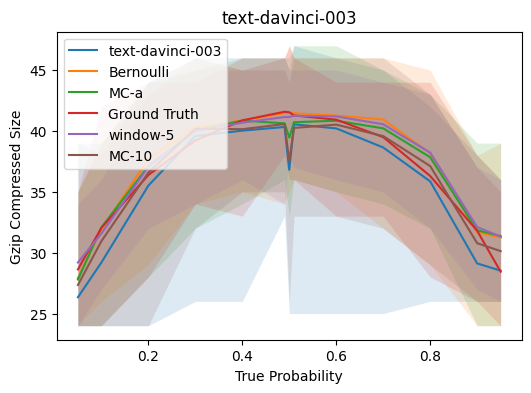

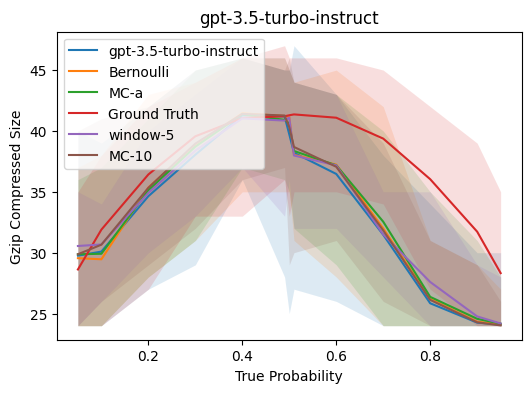

In [89]:
plt.rcParams['figure.figsize'] = (6, 4)


for llm in set(dff.llm):
    df__ = df_base[df_base.llm == llm].copy()
    df__ = df__[df__.model.isin(models_short)]
    df__.loc[df__['model'] == 'llm', 'model'] = llm    
    
    sns.lineplot(
        data=df__, x="goal_p", y="gzip", hue="model",
        errorbar=("pi", 100),   #errorbar=("sd", 1), 
        err_kws={'alpha': .15, 'lw': 0},
    )
    plt.title(llm)
    plt.xlabel('True Probability')
    plt.ylabel('Gzip Compressed Size');
    plt.legend(loc='upper left')
    plt.show()

# Note: MC-a is two-parameter Markov chain model with an alternation rate as in Falk & Konald (1997), as well as a p(Tails) bias.
#       MC-10 is a 10th order Markov chain. For both models, parameters are fit to LLM-generated flip data.

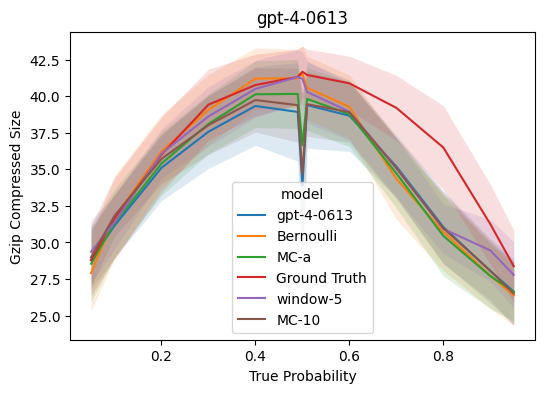

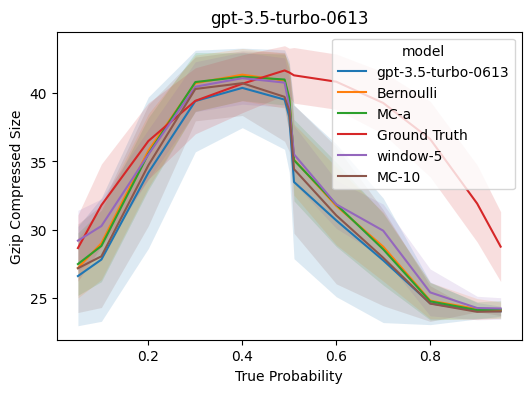

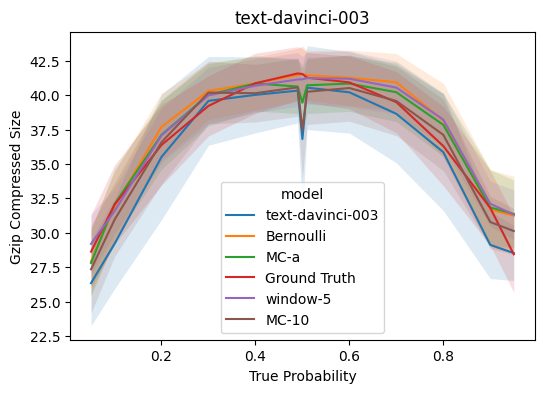

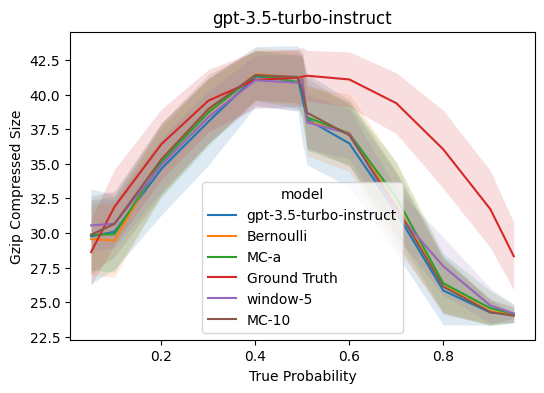

In [90]:
plt.rcParams['figure.figsize'] = (6, 4)


for llm in set(dff.llm):
    df__ = dff[dff.llm == llm].copy()
    df__ = df__[df__.model.isin(models_short)]
    df__.loc[df__['model'] == 'llm', 'model'] = llm    

    sns.lineplot(
        data=df__, x="goal_p", y="gzip", hue="model",
        errorbar=("sd", 1), err_kws={'alpha': .15, 'lw': 0},
    )
    plt.title(llm)
    plt.xlabel('True Probability')
    plt.ylabel('Gzip Compressed Size');
    plt.show()


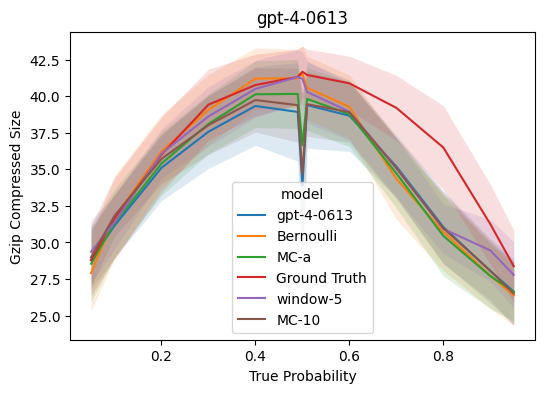

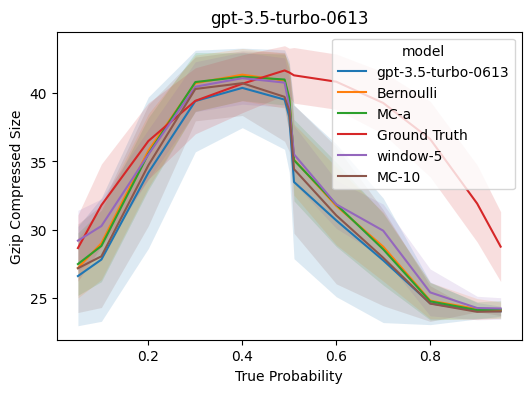

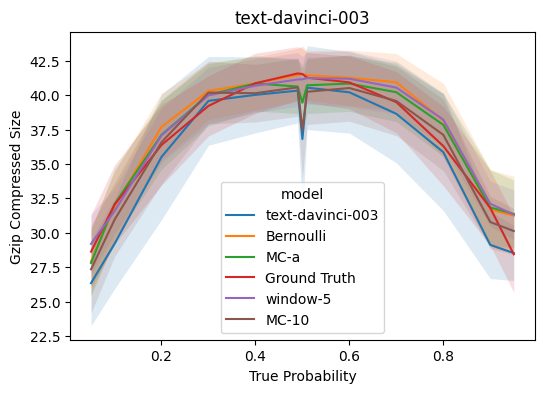

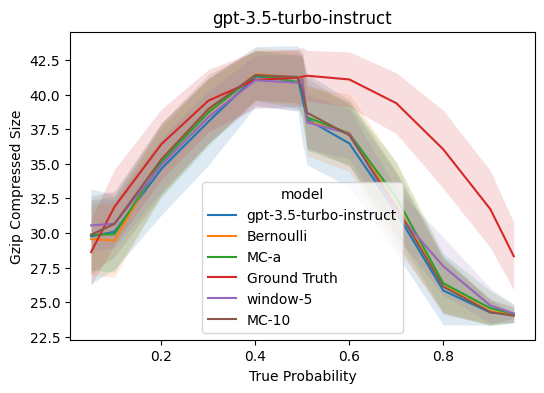

In [91]:
plt.rcParams['figure.figsize'] = (6, 4)


for llm in set(dff.llm):
    df__ = dff[dff.llm == llm].copy()
    df__ = df__[df__.model.isin(models_short)]
    df__.loc[df__['model'] == 'llm', 'model'] = llm    
    
    sns.lineplot(
        data=df__, x="goal_p", y="gzip", hue="model",
        errorbar=("sd", 1), err_kws={'alpha': .15, 'lw': 0},
    )
    plt.title(llm)
    plt.xlabel('True Probability')
    plt.ylabel('Gzip Compressed Size');
    plt.show()
# plt.legend(loc='lower left')
# plt.gca().get_legend().remove()
#### plt.savefig('imgs/fig_llms-gzip.pdf')
# xr = np.arange(0, 1, .01)
# plt.plot(xr, xr, ls='--', color='black', alpha=.7)

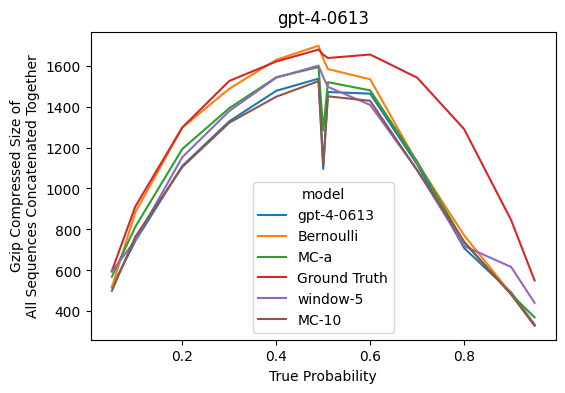

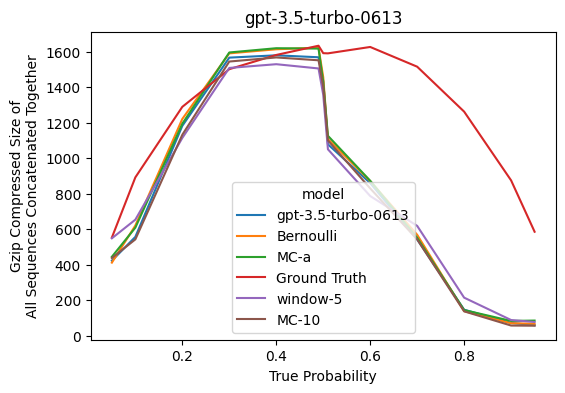

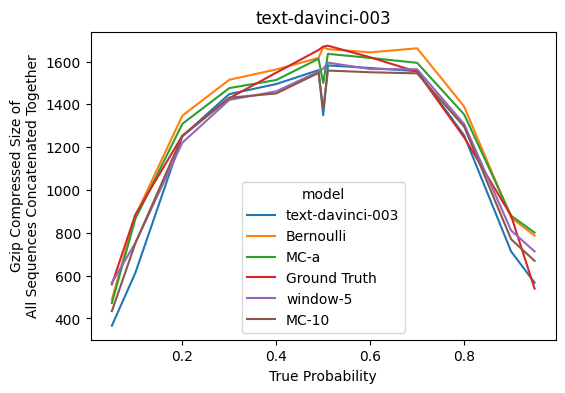

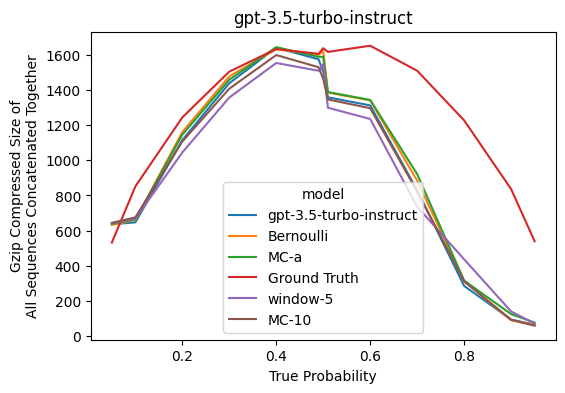

In [92]:
plt.rcParams['figure.figsize'] = (6, 4)

for llm in set(dff.llm):
    df__ = dff[dff.llm == llm].copy()
    df__ = df__[df__.model.isin(models_short)]
    df__.loc[df__['model'] == 'llm', 'model'] = llm    
    
    sns.lineplot(
        data=df__, x="goal_p", y="gzip_agg", hue="model",
        errorbar=("pi", 100), err_kws={'alpha': .15, 'lw': 0},
    )

    plt.title(llm)
    plt.xlabel('True Probability')
    plt.ylabel('Gzip Compressed Size of\nAll Sequences Concatenated Together');
    plt.show()

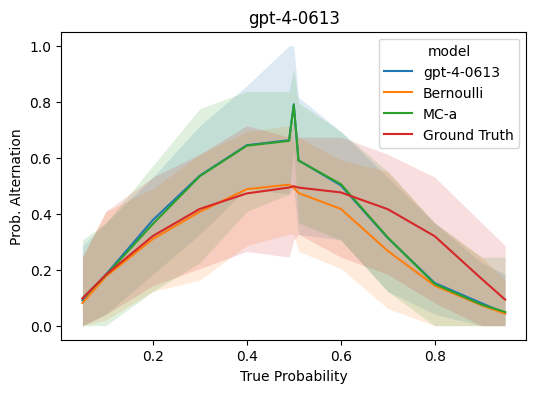

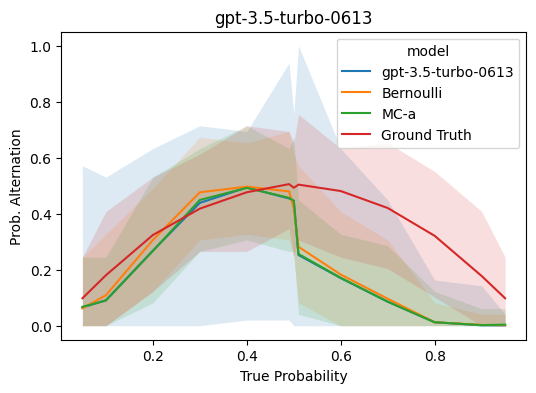

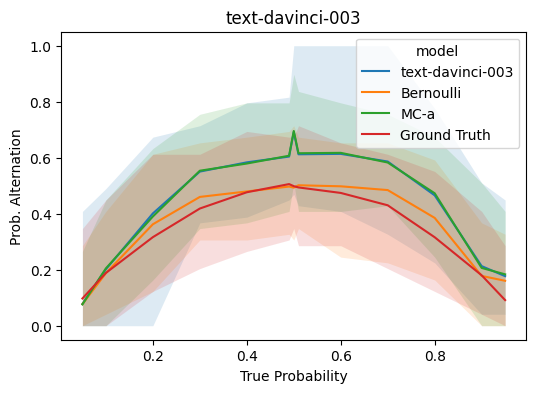

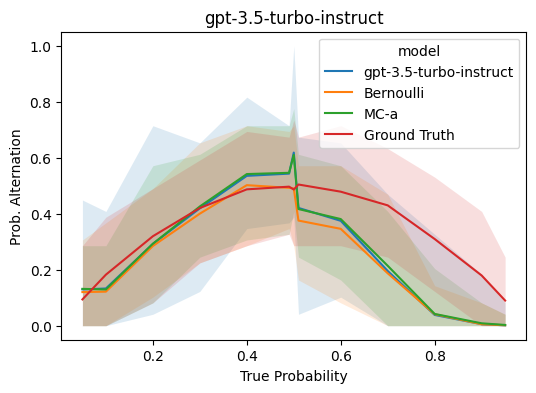

In [93]:
plt.rcParams['figure.figsize'] = (6, 4)

for llm in set(dff.llm):
    df__ = dff[dff.llm == llm].copy()
    df__ = df__[df__.model.isin(['llm', 'MC-a', 'Bernoulli', 'Ground Truth'])]
    df__.loc[df__['model'] == 'llm', 'model'] = llm    
    
    sns.lineplot(
        data=df__, x="goal_p", y="p_A", hue="model",
        errorbar=("pi", 100), err_kws={'alpha': .15, 'lw': 0},
    )

    plt.title(llm)
    plt.xlabel('True Probability')
    plt.ylabel('Prob. Alternation');
    # plt.savefig(f'imgs/fig_alt-{llm}.pdf')
    plt.show()

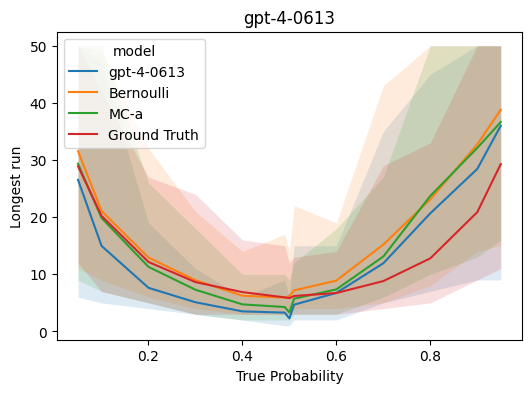

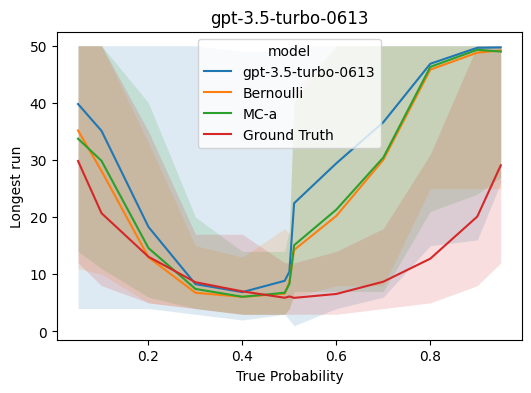

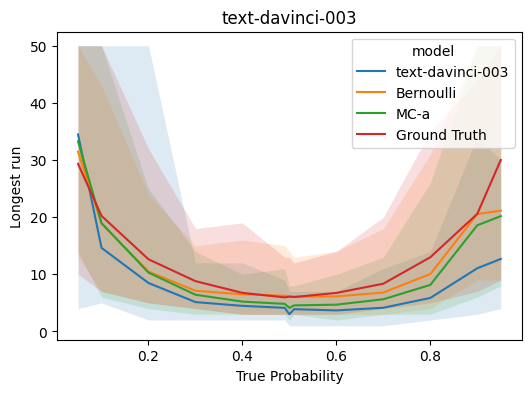

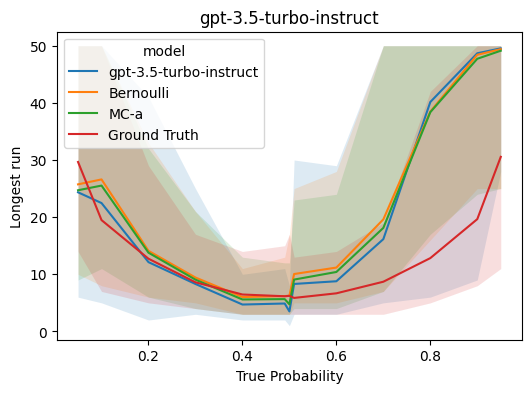

In [94]:
plt.rcParams['figure.figsize'] = (6, 4)


for llm in set(dff.llm):
    df__ = df_base[df_base.llm == llm].copy()
    df__ = df__[df__.model.isin(['llm', 'Bernoulli', 'MC-a', 'Ground Truth'])]   # 'window-10', 'MC-10', 'HMM-20'])]
    df__.loc[df__['model'] == 'llm', 'model'] = llm    
    
    sns.lineplot(
        data=df__, x="goal_p", y="long_run", hue="model",
        errorbar=("pi", 100), err_kws={'alpha': .15, 'lw': 0},
    )

    plt.title(llm)
    plt.xlabel('True Probability')
    plt.ylabel('Longest run');
    plt.show()

## comparing the min/max running avg values for each sequence with the goal p(Tails)

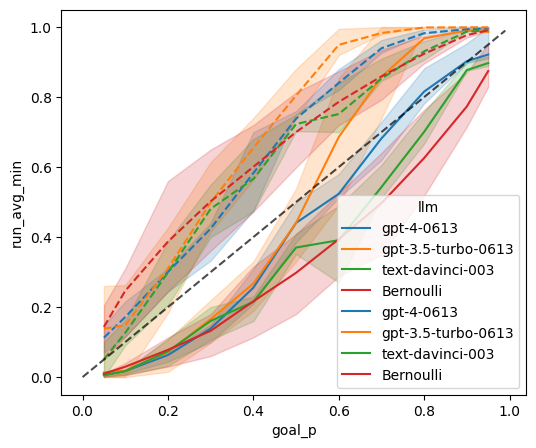

In [66]:
plt.rcParams['figure.figsize'] = (6, 5)

sns.lineplot(
    data=df_, x="goal_p", y="run_avg_min", hue="llm", errorbar=("pi", 50),  #  err_style="bars", 
)

sns.lineplot(
    data=df_, x="goal_p", y="run_avg_max", hue="llm", errorbar=("pi", 50),  #  err_style="bars", 
    ls='--'
)
xr = np.arange(0, 1, .01)
plt.plot(xr, xr, ls='--', color='black', alpha=.7)

<AxesSubplot:xlabel='goal_p', ylabel='run_avg_std'>

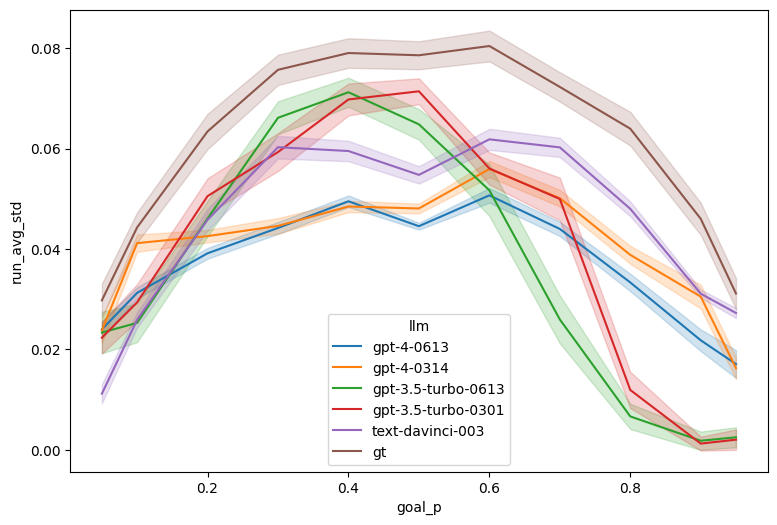

In [145]:
plt.rcParams['figure.figsize'] = (9, 6)

df__ = df_[df_['llm'].isin(['gpt-3.5-turbo-0301', 'gpt-3.5-turbo-0613', 
                            'gpt-4-0314', 'gpt-4-0613',
                            'gt', 'text-davinci-003'])]
sns.lineplot(
    data=df__, x="goal_p", y="run_avg_std", hue="llm", errorbar=("se", 2),  #  err_style="bars", 
)

<AxesSubplot:xlabel='goal_p', ylabel='gzip_agg'>

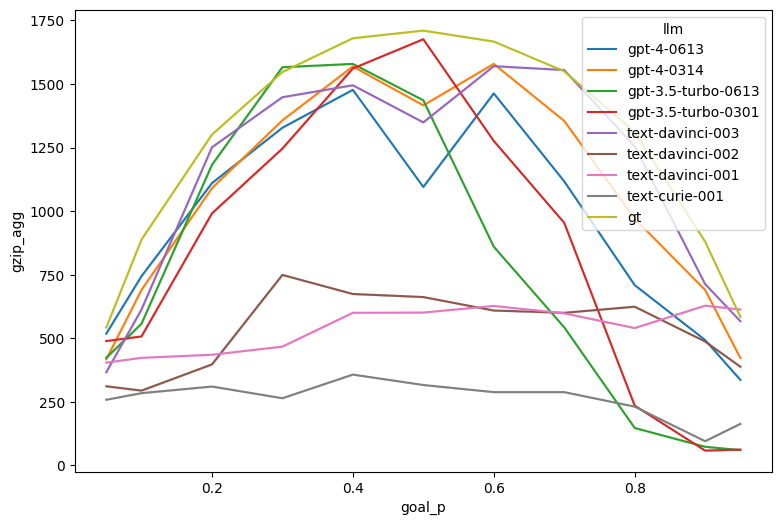

In [149]:
plt.rcParams['figure.figsize'] = (9, 6)
sns.lineplot(
    data=df_, x="goal_p", y="gzip_agg", hue="llm", errorbar=("se", 2))

### extra FL learning plot

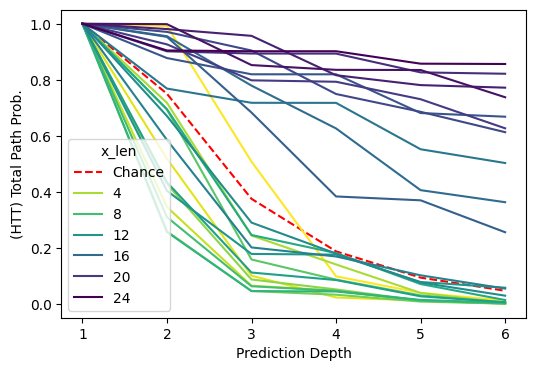

In [24]:
plt.rcParams['figure.figsize'] = (6, 4)

depths = [1,2,3,4,5,6]

df = pd.DataFrame([
    {'x_len': n, 'depth': d, 'prob': get_paths_p(res_gen_trees_htt[n], (0, 1, 1), depth=d)} 
    for n in res_gen_trees_htt.keys() if n < 25
    for d in depths
])

baseline_probs = [len(set(get_rotations((0, 1, 0), d))) / (2 ** d) for d in depths]
plt.plot(depths, baseline_probs, label='Chance', ls='--', color='red')


sns.lineplot(data=df, x='depth', y='prob', hue='x_len', 
             palette=sns.color_palette("viridis_r", as_cmap=True))
plt.xlabel('Prediction Depth')
plt.ylabel('(HTT) Total Path Prob.');
plt.savefig('imgs/fig_pathacc-depth-HTT25.pdf')

## density plots on running average data

In [43]:
rows = []
for row in llm_sub_res:
    vals = [i for subl in row['run_avg'] for i in subl]
    for val in vals:
        r = {
            'llm': row['llm'],
            'model': row['model'],
            'goal_p': row['goal_p'],
            'val': val,
        }
        rows.append(r)
        
df_ra = pd.DataFrame(rows)

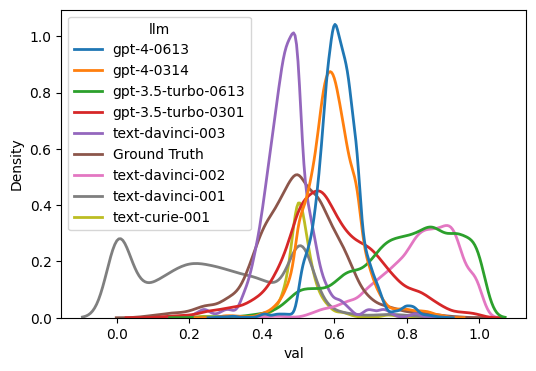

In [74]:
seq_len = 50
df__ = df_ra[ (df_ra['model'] == 'llm') | ((df_ra['model'] == 'Ground Truth')   & 
                                           (df_ra['llm'] == 'text-davinci-003'))]
df__.loc[(df__['model'] == 'Ground Truth'), 'llm'] = 'Ground Truth'

# for goal_p in [.1, .51, .9]:
df__ = df__[df__['goal_p'] == .51]
ax = sns.kdeplot(data=df__, x='val', hue='llm', lw=2)

In [76]:
row['window_avg'].keys()

dict_keys([5, 10, 15, 20, 25])

In [97]:
rows = []
for row in llm_sub_res:
    vals = [i for subl in row['window_avg'][10] for i in subl]
    for val in vals:
        r = {
            'llm': row['llm'],
            'model': row['model'],
            'goal_p': row['goal_p'],
            'val': val,
        }
        rows.append(r)
        
df_ra = pd.DataFrame(rows)

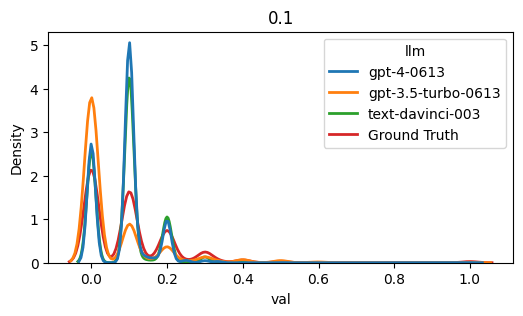

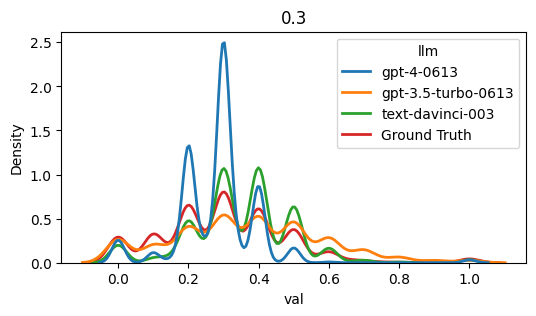

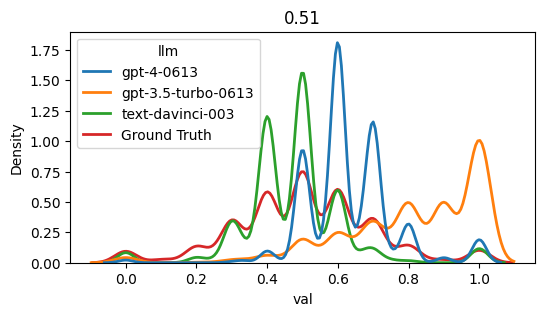

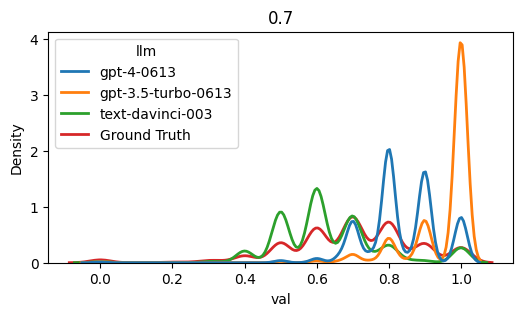

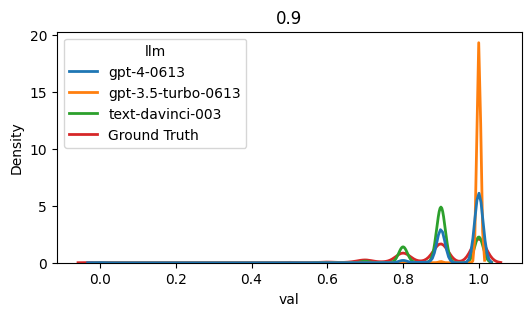

In [98]:
plt.rcParams['figure.figsize'] = (6, 3)

seq_len = 50
df__ = df_ra[ (df_ra['model'] == 'llm') | ((df_ra['model'] == 'Ground Truth')   & 
                                           (df_ra['llm'] == 'text-davinci-003'))]
df__ = df__[df__.llm.isin(llms_short)]
df__.loc[(df__['model'] == 'Ground Truth'), 'llm'] = 'Ground Truth'

for goal_p in [.1, .3, .51, .7, .9]:
    df___ = df__[df__['goal_p'] == goal_p]
    ax = sns.kdeplot(data=df___, x='val', hue='llm', lw=2)
    plt.title(goal_p)
    plt.show()

In [59]:
dff.columns

Index(['Unnamed: 0', 'llm', 'model', 'goal_p', 'gzip', 'mean', 'p_A',
       'long_run', 'run_avg_std', 'run_avg_max', 'run_avg_min', 'flips',
       'gzip_agg'],
      dtype='object')

(0.0, 1.0)

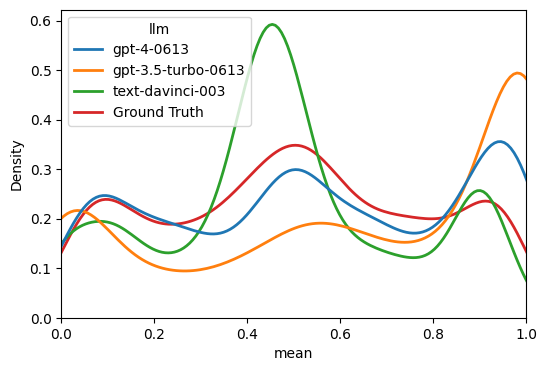

In [73]:
plt.rcParams['figure.figsize'] = (6, 4)

seq_len = 50
df__ = dff[ (dff['model'] == 'llm') | ((dff['model'] == 'Ground Truth')   & 
                                           (dff['llm'] == 'text-davinci-003'))]
df__[df__.llm.isin(llms_short)]
df__.loc[(df__['model'] == 'Ground Truth'), 'llm'] = 'Ground Truth'

ax = sns.kdeplot(data=df__, x='mean', hue='llm', lw=2)
plt.xlim(0, 1)

(0.0, 6.0)

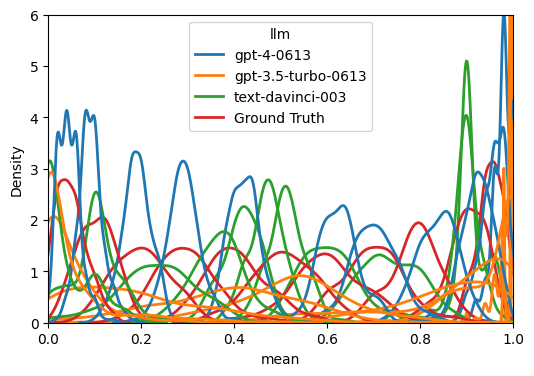

In [72]:
plt.rcParams['figure.figsize'] = (6, 4)

seq_len = 50
df__ = dff[ (dff['model'] == 'llm') | ((dff['model'] == 'Ground Truth')   & 
                                           (dff['llm'] == 'text-davinci-003'))]
df__.loc[(df__['model'] == 'Ground Truth'), 'llm'] = 'Ground Truth'
# df__ = dff[dff['model'] == 'llm']
df__[df__.llm.isin(llms_short)]

p_heads_ls = [5, 10, 20, 30, 40, 49, 60, 70, 80, 90, 95]
for p_heads in p_heads_ls:
    goal_p = round((100 - p_heads) / 100, 3)
    ax = sns.kdeplot(data=df__[df__.goal_p == goal_p], x='mean', hue='llm', lw=2)
    
plt.xlim(0, 1)
plt.ylim(0, 6)

([0, 1, 2, 3, 4, 5, 6, 7, 8],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

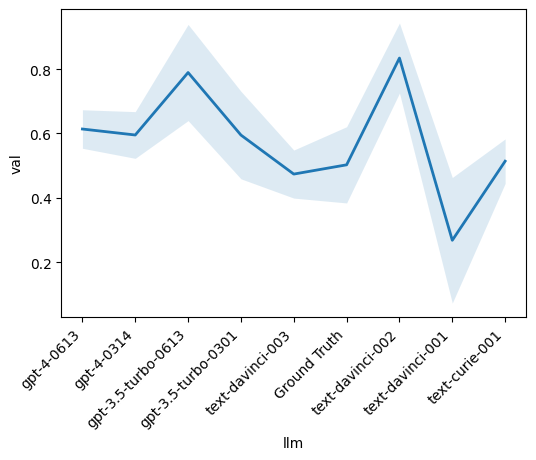

In [66]:
seq_len = 50
df__ = df_ra[ (df_ra['model'] == 'llm') | ((df_ra['model'] == 'Ground Truth')   & 
                                           (df_ra['llm'] == 'text-davinci-003'))]
df__.loc[(df__['model'] == 'Ground Truth'), 'llm'] = 'Ground Truth'

# for goal_p in [.1, .51, .9]:
df__ = df__[df__['goal_p'] == .51]
ax = sns.lineplot(data=df__, x='llm', y='val', lw=2,
                errorbar=("sd", 1), err_kws={'alpha': .15, 'lw': 0},)

plt.xticks(rotation=45, ha='right')

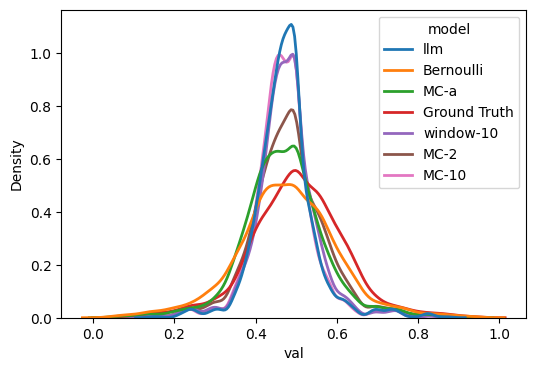

In [122]:
seq_len = 50
llm = 'text-davinci-003'

df__ = df_ra[(df_ra['llm'] == llm)]
# df__.loc[(df__['model'] == 'Ground Truth'), 'llm'] = 'Ground Truth'

# for goal_p in [.1, .51, .9]:
df__ = df__[df__['goal_p'] == .51]
ax = sns.kdeplot(data=df__, x='val', hue='model', lw=2)

## Query OpenAI API

Notebook examples to show how data was collected for randomness judgment. See `collect_data.py` for randomness generation varying p(Tails) and formal concept learning.

note: `text-davinci-003` is no longer available through the openai API

In [ ]:
# https://github.com/ebigelow/batch-prompt
import batch_prompt

### Randomness Judgment

### querying judgments for many concepts

In [53]:
### 1c: generate exhaustive n-depth tree of flip probabilities

res_jud_all = defaultdict(lambda: defaultdict(dict))
concepts = [
    # (0, 1),
    # (0, 1, 0),
    # (0, 1, 1),
    # (0, 1, 1, 0),
    # (0, 1, 1, 1),
    # (0, 0, 0, 0, 1),
    # (0, 0, 1, 0, 1),
    # (1, 0, 1, 0, 1),
    # (1, 1, 1, 0, 0),

    (1, 1, 1, 0, 0, 0),
    (0, 0, 1, 1, 1, 1),
    (1, 1, 1, 0, 0, 0, 0),
    (1, 0, 1, 0, 1, 1, 0),
    (1, 1, 1, 1, 0, 0, 0, 0),
    (1, 1, 0, 0, 0, 1, 1, 0),
    (1, 1, 1, 0, 0, 0, 0, 1, 0),
    (1, 0, 0, 0, 1, 0, 0, 1, 1),
    (0, 0, 0, 0, 0, 1, 1, 1, 1, 1),
    (0, 0, 1, 0, 0, 1, 1, 0, 1, 1),
    (1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1),
    (1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1),
    (1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0),
    (1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0),
]

llms = [
    #'gpt-3.5-turbo-instruct',
    'text-davinci-003', 
    #'text-davinci-002', 
    #'text-davinci-001', 
    #'text-curie-001', 
    #'text-babbage-001', 
    #'text-ada-001'
]

flip_strs = ['Heads', 'Tails']
n_flips = 100

for llm in tqdm(llms):
    for concept in tqdm(concepts):
        concept_str = [flip_strs[i] for i in concept]
        ### context = gen_alt_flips(x_len, concept_str)
        res_jud = batch_prompt.completions(p_judge, [{'flips': gen_alt_flips(x_len, concept_str)[:-1]} 
                             for x_len in range(1, n_flips+1)], 
                            {'max_tokens': 1, 'logprobs': 3, 'engine': llm},
                       verbose=1)
        res_jud_all[llm][concept] = res_jud

pickle.dump(dict({k: dict(v) for k,v in res_jud_all.items()}), 
            open('./data/openai/jud_dv3.pk', 'wb'))

  0%|                                                                                                                                                                                        | 0/20 [00:00<?, ?it/s]

Calling OpenAI . . .



  5%|████████▊                                                                                                                                                                       | 1/20 [00:00<00:15,  1.26it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.79s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16049, 'total_tokens': 16149}
Calling OpenAI . . .



 10%|█████████████████▌                                                                                                                                                              | 2/20 [00:01<00:14,  1.23it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.82s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 15400, 'total_tokens': 15500}
Calling OpenAI . . .



 15%|██████████████████████████▍                                                                                                                                                     | 3/20 [00:02<00:15,  1.12it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.99s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16637, 'total_tokens': 16737}
Calling OpenAI . . .



 20%|███████████████████████████████████▏                                                                                                                                            | 4/20 [00:03<00:13,  1.17it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.79s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17924, 'total_tokens': 18024}
Calling OpenAI . . .



 25%|████████████████████████████████████████████                                                                                                                                    | 5/20 [00:04<00:12,  1.24it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.71s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16650, 'total_tokens': 16750}
Calling OpenAI . . .



 30%|████████████████████████████████████████████████████▊                                                                                                                           | 6/20 [00:04<00:10,  1.29it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.71s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17261, 'total_tokens': 17361}
Calling OpenAI . . .



 35%|█████████████████████████████████████████████████████████████▌                                                                                                                  | 7/20 [00:05<00:11,  1.17it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 1.02s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17311, 'total_tokens': 17411}
Calling OpenAI . . .



 40%|██████████████████████████████████████████████████████████████████████▍                                                                                                         | 8/20 [00:06<00:10,  1.19it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.79s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16037, 'total_tokens': 16137}
Calling OpenAI . . .



 45%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                | 9/20 [00:07<00:09,  1.21it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.80s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16674, 'total_tokens': 16774}
Calling OpenAI . . .



 50%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 10/20 [00:08<00:07,  1.31it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.61s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16025, 'total_tokens': 16125}
Calling OpenAI . . .



 55%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 11/20 [00:08<00:07,  1.27it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.83s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 15412, 'total_tokens': 15512}
Calling OpenAI . . .



 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 12/20 [00:09<00:06,  1.22it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.90s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17911, 'total_tokens': 18011}
Calling OpenAI . . .



 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 13/20 [00:10<00:05,  1.33it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.59s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16624, 'total_tokens': 16724}
Calling OpenAI . . .



 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 14/20 [00:11<00:04,  1.34it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.72s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17300, 'total_tokens': 17400}
Calling OpenAI . . .



 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 15/20 [00:12<00:04,  1.24it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.94s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16024, 'total_tokens': 16124}
Calling OpenAI . . .



 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 16/20 [00:12<00:03,  1.24it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.80s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17937, 'total_tokens': 18037}
Calling OpenAI . . .



 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 17/20 [00:13<00:02,  1.25it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.79s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17312, 'total_tokens': 17412}
Calling OpenAI . . .



 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 18/20 [00:14<00:01,  1.29it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.70s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16000, 'total_tokens': 16100}
Calling OpenAI . . .



 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 19/20 [00:15<00:00,  1.30it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.75s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16012, 'total_tokens': 16112}
Calling OpenAI . . .



100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:16<00:00, 16.09s/it]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.92s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 14788, 'total_tokens': 14888}


#### random sequences $x$ baseline

In [ ]:
n_copies = 1
n_seqs = 20
n_flips = 100

rand_res_juds = []
for _ in trange(n_seqs):
    rand_x = np.random.rand(n_flips) > .5
    rand_x = [['Heads', 'Tails'][xi] for xi in rand_x]
    
    r = batch_prompt.completions(p_judge, [{'flips': ', '.join(rand_x[:n]) + ','} 
                                            for n in range(1, n_flips+1)], 
                                    {'max_tokens': 1, 'logprobs': 3, 'engine': 'text-davinci-003'}, verbose=2)
    rand_res_juds.append(r)

pickle.dump(rand_res_juds, open('./data/openai/jud_dv3-rand.pk', 'wb'))

  0%|                                                                                                                                                                                        | 0/20 [00:00<?, ?it/s]/var/folders/41/_ql36yd95wq0zy1_ml3g0g2w0000gn/T/ipykernel_1123/1489959059.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  rand_x = [['Heads', 'Tails'][xi] for xi in rand_x]


Calling OpenAI . . .


  5%|████████▊                                                                                                                                                                       | 1/20 [00:01<00:22,  1.16s/it]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 1.16s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16700, 'total_tokens': 16800}
Calling OpenAI . . .


 10%|█████████████████▌                                                                                                                                                              | 2/20 [00:02<00:18,  1.00s/it]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.89s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16444, 'total_tokens': 16544}
Calling OpenAI . . .


 15%|██████████████████████████▍                                                                                                                                                     | 3/20 [00:02<00:14,  1.17it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.68s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16331, 'total_tokens': 16431}
Calling OpenAI . . .


 20%|███████████████████████████████████▏                                                                                                                                            | 4/20 [00:03<00:14,  1.11it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.98s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16015, 'total_tokens': 16115}
Calling OpenAI . . .


 25%|████████████████████████████████████████████                                                                                                                                    | 5/20 [00:04<00:14,  1.03it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 1.10s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17282, 'total_tokens': 17382}
Calling OpenAI . . .


 30%|████████████████████████████████████████████████████▊                                                                                                                           | 6/20 [00:05<00:13,  1.06it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.87s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16863, 'total_tokens': 16963}
Calling OpenAI . . .


 35%|█████████████████████████████████████████████████████████████▌                                                                                                                  | 7/20 [00:06<00:11,  1.16it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.69s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16796, 'total_tokens': 16896}
Calling OpenAI . . .


 40%|██████████████████████████████████████████████████████████████████████▍                                                                                                         | 8/20 [00:07<00:10,  1.20it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.78s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16488, 'total_tokens': 16588}
Calling OpenAI . . .


 45%|███████████████████████████████████████████████████████████████████████████████▏                                                                                                | 9/20 [00:07<00:09,  1.22it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.79s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16535, 'total_tokens': 16635}
Calling OpenAI . . .


 50%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                                       | 10/20 [00:08<00:08,  1.24it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.78s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17256, 'total_tokens': 17356}
Calling OpenAI . . .


 55%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                              | 11/20 [00:09<00:08,  1.12it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 1.07s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16746, 'total_tokens': 16846}
Calling OpenAI . . .


 60%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                      | 12/20 [00:10<00:06,  1.21it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.69s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16871, 'total_tokens': 16971}
Calling OpenAI . . .


 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 13/20 [00:11<00:05,  1.18it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.89s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16430, 'total_tokens': 16530}
Calling OpenAI . . .


 70%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 14/20 [00:12<00:04,  1.24it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.72s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16855, 'total_tokens': 16955}
Calling OpenAI . . .


 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 15/20 [00:12<00:04,  1.23it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.82s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17112, 'total_tokens': 17212}
Calling OpenAI . . .


 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 16/20 [00:13<00:03,  1.24it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.80s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16504, 'total_tokens': 16604}
Calling OpenAI . . .


 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 17/20 [00:14<00:02,  1.19it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.91s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16643, 'total_tokens': 16743}
Calling OpenAI . . .


 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 18/20 [00:15<00:01,  1.20it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.81s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16906, 'total_tokens': 17006}
Calling OpenAI . . .


 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 19/20 [00:16<00:00,  1.12it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 1.05s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 17139, 'total_tokens': 17239}
Calling OpenAI . . .


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:17<00:00,  1.14it/s]

~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 1.01s
Number of results: 100
{'completion_tokens': 100, 'prompt_tokens': 16187, 'total_tokens': 16287}


#### simple judgment example

In [24]:
n_flips = 100

# Note: openAI API actually is stochastic in logprobs (https://community.openai.com/t/174412/3), so if you
#       get multiple copies of logprobs you notice slight differences. Learning curves mostly seem similar,
#       but logprobs confidence interval gets wider around the transition point in |x|.
n_copies = 1

res_jud_hth = batch_prompt.completions(
    [p_judge] * n_copies, [{'flips': gen_alt_flips(n, ['Heads', 'Tails', 'Heads'])[:-1]} 
     for n in range(1, n_flips+1)], 
    {'max_tokens': 1, 'logprobs': 3, 'engine': 'text-davinci-003'}, verbose=1)

Calling OpenAI . . .
~~~~~~~~~~~~~~~ Done ~~~~~~~~~~~~~~~
Time: 0.87s
Number of results: 50
{'completion_tokens': 50, 'prompt_tokens': 5025, 'total_tokens': 5075}


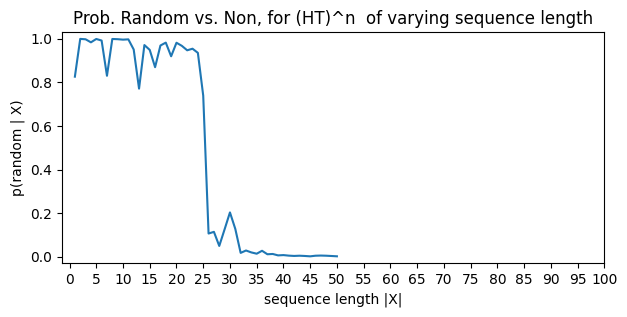

In [35]:
plt.rcParams['figure.figsize'] = (7, 3)

rj = res_jud_hth

rows = []
for c in range(n_copies):
    x = list(range(1, n_flips+1))
    res_ = rj[c*n_flips : (c+1)*n_flips]
    y = [get_token_prob(r, ['n', 'r']) for r in res_]
    rows += [{'len_x': x_, 'p_random': y_, 'copy': c} for x_, y_ in zip(x, y)]
    

sns.lineplot(data=pd.DataFrame(rows), x="len_x", y="p_random", errorbar=('ci', 95), estimator=np.median)
plt.xticks(list(range(0, n_flips+1, n_flips//20)))
plt.ylabel('p(random | X)')
plt.xlabel('sequence length |X|')
plt.ylim(-.03, 1.03)
plt.yticks([0, .2, .4, .6, .8, 1.])
plt.title('Prob. Random vs. Non, for (HT)^n  of varying sequence length')

# plt.savefig('imgs/fig_judge-HT.pdf')
plt.show()